# Image Segmentation with Fast.ai v2 and SemTorch

In [1]:
env = dict()
env['use_dataparallel'] = True

import os
if env['use_dataparallel']:
    os.environ['CUDA_VISIBLE_DEVICES'] = '0,1'
    os.environ['OPENBLAS_NUM_THREADS'] = '1'
else:
    os.environ['CUDA_VISIBLE_DEVICES'] = '1'
    os.environ['OPENBLAS_NUM_THREADS'] = '1'

In [2]:
!nvidia-smi

Fri Jul 30 14:17:05 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   41C    P0    28W / 250W |      0MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

# Import-initialization


%matplotlib inline

or

%matplotlib notebook

In [3]:
!pip install semtorch
!pip install --upgrade albumentations
!pip install fastai==2.3.0
!pip show fastai

from fastai.basics import *
from fastai.vision import models
from fastai.vision.all import *
from fastai.metrics import *
from fastai.data.all import *
from fastai.callback import *

# SemTorch
from semtorch import get_segmentation_learner

from pathlib import Path
import random
import numpy as np

# Display larger jupyter cells!
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

if env['use_dataparallel']:
    from fastai.distributed import *
    cuda_training_device = 0           # otherwise: RuntimeError: module must have its parameters and buffers on device cuda:0 (device_ids[0]) but found one of them on device: cuda:1
else:
    pass
    #cuda_training_device = 1           # the device of your choice

You should consider upgrading via the '/local/ranieri/venvs/ml-local-node-10/bin/python3.6 -m pip install --upgrade pip' command.
You should consider upgrading via the '/local/ranieri/venvs/ml-local-node-10/bin/python3.6 -m pip install --upgrade pip' command.


You should consider upgrading via the '/local/ranieri/venvs/ml-local-node-10/bin/python3.6 -m pip install --upgrade pip' command.
Name: fastai
Version: 2.3.0
Summary: fastai simplifies training fast and accurate neural nets using modern best practices
Home-page: https://github.com/fastai/fastai/tree/master/
Author: Jeremy Howard, Sylvain Gugger, and contributors
Author-email: info@fast.ai
License: Apache Software License 2.0
Location: /local/ranieri/venvs/ml-local-node-10/lib/python3.6/site-packages
Requires: pillow, pyyaml, scikit-learn, scipy, torchvision, spacy, pip, torch, fastprogress, requests, pandas, matplotlib, fastcore, packaging
Required-by: SemTorch


/local/ranieri/venvs/ml-local-node-10/lib64/python3.6/site-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='mean' instead.
  warnings.warn(warning.format(ret))


# Determinism


In [4]:
from datetime import datetime

env['seed'] = 2021
env['launch_time'] = datetime.now().strftime('%Y-%m-%d_%H.%M.%S')

random.seed(env['seed'])
set_seed(env['seed'])
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Secondary Functions


Get filenames both for images and masks

In [5]:
#export
def get_y_fn(img_fn):
    if 'mask' in str(img_fn):
        print(f'Warning! {img_fn} looks like a mask!')
    return Path(str(img_fn).replace("images", "masks").replace('.jpg', '.png'))

#export
def get_x_fns(path, folders, debug=False):
    new_fns = []
    for dset_dir in folders:
        fns = get_image_files(path / dset_dir)
        for fn in fns:
            if not 'mask' in str(fn):
                new_fns.append(fn)
    if debug:
        fn_name = inspect.currentframe().f_code.co_name
        print(f'{fn_name} - {len(new_fns)} - {new_fns}')
    return new_fns

Aux Functions



In [6]:
# dataset/train, dataset/valid
def ValidParentSplitter(x):
    return Path(x).parent.name == str(env['validation_dir'])

# dataset/train/images, dataset/train/masks, dataset/valid/images, dataset/valid/masks
def ValidGrandParentSplitter(x):
    return Path(x).parent.parent.name == env['validation_dir'].name

# dataset/subdataset/train/images, dataset/subdataset/train/masks, dataset/subdataset/valid/images, dataset/subdataset/valid/masks
def ValidGrandGrandParentSplitter(x):
    return Path(x).parent.parent.parent.name == env['validation_dir'].name

Loading the codes of the different classes. All the datasets have the same codes.

In [7]:
import torchvision

codes = ['NoPatt','circlets','fringe','long_incisions','eyebrows','oblique_fringe','spirals','Background']

name2id = {v:k for k,v in enumerate(codes)}
print(name2id)
void_code   = name2id['Background']
nopatt_code = name2id['NoPatt']

#export
def surfpatt_metric(input, target):
    target      = target.squeeze(1)
    void_mask   = target != void_code
    nopatt_mask = target != nopatt_code
    mask        = torch.logical_and(void_mask, nopatt_mask)
    return (input.argmax(dim=1)[mask]==target[mask]).float().mean()

{'NoPatt': 0, 'circlets': 1, 'fringe': 2, 'long_incisions': 3, 'eyebrows': 4, 'oblique_fringe': 5, 'spirals': 6, 'Background': 7}


Early Stopping parameters

In [8]:
env['monitor_training']   = "valid_loss"
env['comp_training']      = np.less

env['monitor_evaluating'] = "dice"
env['comp_evaluating']    = np.greater

env['patience']           = 10

Augmentations 

In [9]:
import cv2

cv2.setNumThreads(0)
cv2.ocl.setUseOpenCL(False)

from albumentations import (
    Compose,
    HorizontalFlip,
    OneOf,
    ElasticTransform,
    GridDistortion, 
    OpticalDistortion,
    Flip,
    Rotate,
    Transpose,
    CLAHE,
    ShiftScaleRotate,
    RandomRotate90,
    HueSaturationValue,
    Emboss,
    Sharpen,
    PiecewiseAffine,
    #IAAEmboss,
    #IAASharpen,
    #IAAPiecewiseAffine,
    #IAAAdditiveGaussianNoise,
    GaussNoise,
    Blur,
    MotionBlur,
    MedianBlur,
    RandomContrast,
    RandomBrightness,
)

In [10]:
class SegmentationAlbumentationsTransform(ItemTransform):
    split_idx = 0
    def __init__(self, aug): 
        self.aug = aug
    def encodes(self, x):
        img,mask = x
        aug = self.aug(image=np.array(img), mask=np.array(mask))
        return PILImage.create(aug["image"]), PILMask.create(aug["mask"])

def strong_aug(p=1):
    return Compose([
        RandomRotate90(),
        Flip(),
        Transpose(),
        OneOf([
            #IAAAdditiveGaussianNoise(),
            GaussNoise(),
        ], p=0.2),
        OneOf([
            MotionBlur(p=.2),
            MedianBlur(blur_limit=3, p=.1),
            Blur(blur_limit=3, p=.1),
        ], p=0.2),
        ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=45, p=.2),
        OneOf([
            OpticalDistortion(p=0.3),
            GridDistortion(p=.1),
            PiecewiseAffine(p=0.3),
            #IAAPiecewiseAffine(p=0.3),
        ], p=0.2),
        OneOf([
            CLAHE(clip_limit=2),
            Sharpen(),
            #IAASharpen(),
            #IAAEmboss(),
            Emboss(),
            RandomContrast(),
            RandomBrightness(),
        ], p=0.3),
        #HueSaturationValue(p=0.3),
    ], p=p)
    
basicTransformPipeline=Compose([
                        HorizontalFlip    (p=0.25),
                        RandomRotate90    (p=0.25),
                        Transpose         (p=0.25),
                        ShiftScaleRotate  (p=0.25, shift_limit=0.0625, scale_limit=0.50, rotate_limit=45),
                        Blur              (p=0.1,  blur_limit=3),
                        ElasticTransform  (p=0.1,  alpha=120, sigma=120 * 0.05, alpha_affine=120 * 0.03),
                        GridDistortion    (p=0.1,  num_steps=1, distort_limit=0.05),
                        OpticalDistortion (p=0.1,  distort_limit=0.05, shift_limit=0.01),
                        HueSaturationValue(p=0.1),
                        CLAHE             (p=0.1),
                    ],p=1)

basicTransformPipeline  = SegmentationAlbumentationsTransform(basicTransformPipeline)

strongTransformPipeline = strong_aug(p=1)
strongTransformPipeline = SegmentationAlbumentationsTransform(strongTransformPipeline)

/local/ranieri/venvs/ml-local-node-10/lib64/python3.6/site-packages/albumentations/augmentations/transforms.py:1772: FutureWarning: This class has been deprecated. Please use RandomBrightnessContrast
  FutureWarning,
/local/ranieri/venvs/ml-local-node-10/lib64/python3.6/site-packages/albumentations/augmentations/transforms.py:1746: FutureWarning: This class has been deprecated. Please use RandomBrightnessContrast
  FutureWarning,


# Get and setup dataset


In [11]:
basepath       = '/home/ranieri/dataset/surface-pattern-recognition/segmentation'
dataset_suffix = 'v3alpha-RGB+SI'
#newbasepath   = '/local/ranieri/dataset/surface-pattern-recognition/segmentation'
newbasepath    = '/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation'

In [12]:
# rsync the dataset to the node's scratch space (much faster I/O)
!echo "Copying files to: {newbasepath}"
!mkdir -p {newbasepath}
!rsync -a "{basepath}/SURFpattSegmentation_{dataset_suffix}" "{newbasepath}"
basepath = newbasepath

Copying files to: /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation


In [13]:
env['orig_img_size'] = (1585, 1502)

In [14]:
env['project_name'] = f'SURFpatt_{dataset_suffix}'

env['path'] = Path(basepath) / f'SURFpattSegmentation_{dataset_suffix}'

env['training_dir']   = env['path'] / 'training'
env['validation_dir'] = env['path'] / 'validation'

### Perform RGB-to-grayscale conversion of masks



In [15]:
#export
from fastcore.transform import ItemTransform
        
class TargetMaskConvertTransform(ItemTransform):
    def __init__(self):
        self.mapping = {
                        (0, 0, 255): 0,  # 0 = blue - NoPatt
                        (255, 0, 0): 1,  # 1 = red - circlets
                        (0, 255, 0): 2,  # 2 = green - fringe
                        (0, 0, 44): 3,  # 3 = black - long incisions
                        (255, 26, 185): 4,  # 4 = magenta - eyebrows
                        (255, 211, 0): 5,  # 5 = yellow - oblique fringe
                        (0, 88, 0): 6,  # 6 = dark green - spirals
                        (255,255,255): 7, # 7 = white - Background
        }
        
    def mask_to_class_rgb(self, mask, debug=False):
        if debug:
            print('mask_to_class_rgb() - converting RGB mask to grayscale')
        mask = torch.from_numpy(np.array(mask))
        mask = torch.squeeze(mask)  # remove 1

        # check the present values in the mask, 0 and 255 in my case
        if debug:
            print(f'Unique RGB values: {torch.unique(mask)}') 
        # -> unique values rgb     tensor([  0, 255], dtype=torch.uint8)

        class_mask = mask
        if debug:
            print(f'class_mask: {class_mask.shape}')
        class_mask = class_mask.permute(2, 0, 1).contiguous()
        h, w = class_mask.shape[1], class_mask.shape[2]
        mask_out = torch.empty(h, w, dtype=torch.long)

        for k in self.mapping:
            idx = (class_mask == torch.tensor(k, dtype=torch.uint8).unsqueeze(1).unsqueeze(2))         
            validx = (idx.sum(0) == 3)          
            mask_out[validx] = torch.tensor(self.mapping[k], dtype=torch.long)

        # check the present values after mapping, in my case 0, 1, 2, 3
        if debug:
            print(f'Unique grayscale values mapped: {torch.unique(mask)}')
        # -> unique values mapped  tensor([0, 1, 2, 3])
       
        return mask_out
    
    def gray_to_rgb(self, gray):
        rgb = np.zeros((gray.shape[0], gray.shape[1], 3)).astype(np.uint8)
        rgb[:,:,0] = gray
        rgb[:,:,1] = gray
        rgb[:,:,2] = gray
        return rgb
    
    def encodes(self, x, debug=False):
        if type(x) is not tuple and type(x) is not list:        # this is necessary because TargetMaskConvertTransform gets trapped into the PKL even just doing learn.export()
            return x
        img,mask = x
        
        #Convert to array
        mask_arr = np.array(mask)
        if debug:
            print(f'TargetMaskConvertTransform.encodes() uniques before: {np.unique(mask_arr)}')
        
        gray_torch_mask = self.mask_to_class_rgb(mask_arr, debug=debug)
        if debug:
            print(type(gray_torch_mask))
            print(gray_torch_mask.shape)
        gray_mask_arr = gray_torch_mask.numpy().astype(np.uint8)
        if debug:
            print(f'TargetMaskConvertTransform.encodes() uniques middle: {np.unique(gray_mask_arr)}')
            print(type(gray_mask_arr))
            print(gray_mask_arr.dtype)
            print(gray_mask_arr.shape)
            print(gray_mask_arr)
        
        gray_mask_arr_3ch = self.gray_to_rgb(gray_mask_arr)
        if debug:
            print(type(gray_mask_arr_3ch))
            print(gray_mask_arr_3ch.dtype)
            print(gray_mask_arr_3ch.shape)
            print(gray_mask_arr_3ch)
        
        # Back to PILMask
        mask = PILMask(PILMask.create(gray_mask_arr_3ch).convert('L'))
        if debug:
            print(f'TargetMaskConvertTransform.encodes() uniques after: {np.unique(mask)} - mask mode: {mask.mode}')
        return img, mask

In [16]:
#export
def segmentron_splitter(model):
    return [params(model.backbone), params(model.head)]

# DeepLabV3+

In [17]:
for s in [ 'training', 'validation' ]:
        env[s+'_images'] = env[s+'_dir']  / 'images'
        env[s+'_masks']  = env[s+'_dir']  / 'masks'
    
for s in [ 'training', 'validation' ]:
        print(env[s+'_images'])
        print(env[s+'_masks'])

/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/masks
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/validation/images
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/validation/masks


In [18]:
for s in [ 'training', 'validation' ]:
        env[s+'_images_fns'] = get_image_files(env[s+'_images'])
        env[s+'_masks_fns']  = get_image_files(env[s+'_masks'])

for s in [ 'training', 'validation' ]:
        n = random.randint(0, len(env[s+'_images_fns'])-1)
        print(env[s+'_images_fns'][n])
        print(env[s+'_masks_fns'][n])

/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/24_382-si.jpg
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/masks/24_382-si.png
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/validation/images/24_22-col.jpg
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/validation/masks/24_22-col.png


/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/1_21-si.jpg (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/masks/1_21-si.png (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/validation/images/15_13-col.jpg (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/validation/masks/15_13-col.png (1585, 1502)


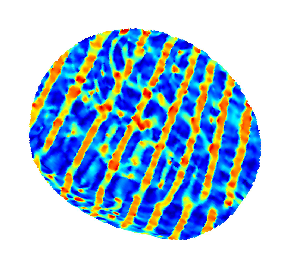

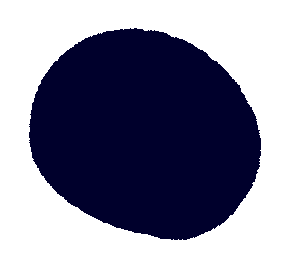

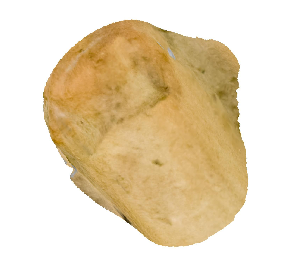

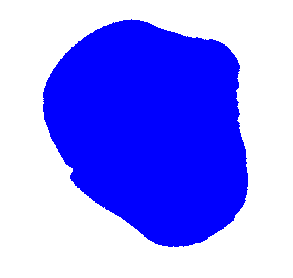

In [19]:
for s in [ 'training', 'validation' ]:
        # open and show random image
        n = random.randint(0, len(env[s+'_images_fns'])-1)
        img_f = env[s+'_images_fns'][n]
        image = PILImage.create(img_f)
        image.show(figsize=(5, 5))
        print(img_f, image.size)
        mask_f = env[s+'_masks_fns'][n]
        mask = PILImage.create(mask_f)
        mask.show(figsize=(5, 5))
        print(mask_f, mask.size)

tensor(255, dtype=torch.uint8)
<class 'fastai.vision.core.PILImage'> <class 'fastai.vision.core.PILImage'> <class 'fastai.vision.core.PILImage'> <class 'fastai.vision.core.PILMask'>
tensor(7, dtype=torch.uint8)


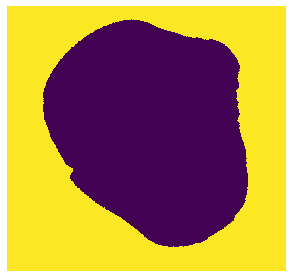

In [20]:
print(torch.max(image2tensor(mask)))
tfm = TargetMaskConvertTransform()
image2, mask2 = tfm.encodes((image, mask))
print(type(image), type(mask), type(image2), type(mask2))
print(torch.max(image2tensor(mask2)))
show_image(mask2)

In [21]:
for s in [ 'training', 'validation' ]:
        n = random.randint(0, len(env[s+'_images_fns'])-1)
        img_f = env[s+'_images_fns'][n]
        print(img_f)
        print(get_y_fn(img_f))

/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/25_6-col.jpg
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/masks/25_6-col.png
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/validation/images/5_11-col.jpg
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/validation/masks/5_11-col.png


In [22]:
# double check the whole dataset to see if every pair (image, mask) is in place
missing_pairs = 0
for s in [ 'training', 'validation' ]:
        for img_fn in env[s+'_images_fns']:
            #print(str(img_fn) + ' -> ' + str(get_y_fn(img_fn)))
            if not img_fn.is_file() or not get_y_fn(img_fn).is_file():
                short_img_fn  = str(img_fn).replace(str(env["path"])+'/',"")
                short_mask_fn = str(get_y_fn(img_fn)).replace(str(env["path"])+'/',"")
                print(f'One between {short_img_fn} and {short_mask_fn} is missing!')
                missing_pairs += 1
                
print(f'A total of {missing_pairs} missing pairs were found...')

A total of 0 missing pairs were found...


# Learning Setup


In [23]:
env['segmentation_type'] = "Semantic Segmentation"
env['arch'] = "deeplabv3+"
env['backbone'] = "resnet152"
env['wd'] = 1e-4
env['n_classes'] = len(codes)

#env['num_workers'] = 0      # 20 min per epoch @ bs = 8
#env['num_workers'] = 8      # 12 min  per epoch @ bs = 8
env['num_workers'] = 16      # 10 min  per epoch @ bs = 8
#env['num_workers'] = 32     # 12 min  per epoch @ bs = 8

env['cmap']        = matplotlib.colors.LinearSegmentedColormap.from_list("", ['blue','red','green','black','magenta','yellow','pink','white'])

In [24]:
def is_frozen(learn, debug=False):
    for child in learn.model.children():
        if debug:
            print(child)
        for param in child.parameters():
            if debug:
                print(param.requires_grad)
            if param.requires_grad == False:
                return True, 'a', 'frozen'
    return False, 'b', 'unfrozen'

In [25]:
def show_hyperparams():
    dp_str = ''
    dv_ids = learn.model.device_ids if 'device_ids' in learn.model.__dict__ else ''
    if 'use_dataparallel' in env:
        dp_str = f' - device_ids: {dv_ids}, n_gpu: {torch.cuda.device_count()}'
    print(f'Batch size: {env["bs"]}, image size: {env["img_size"]}, learning rate: {env["lr"]}, round: {env["train_round"]}' + dp_str)

In [26]:
def get_save_fn(env, debug=False):
    part1 = env['project_name'] + '-' + env['arch'] + '-' + env['backbone'] + '-'
    part2 = env['data-augmentation'] + '-img_size-' + '-'.join(str(x) for x in env['img_size']) + '-'
    part3 = str(env['train_round']) + env['model_frozen_letter']+ '-' + env['launch_time']
    part4 = '-' + 'WD-' + str(env['wd']) + '-' + 'BS-' + str(env['bs']) + '-'
    part5 = 'LR-' + (str(env['lr'].start) + '-' + str(env['lr'].stop) if type(env['lr']) is slice else str(env['lr']))
    env['save_fn'] = part1 + part2 + part3 + part4 + part5   # at the third unspecified error on a four-lines long instruction, one gives up with the one-linearism
    if debug:
        print(f'save_fn = {env["save_fn"]}')
    return 

In [27]:
class SaveBestAccuracyCallback(TrackerCallback):
    def __init__(self, monitor='accuracy', save_str:str='best-accuracy-model'):
        super().__init__(monitor=monitor) #, reset_on_fit=True)
        #self.prev_acc = 0.0
        self.save_str = save_str
        
    def after_epoch(self):
        super().after_epoch()
        if self.new_best:
            print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
            self.save(f'{self.save_str}-epoch-{self.epoch}-{self.monitor}-{self.best:.4f}')

In [28]:
def fit_one_cycle(env, learn, epochs):
    get_save_fn(env, debug=True)
    
    monitor_training   = env['monitor_training']
    comp_training      = env['comp_training']

    monitor_evaluating = env['monitor_evaluating']
    comp_evaluating    = env['comp_evaluating']

    patience           = env['patience']
    
    callbacks = [
        ShowGraphCallback(),
        EarlyStoppingCallback(monitor=monitor_training, comp=comp_training, patience=patience),
        SaveModelCallback(monitor=monitor_training, comp=comp_training, every_epoch=False, fname=env['save_fn']+'-best'),
        SaveBestAccuracyCallback(monitor=monitor_training, save_str=env['save_fn'])
        ]
    
    if env['use_dataparallel']:
        n_gpu = torch.cuda.device_count()
        ctx = learn.parallel_ctx if n_gpu else None
        gpu = None
        
        with partial(ctx, gpu)():
            print(f"Training in {ctx.__name__} context on GPU {list(range(n_gpu))}")
            learn.fit_one_cycle(epochs, env['lr'], cbs=callbacks)
        !nvidia-smi
    else:    
        learn.fit_one_cycle(epochs, env['lr'], cbs=callbacks)
        
    learn.show_results(max_n=16, figsize=(40,40), ncols=4, nrows=4, vmin=0, vmax=env['n_classes']-1, cmap=env['cmap'])

In [29]:
class PILMask(PILBase): _open_args,_show_args = {'mode':'RGB'},{'alpha':0.5}
PILMask._open_args = {'mode':'RGB'}
OpenMask = Transform(PILMask.create)
OpenMask.loss_func = CrossEntropyLossFlat(axis=1)
PILMask.create = OpenMask
PILMask._tensor_cls = TensorMask

def MaskBlock(codes=None):
    "A `TransformBlock` for segmentation masks, potentially with `codes`"
    return TransformBlock(type_tfms=PILMask.create, item_tfms=AddMaskCodes(codes=codes), batch_tfms=IntToFloatTensor)

def init_learner(env):
    env['img_size']    = [int(x / 2) for x in env['orig_img_size']]
    env['bs']          = 64
       
    db = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items=partial(get_x_fns, folders=['training', 'validation']),
                   get_y=get_y_fn,
                   splitter=FuncSplitter(ValidGrandParentSplitter),
                   item_tfms=[Resize(env['img_size']), TargetMaskConvertTransform()],
                   batch_tfms=Normalize.from_stats(*imagenet_stats)
                  )
    db.summary(env['path'])
    dls = db.dataloaders(env['path'], bs=env['bs'], num_workers=env['num_workers'])
    dls.show_batch(figsize=(8, 8), vmin=0, vmax=env['n_classes']-1, cmap=env['cmap'])
    
    learn = get_segmentation_learner(dls=dls, number_classes=env['n_classes'], segmentation_type=env['segmentation_type'],
                                 architecture_name=env['arch'], backbone_name=env['backbone'], 
                                 metrics=[surfpatt_metric, DiceMulti()],wd=env['wd'],
                                 splitter=segmentron_splitter).to_fp16()
    learn.freeze() # Freezing the backbone
    return learn

Setting-up type transforms pipelines
Found 3642 items
2 datasets of sizes 2580,1062
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/11_24-col.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1585x1502
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/11_24-col.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/masks/11_24-col.png
    applying PILBase.create gives
      PILMask mode=RGB size=1585x1502

Final sample: (PILImage mode=RGB size=1585x1502, PILMask mode=RGB size=1585x1502)


Found 3642 items
2 datasets of sizes 2

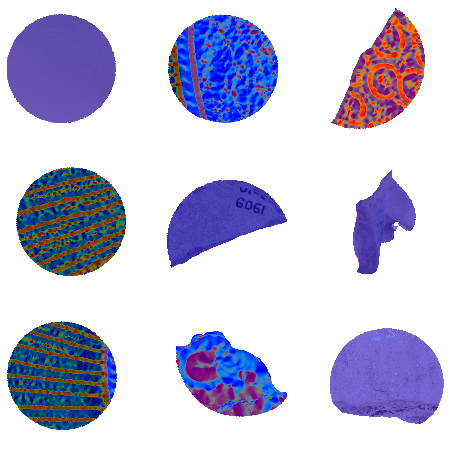

In [30]:
learn = init_learner(env)

In [31]:
import os
def reload_best_model(learn, prefix):
    model_dir = learn.path.absolute() / learn.model_dir
    print(f'Looking for {prefix}-*-best models in: {model_dir}')
    print(20*'-')
    files = model_dir.glob(f'{prefix}*-best.pth')
    files = sorted(files, key=os.path.getmtime)
    for i in files:
        print(i)
    print(20*'-')
    print(f'Reloading {i}')
    learn.load(str(i).replace('.pth', ''))
    metrics = learn.validate()
    for idx, metric_score in enumerate(metrics):
        if idx != 0:
            metric_str = str(str(learn.metrics[idx-1]).split(' ')[0]).split('.')[2]
            print(f'{idx} - {metric_str} = {metric_score}')
        else:
            print(f'{idx} - valid_loss = {metric_score}')

In [32]:
def garbage_collect():
    import gc
    gc.collect()
    torch.cuda.empty_cache()

In [33]:
def test_albumentation_transforms(which_pipeline):
    for s in [ 'training', 'validation' ]:
            n = random.randint(0, len(env[s+'_images_fns'])-1)
            img_f = env[s+'_images_fns'][n]
            image = PILImage.create(img_f)
            print(img_f, image.size)
            mask_f = env[s+'_masks_fns'][n]
            mask = PILImage.create(mask_f)
            print(mask_f, mask.size)
            augimg, augmask = which_pipeline.encodes((image, mask))

            #subplot(r,c) provide the no. of rows and columns
            f, axarr = plt.subplots(1,4,figsize=(15,5)) 

            # use the created array to output your multiple images. In this case I have stacked 4 images vertically
            axarr[0].imshow(image)
            axarr[1].imshow(augimg)
            axarr[2].imshow(mask)
            axarr[3].imshow(augmask)

/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/4_171-col.jpg (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/masks/4_171-col.png (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/validation/images/14_72-col.jpg (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/validation/masks/14_72-col.png (1585, 1502)


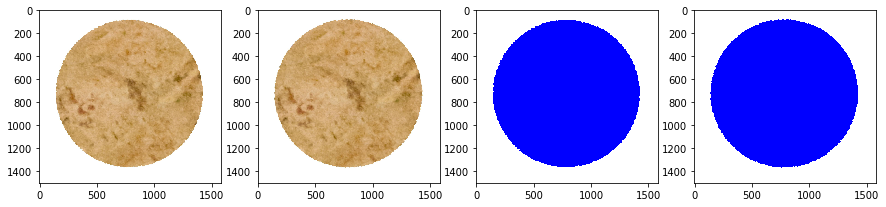

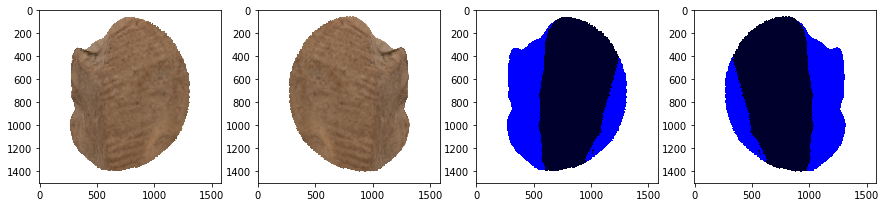

In [34]:
test_albumentation_transforms(basicTransformPipeline)

/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/4_24-col.jpg (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/masks/4_24-col.png (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/validation/images/22_20-si.jpg (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/validation/masks/22_20-si.png (1585, 1502)


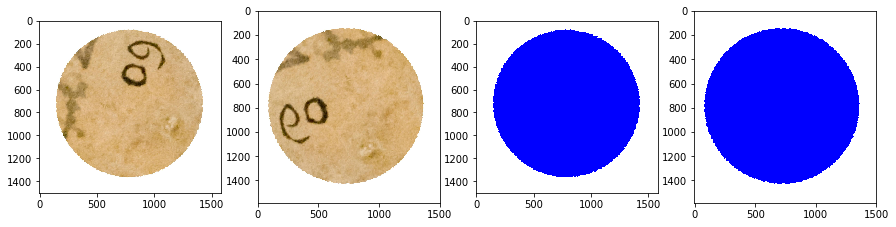

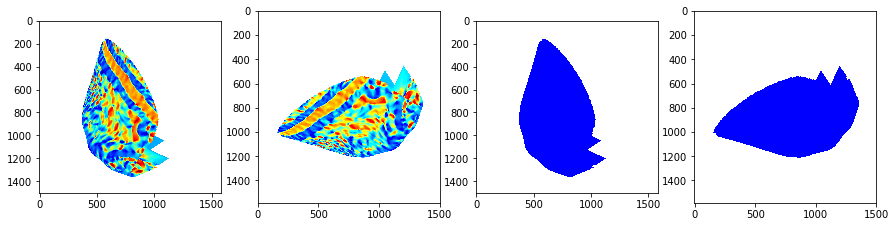

In [35]:
test_albumentation_transforms(strongTransformPipeline)

In [36]:
env['img_size_div'] = [1]
env['batch_sizes']  = [8]

# Define training ground functions

In [37]:
def next_round(env):
    env['train_round'] += 1
    env['img_size']     = [int(env['orig_img_size'][0] / env['img_size_div'][env['train_round']-1])] * 2     
    env['bs']           = env['batch_sizes'][env['train_round']-1]

In [38]:
def alloc_datablock(env, splitter=ValidGrandParentSplitter, training_dir='training', valid_dir='validation'):
    if env['data-augmentation'] == 'no-data-aug':
        print('---------------------------------')
        print('Running with no data augmentation')
        print('---------------------------------')
        item_tfms=[Resize(env['img_size']), TargetMaskConvertTransform()]
    elif env['data-augmentation'] == 'basic-data-aug':
        print('------------------------------------')
        print('Running with basic data augmentation')
        print('------------------------------------')
        item_tfms=[Resize(env['img_size']), TargetMaskConvertTransform(), basicTransformPipeline]
    elif env['data-augmentation'] == 'strong-data-aug':
        print('-------------------------------------')
        print('Running with strong data augmentation')
        print('-------------------------------------')
        item_tfms=[Resize(env['img_size']), TargetMaskConvertTransform(), strongTransformPipeline]
    db = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items=partial(get_x_fns, folders=[training_dir, valid_dir]),
                   get_y=get_y_fn,
                   splitter=FuncSplitter(splitter),
                   item_tfms=item_tfms,
                   batch_tfms=Normalize.from_stats(*imagenet_stats)
                  )
    db.summary(env['path'])
    dls = db.dataloaders(env['path'], bs=env['bs'], num_workers=env['num_workers'])
    dls.show_batch(max_n=16, figsize=(40,40), ncols=4, nrows=4, vmin=0, vmax=env['n_classes']-1, cmap=env['cmap'])
    return dls

In [39]:
def do_lr_find_impl(env, learn):
    if env['use_dataparallel']:
        n_gpu = torch.cuda.device_count()
        ctx = learn.parallel_ctx if n_gpu else None
        gpu = None
        
        with partial(ctx, gpu)():
            print(f"LR_finding in {ctx.__name__} context on GPU {list(range(n_gpu))}")
            suggested_lrs = learn.lr_find() # find learning rate
            
        !nvidia-smi
    else:
        suggested_lrs = learn.lr_find()     # find learning rate
    
    learn.recorder                          # plot learning rate graph
    print(f'Suggested LRs: {suggested_lrs}')
    if suggested_lrs is None:
        suggested_lrs = [1e-4, 1e-4]
    return suggested_lrs

In [40]:
def do_lr_find(env, learn, dls):
    learn.dls = dls
    learn.freeze()
    return do_lr_find_impl(env, learn)

In [41]:
def set_lr(env, learn, suggested_lrs):
    # lr_min is the minimum value in the curve plotted by lr_find()   -> this means that it may be 1e-1 or even 1e0 so it's actually 10x or even 100x the "reasonable" lr_max
    # lr_steep is the x coord of the plot where the slope is steepest -> this means that it may be 1e-2 or so, so it's a reasonable value for actual lr_max
    lr_min = min(suggested_lrs[1]/100, 1e-2)
    lr_max = min(suggested_lrs[1]/10,  5e-2)
    lr_min = max(lr_min, 1e-4)
    lr_max = max(lr_max, 1e-3)
    print(f'Setting LRs to: slice({lr_min}, {lr_max})')
    env['lr'] = slice(lr_min, lr_max)
    model_frozen, env['model_frozen_letter'], env['model_frozen_str '] = is_frozen(learn, debug=False)
    get_save_fn(env, debug=True)
    show_hyperparams()

In [42]:
def train_model(env, learn, epochs=10):
    fit_one_cycle(env, learn, epochs=epochs)
    reload_best_model(learn, '-'.join(env['save_fn'].split('-')[:4]))

In [43]:
def do_lr_find_unfreeze(env, learn):
    learn.unfreeze()
    return do_lr_find_impl(env, learn)

In [44]:
def set_lr_unfreeze(env, learn, suggested_lrs):
    lr_min = min(suggested_lrs[1]/100, 1e-5)
    lr_max = min(suggested_lrs[1]/10,  1e-4)
    lr_min = max(lr_min, 1e-7)
    lr_max = max(lr_max, 1e-6)
    print(f'Setting LRs to: slice({lr_min}, {lr_max})')
    env['lr'] = slice(lr_min, lr_max)
    model_frozen, env['model_frozen_letter'], env['model_frozen_str '] = is_frozen(learn, debug=False)
    get_save_fn(env, debug=True)
    show_hyperparams()

In [45]:
def train_model_unfreeze(env, learn, epochs=10):
    fit_one_cycle(env, learn, epochs=epochs)
    reload_best_model(learn, '-'.join(env['save_fn'].split('-')[:4]))

In [46]:
def do_training_round (env, learn, epochs=10):
    next_round(env)
    dls = alloc_datablock(env)
    
    suggested_lrs = do_lr_find(env, learn, dls)
    set_lr(env, learn, suggested_lrs)
    train_model(env, learn, epochs=epochs)
                
    suggested_lrs = do_lr_find_unfreeze(env, learn)
    set_lr_unfreeze(env, learn, suggested_lrs)
    train_model_unfreeze(env, learn, epochs=epochs)


In [47]:
def show_results(env, learn):
    learn.show_results(max_n=16, figsize=(40,40), ncols=4, nrows=4, vmin=0, vmax=env['n_classes']-1, cmap=env['cmap'])

In [48]:
learn.model

DeepLabV3Plus(
  (backbone): ResNetV1(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BottleneckV1b(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential

# No data Aug


## Round 1
loss scende e valid loss esplode => sto overfittando


In [50]:
env['train_round']       = 0
env['data-augmentation'] = 'no-data-aug'

---------------------------------
Running with no data augmentation
---------------------------------
Setting-up type transforms pipelines
Found 3642 items
2 datasets of sizes 2580,1062
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/11_24-col.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1585x1502
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/11_24-col.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/masks/11_24-col.png
    applying PILBase.create gives
      PILMask mode=RGB size=1585x1502

Final sample: (PILIm

Fri Jul 16 18:10:01 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   41C    P0    43W / 250W |  31521MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,dice_multi,time
0,0.532110,0.403839,0.052157,0.285533,12:31
1,0.443801,0.314877,0.135389,0.329468,12:29
2,0.383254,0.284848,0.197177,0.382882,12:34
3,0.354020,0.278816,0.186166,0.401777,12:31
4,0.377669,0.235069,0.322431,0.490905,12:31
5,0.335809,0.263303,0.334789,0.490998,12:29
6,0.329916,0.230476,0.323905,0.509841,12:32
7,0.293760,0.253614,0.343699,0.469128,12:31
8,0.275507,0.217003,0.306960,0.486141,12:29
9,0.253859,0.188102,0.435884,0.588874,12:30


Better model found at epoch 0 with valid_loss value: 0.4038388133049011.
Better model found at epoch 0 with valid_loss value: 0.4038388133049011.


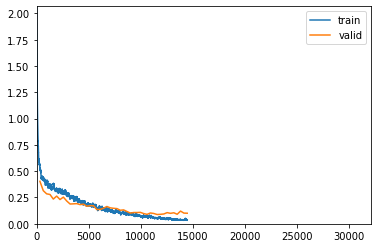

Better model found at epoch 1 with valid_loss value: 0.31487664580345154.
Better model found at epoch 1 with valid_loss value: 0.31487664580345154.
Better model found at epoch 2 with valid_loss value: 0.2848481833934784.
Better model found at epoch 2 with valid_loss value: 0.2848481833934784.
Better model found at epoch 3 with valid_loss value: 0.27881595492362976.
Better model found at epoch 3 with valid_loss value: 0.27881595492362976.
Better model found at epoch 4 with valid_loss value: 0.2350694090127945.
Better model found at epoch 4 with valid_loss value: 0.2350694090127945.
Better model found at epoch 6 with valid_loss value: 0.2304760217666626.
Better model found at epoch 6 with valid_loss value: 0.2304760217666626.
Better model found at epoch 8 with valid_loss value: 0.21700258553028107.
Better model found at epoch 8 with valid_loss value: 0.21700258553028107.
Better model found at epoch 9 with valid_loss value: 0.18810226023197174.
Better model found at epoch 9 with valid_los

Looking for SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-07-16_16.13.07-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-strong-data-aug-img_size-1585-1585-1a-2021-07-16_17.10.15-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
--------------------
Reloading /home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth


/local/ranieri/venvs/ml-local-node-10/lib64/python3.6/site-packages/fastai/learner.py:56: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


0 - valid_loss = 0.08828889578580856
1 - AvgMetric = 0.6018795371055603
2 - DiceMulti = 0.8314908369817906
LR_finding in parallel_ctx context on GPU [0, 1]


Sat Jul 17 03:39:35 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   46C    P0    45W / 250W |  31193MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,dice_multi,time
0,0.054365,0.098289,0.609646,0.814151,13:51
1,0.063663,0.093780,0.617328,0.824579,13:53
2,0.060265,0.087972,0.619634,0.832370,13:45
3,0.055795,0.093169,0.605161,0.822975,13:48
4,0.051068,0.088775,0.615060,0.825500,13:51
5,0.048270,0.091652,0.612494,0.826093,13:48
6,0.051045,0.088222,0.608634,0.830068,13:47
7,0.044715,0.095118,0.608275,0.817452,13:49
8,0.052159,0.096645,0.609668,0.812111,13:47
9,0.042179,0.090932,0.618403,0.827237,13:46


Better model found at epoch 0 with valid_loss value: 0.0982891172170639.
Better model found at epoch 0 with valid_loss value: 0.0982891172170639.


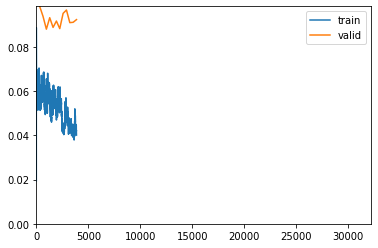

Better model found at epoch 1 with valid_loss value: 0.09378001093864441.
Better model found at epoch 1 with valid_loss value: 0.09378001093864441.
Better model found at epoch 2 with valid_loss value: 0.08797162026166916.
Better model found at epoch 2 with valid_loss value: 0.08797162026166916.
No improvement since epoch 2: early stopping
Sat Jul 17 06:39:31 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |           

Looking for SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-07-16_16.13.07-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-strong-data-aug-img_size-1585-1585-1a-2021-07-16_17.10.15-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-1e-07-1e-06-best.pth
--------------------
Reloading /home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-1e-07-1e-06

0 - valid_loss = 0.08797647804021835
1 - AvgMetric = 0.6196392774581909
2 - DiceMulti = 0.8323499562596403


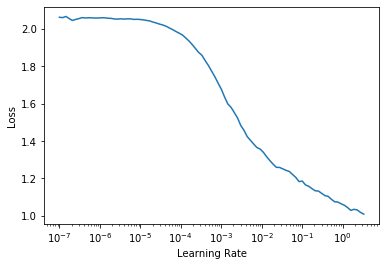

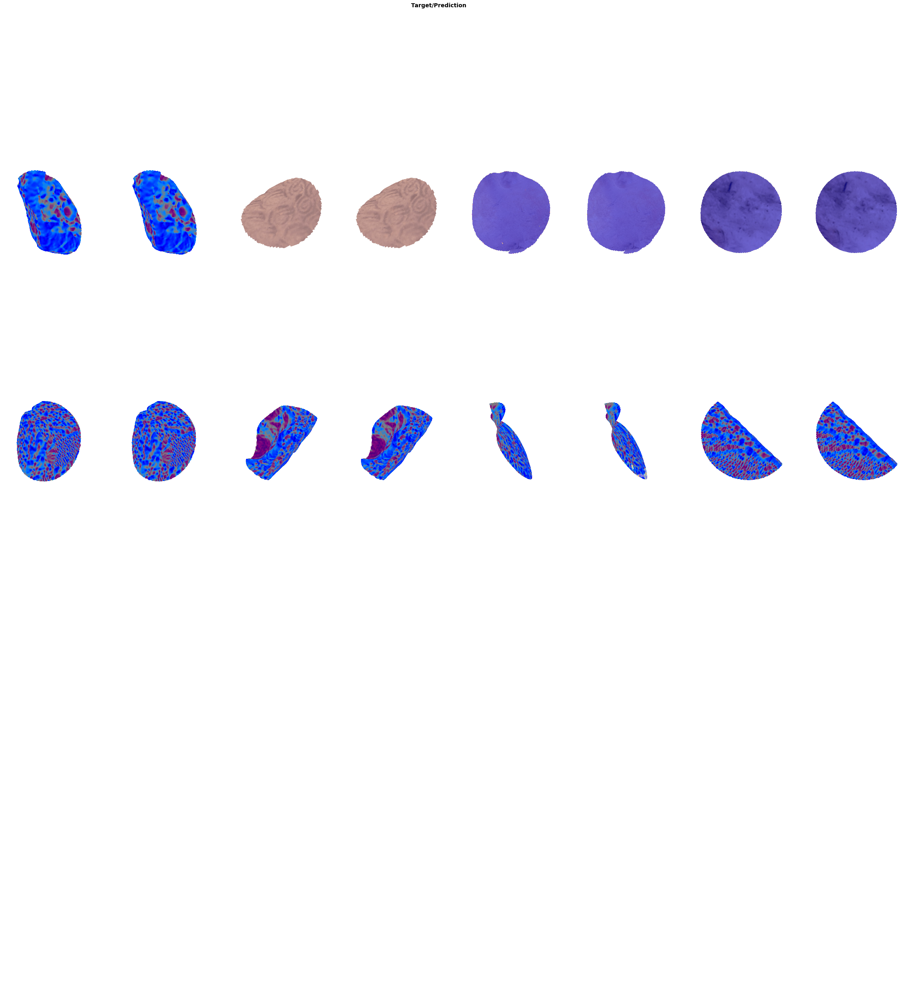

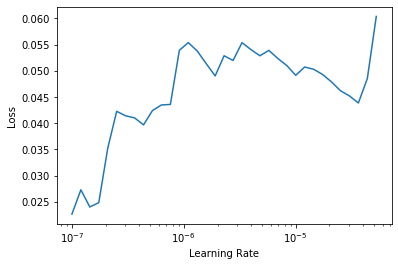

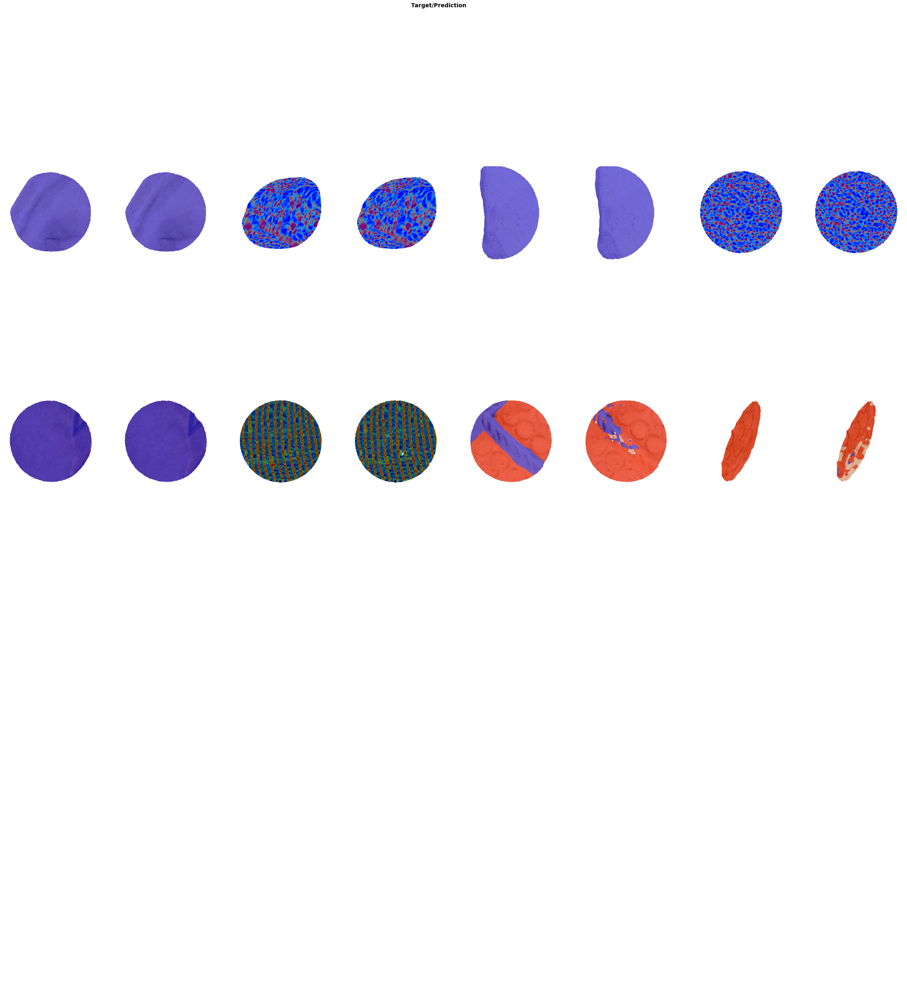

In [51]:
do_training_round(env, learn, epochs=100)

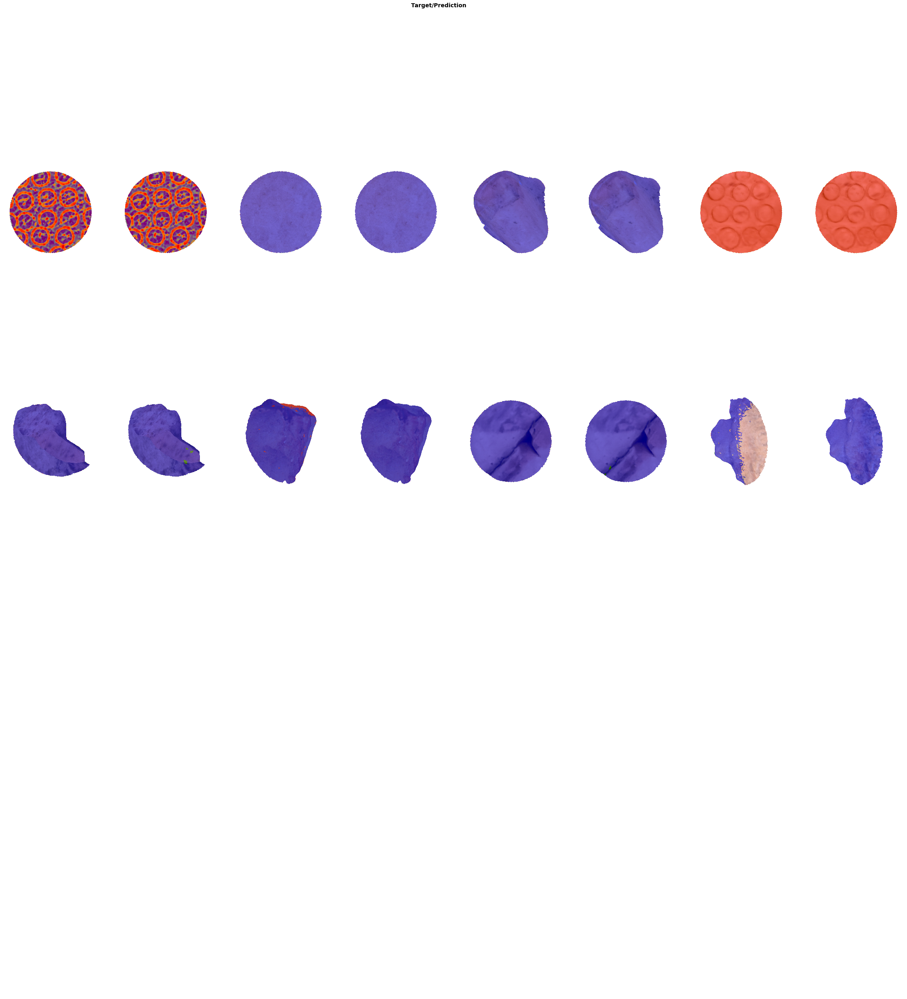

In [53]:
show_results(env, learn)

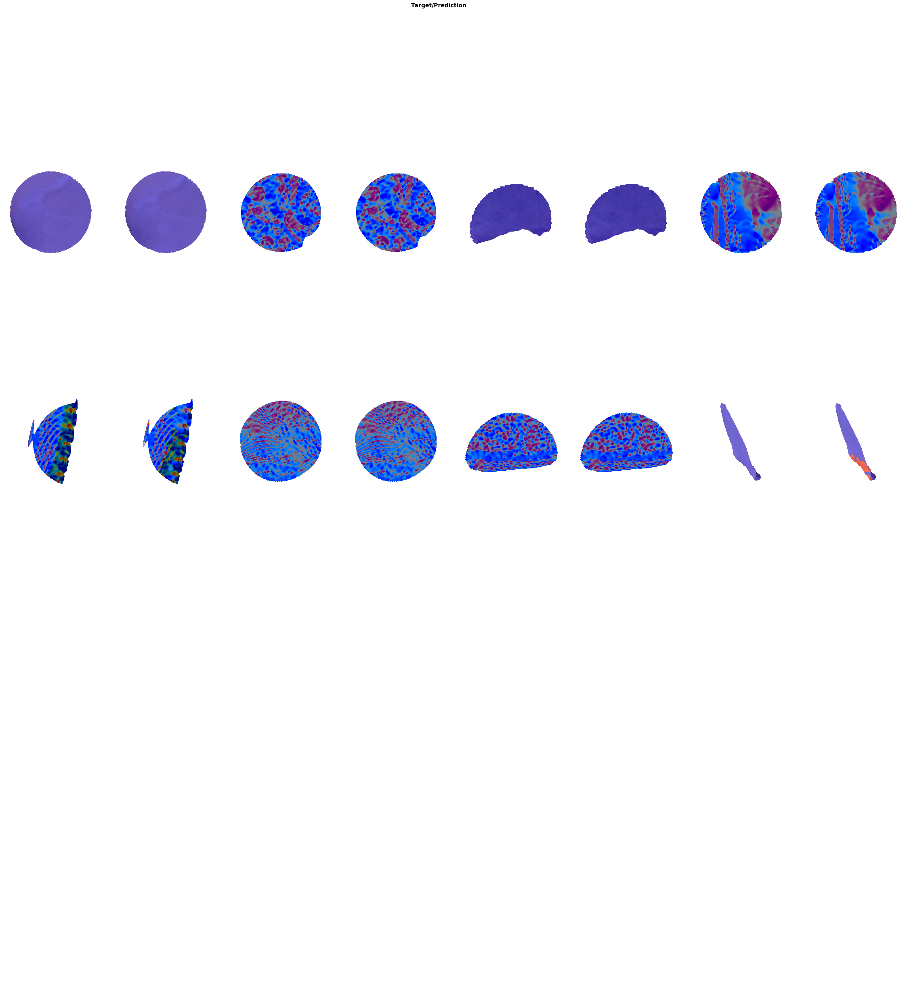

In [54]:
show_results(env, learn)

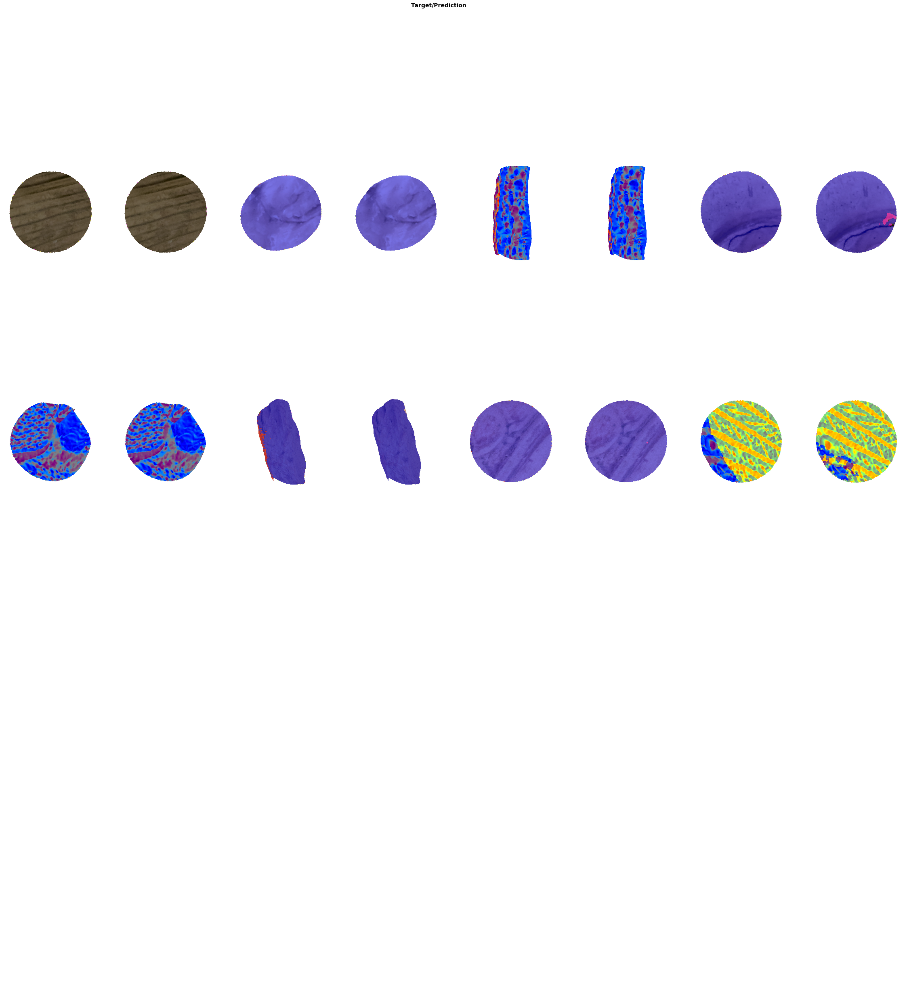

In [55]:
show_results(env, learn)

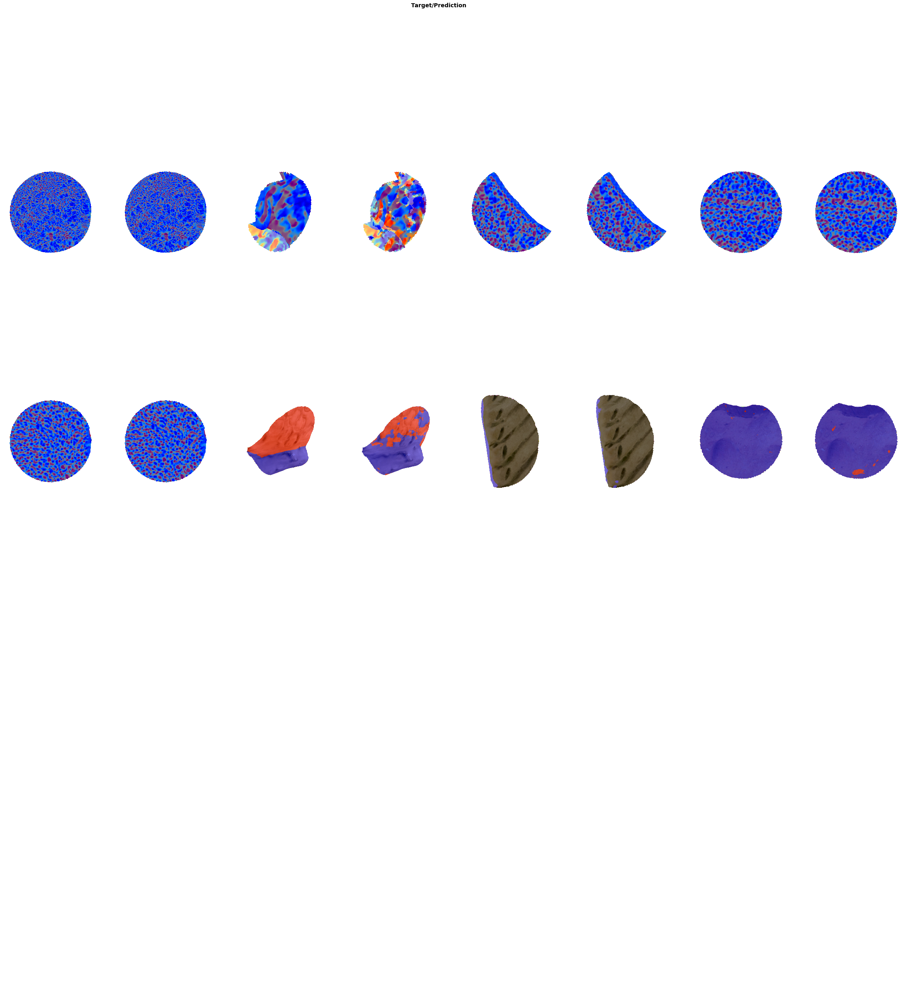

In [57]:
show_results(env, learn)

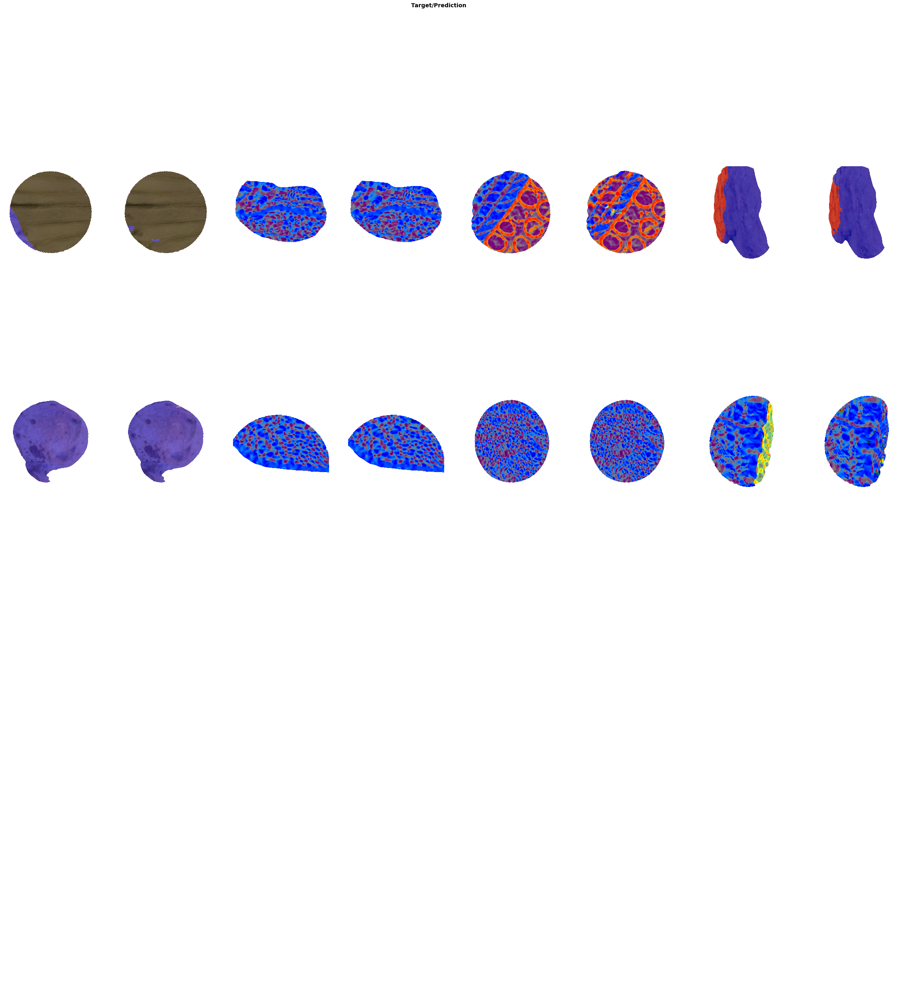

In [58]:
show_results(env, learn)

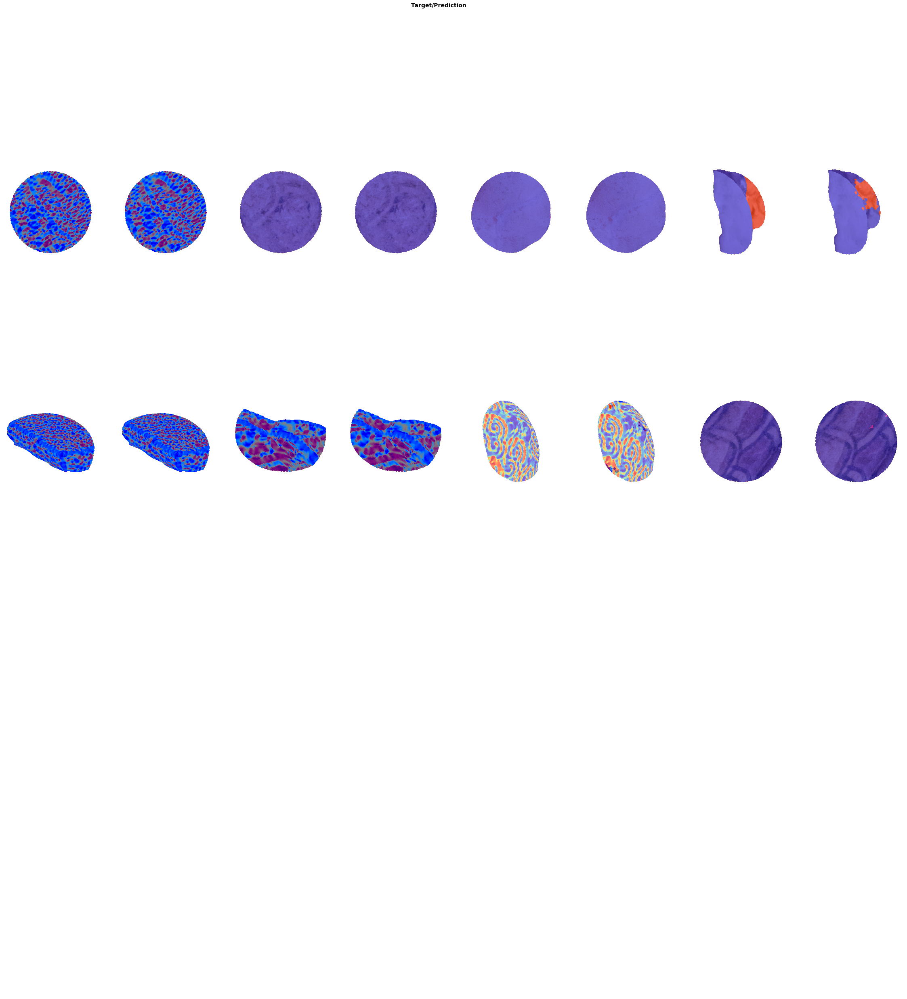

In [60]:
show_results(env, learn)

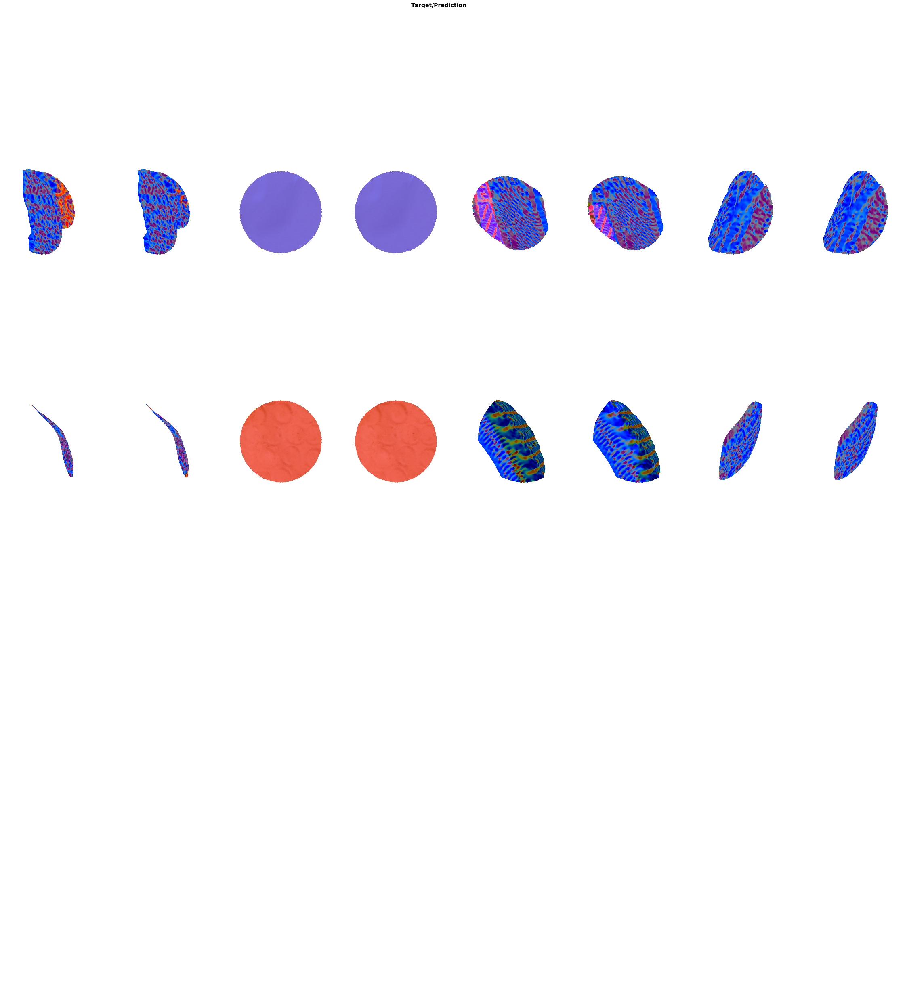

In [61]:
show_results(env, learn)

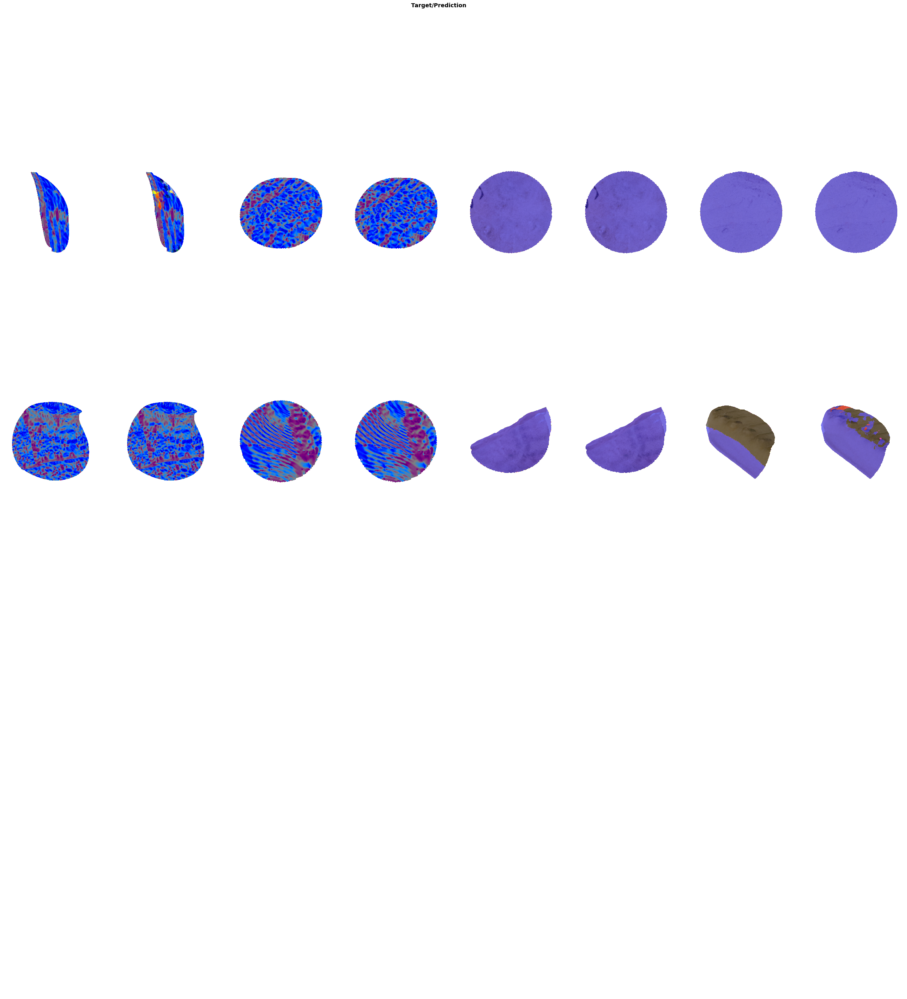

In [62]:
show_results(env, learn)

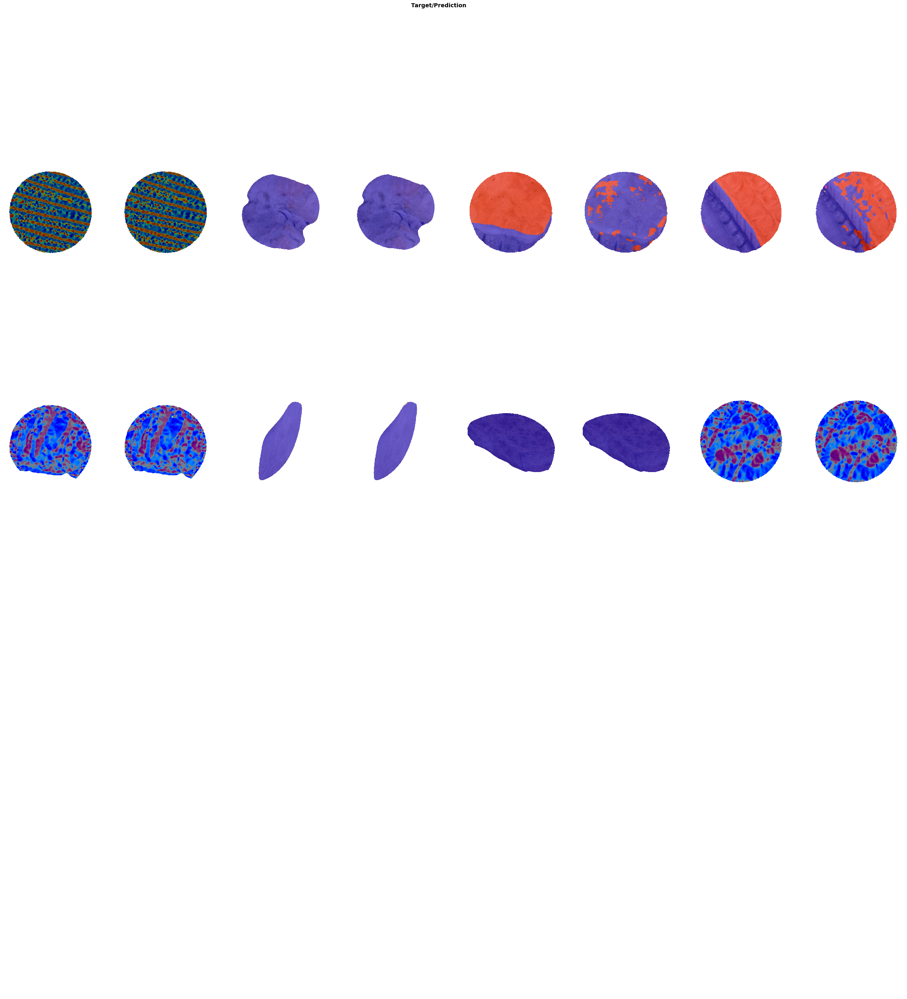

In [63]:
show_results(env, learn)

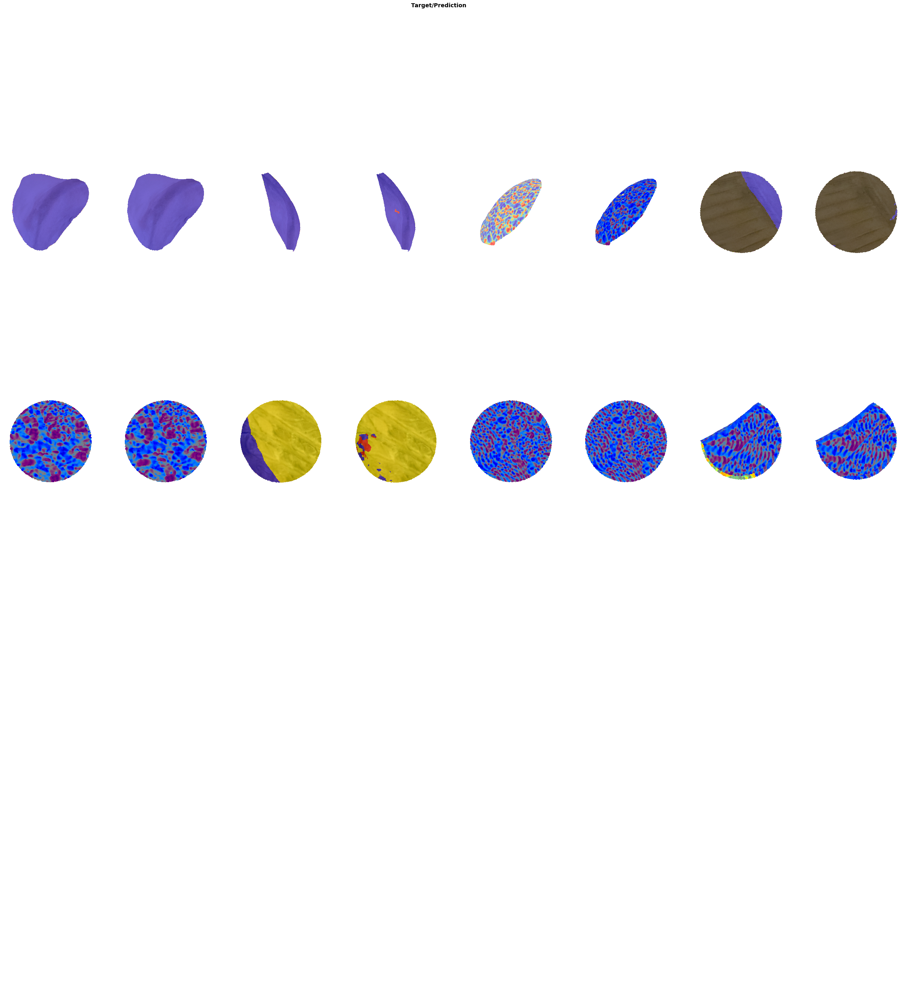

In [64]:
show_results(env, learn)

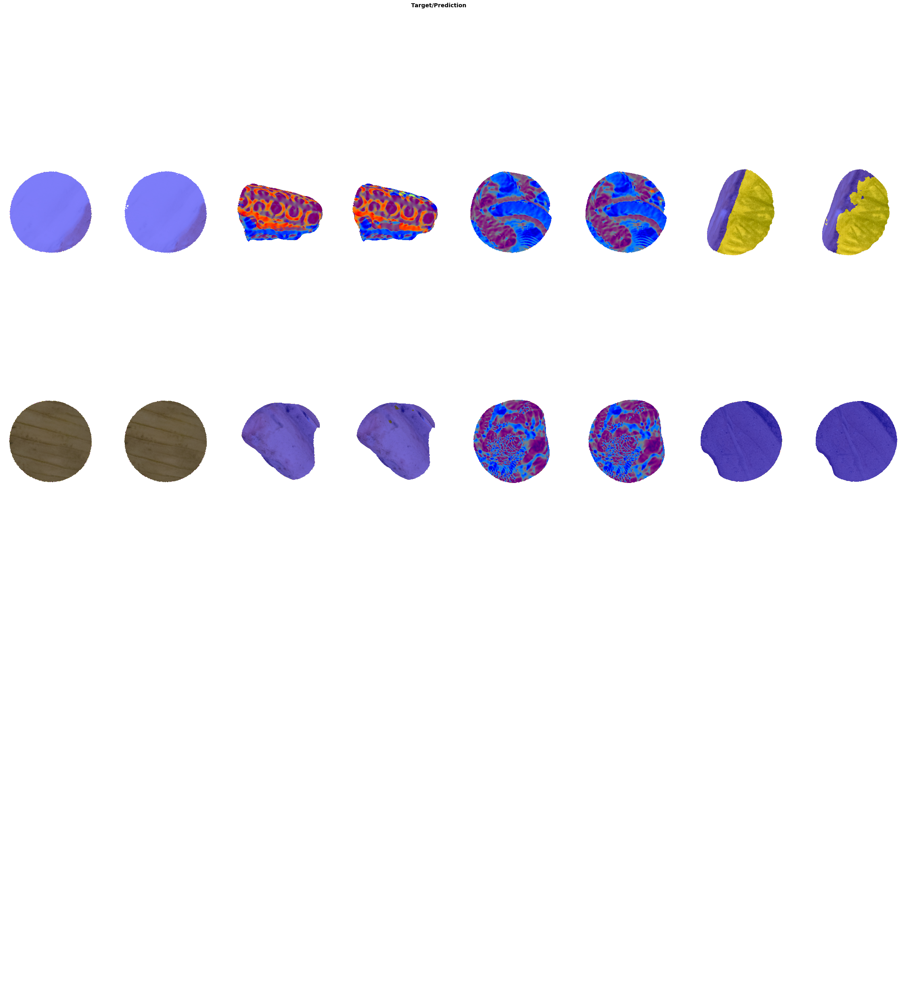

In [65]:
show_results(env, learn)

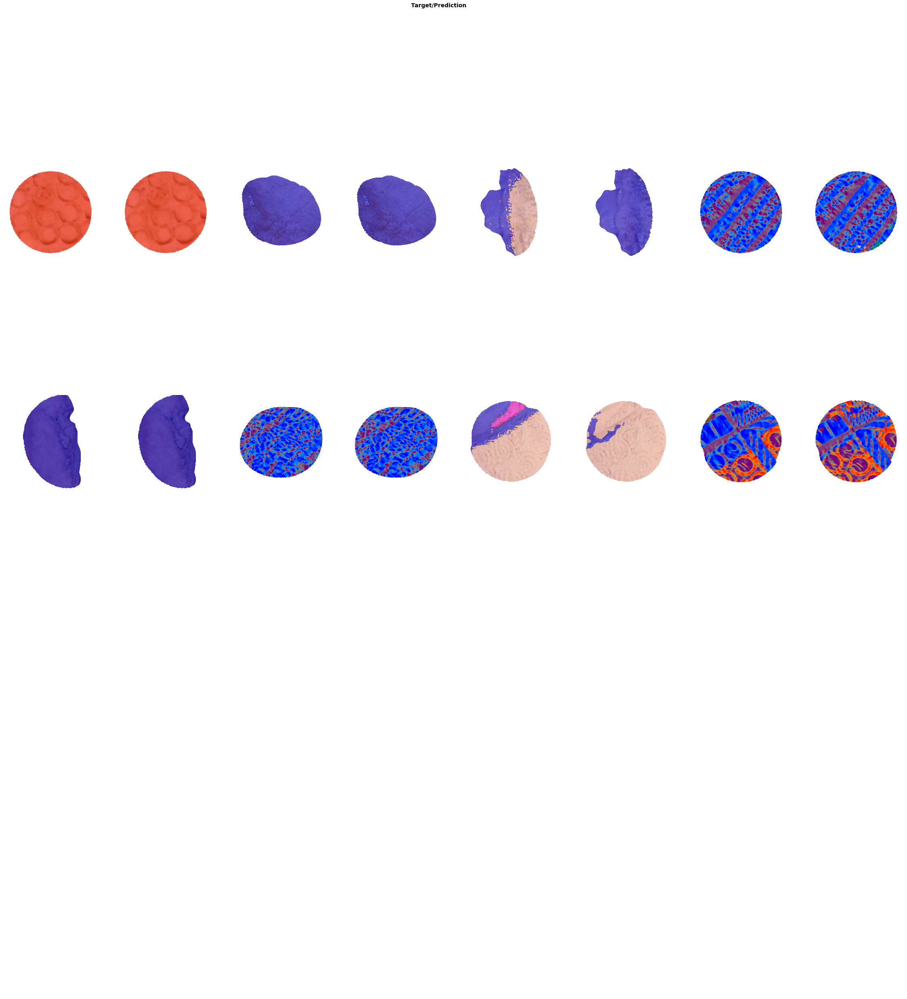

In [67]:
show_results(env, learn)

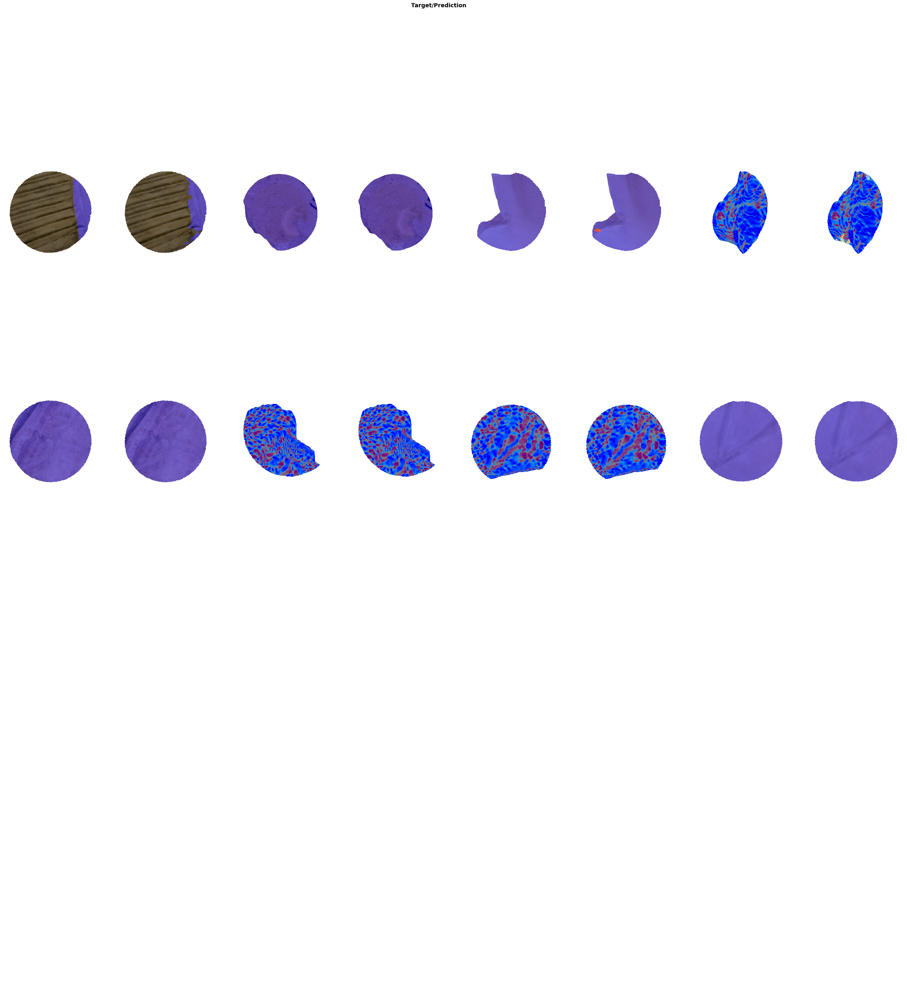

In [68]:
show_results(env, learn)

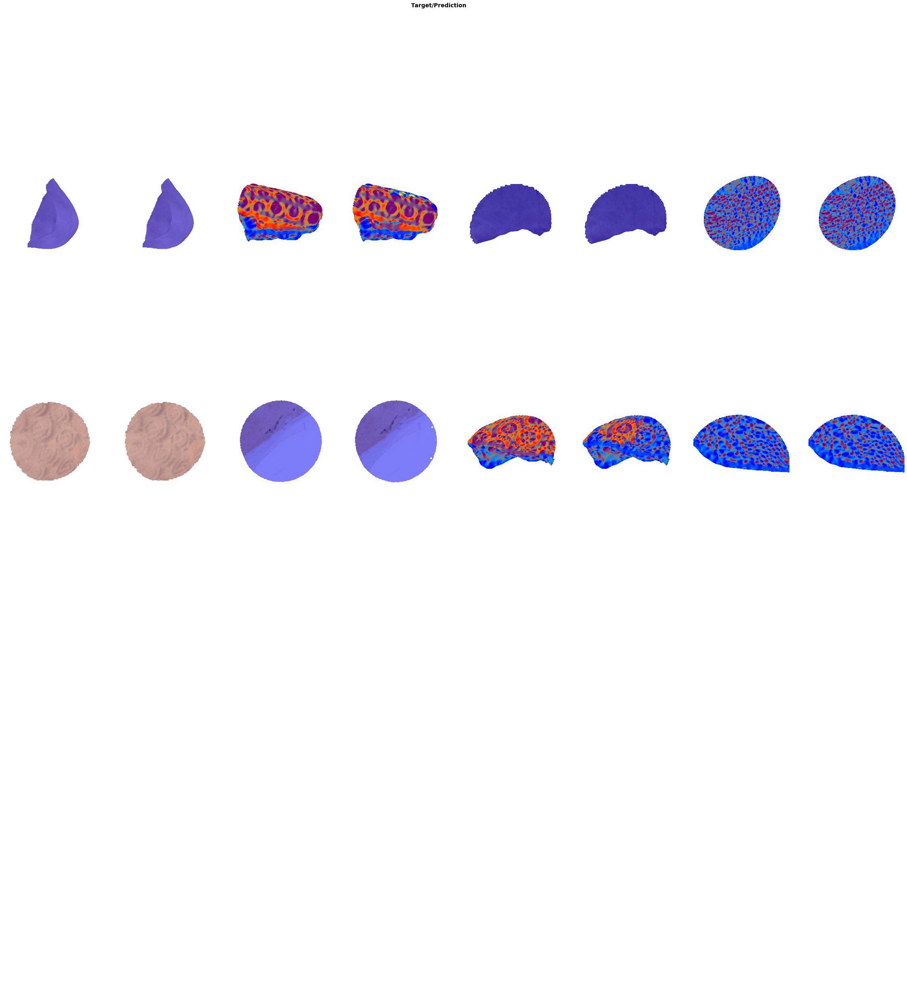

In [69]:
show_results(env, learn)

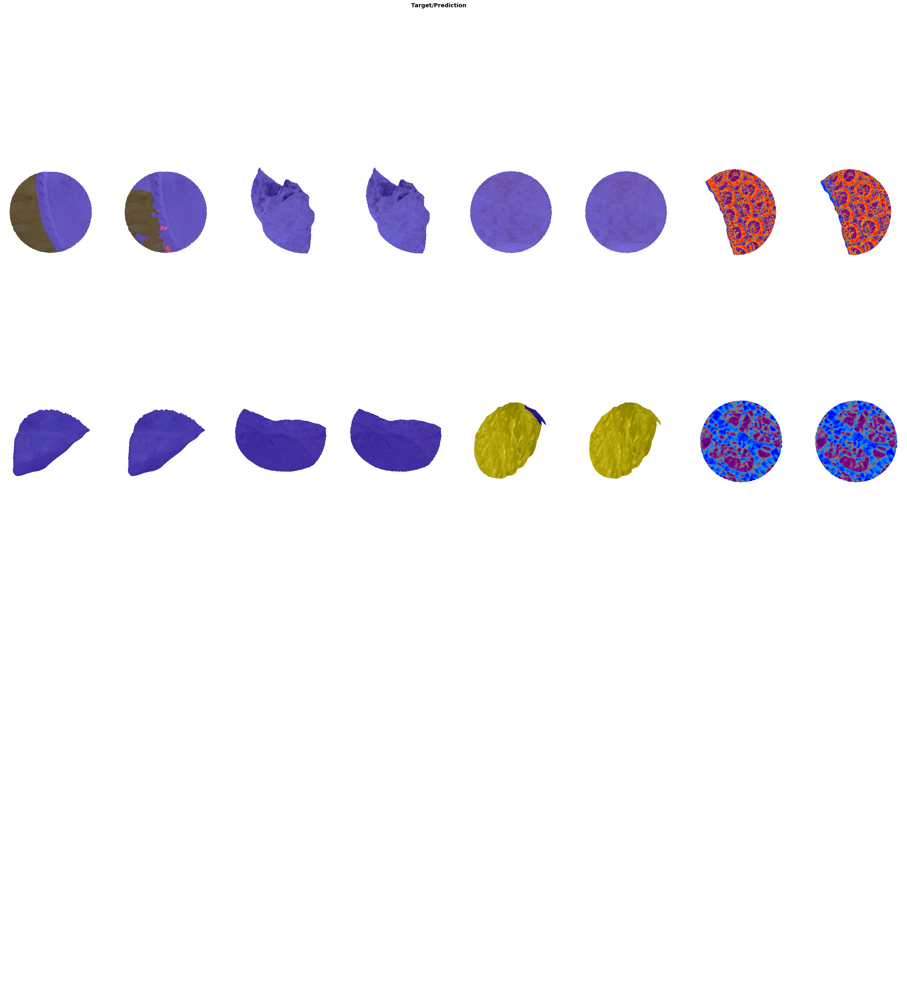

In [70]:
show_results(env, learn)

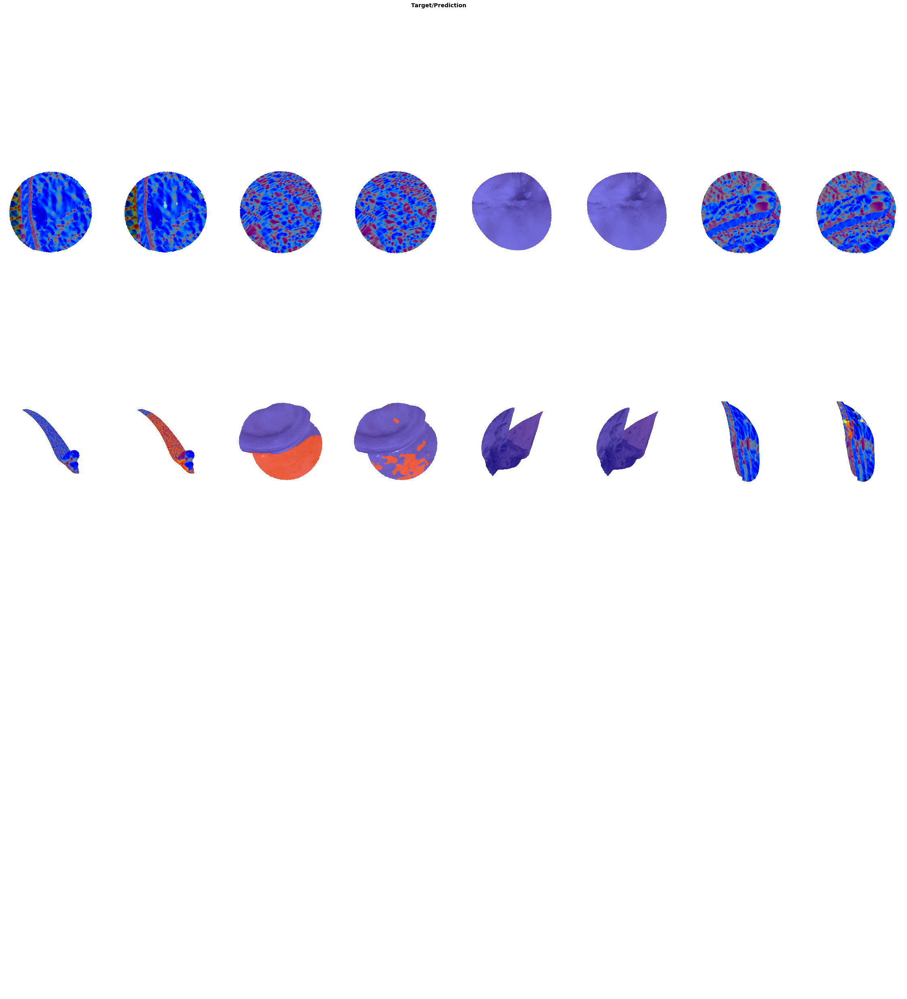

In [71]:
show_results(env, learn)

# Basic Data Aug

Setting-up type transforms pipelines
Found 3642 items
2 datasets of sizes 2580,1062
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/11_24-col.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1585x1502
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/11_24-col.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/masks/11_24-col.png
    applying PILBase.create gives
      PILMask mode=RGB size=1585x1502

Final sample: (PILImage mode=RGB size=1585x1502, PILMask mode=RGB size=1585x1502)


Found 3642 items
2 datasets of sizes 2

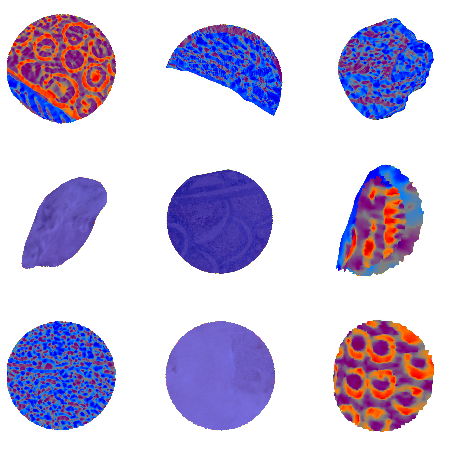

In [72]:
learn = init_learner(env)

## Round 1

------------------------------------
Running with basic data augmentation
------------------------------------
Setting-up type transforms pipelines
Found 3642 items
2 datasets of sizes 2580,1062
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/11_24-col.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1585x1502
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/11_24-col.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/masks/11_24-col.png
    applying PILBase.create gives
      PILMask mode=RGB size=1585x1502

Final sampl

Thu Jul 29 13:03:06 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   39C    P0    44W / 250W |  31521MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,dice_multi,time
0,0.580132,0.426020,0.019943,0.257793,13:03
1,0.476342,0.365630,0.113890,0.297332,12:59
2,0.416835,0.321930,0.181260,0.345727,12:48
3,0.420505,0.348494,0.226065,0.347822,12:53
4,0.373323,0.303132,0.258597,0.395845,12:50
5,0.401806,0.304465,0.274132,0.431928,12:51
6,0.395711,0.247404,0.253663,0.431659,12:55
7,0.375460,0.279875,0.351685,0.434298,12:55
8,0.344955,0.255683,0.311406,0.455679,12:50
9,0.360908,0.211121,0.388386,0.518259,12:57


Better model found at epoch 0 with valid_loss value: 0.4260195791721344.
Better model found at epoch 0 with valid_loss value: 0.4260195791721344.


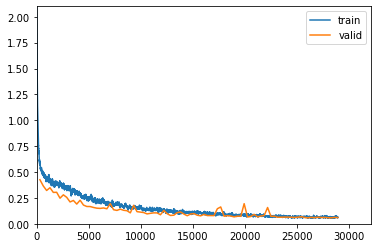

Better model found at epoch 1 with valid_loss value: 0.36562952399253845.
Better model found at epoch 1 with valid_loss value: 0.36562952399253845.
Better model found at epoch 2 with valid_loss value: 0.32193049788475037.
Better model found at epoch 2 with valid_loss value: 0.32193049788475037.
Better model found at epoch 4 with valid_loss value: 0.30313244462013245.
Better model found at epoch 4 with valid_loss value: 0.30313244462013245.
Better model found at epoch 6 with valid_loss value: 0.24740393459796906.
Better model found at epoch 6 with valid_loss value: 0.24740393459796906.
Better model found at epoch 9 with valid_loss value: 0.21112129092216492.
Better model found at epoch 9 with valid_loss value: 0.21112129092216492.
Better model found at epoch 11 with valid_loss value: 0.19050897657871246.
Better model found at epoch 11 with valid_loss value: 0.19050897657871246.
Better model found at epoch 13 with valid_loss value: 0.1811426281929016.
Better model found at epoch 13 with 

Looking for SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-07-16_16.13.07-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-strong-data-aug-img_size-1585-1585-1a-2021-07-16_17.10.15-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-1e-07-1e-06-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-basic-data-aug-img_size-1585-1585-1a-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/not

/local/ranieri/venvs/ml-local-node-10/lib64/python3.6/site-packages/fastai/learner.py:56: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


0 - valid_loss = 0.05751423165202141
1 - AvgMetric = 0.650291383266449
2 - DiceMulti = 0.9021251659770686
LR_finding in parallel_ctx context on GPU [0, 1]


Fri Jul 30 08:14:54 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   45C    P0    40W / 250W |  31193MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,dice_multi,time
0,0.060957,0.059813,0.632793,0.897912,13:08
1,0.063676,0.060840,0.640562,0.894728,13:09
2,0.062385,0.060667,0.646659,0.897541,13:05
3,0.064156,0.060321,0.642821,0.895578,13:07
4,0.057147,0.060055,0.643927,0.891119,13:06
5,0.065091,0.066240,0.634039,0.895519,13:05
6,0.060062,0.059082,0.658804,0.898201,13:05
7,0.069446,0.058805,0.653837,0.900427,13:06
8,0.058915,0.059357,0.653146,0.901476,13:07
9,0.071079,0.064959,0.643219,0.895963,13:05


Better model found at epoch 0 with valid_loss value: 0.059812676161527634.
Better model found at epoch 0 with valid_loss value: 0.059812676161527634.


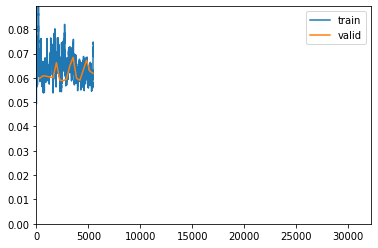

Better model found at epoch 6 with valid_loss value: 0.059082306921482086.
Better model found at epoch 6 with valid_loss value: 0.059082306921482086.
Better model found at epoch 7 with valid_loss value: 0.058804914355278015.
Better model found at epoch 7 with valid_loss value: 0.058804914355278015.
No improvement since epoch 7: early stopping
Fri Jul 30 12:11:26 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |       

Looking for SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-07-16_16.13.07-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-strong-data-aug-img_size-1585-1585-1a-2021-07-16_17.10.15-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-1e-07-1e-06-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-basic-data-aug-img_size-1585-1585-1a-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/not

0 - valid_loss = 0.058806341141462326
1 - AvgMetric = 0.6538408994674683
2 - DiceMulti = 0.9004189110002627


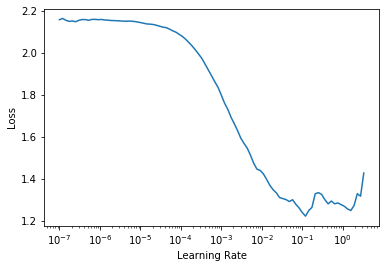

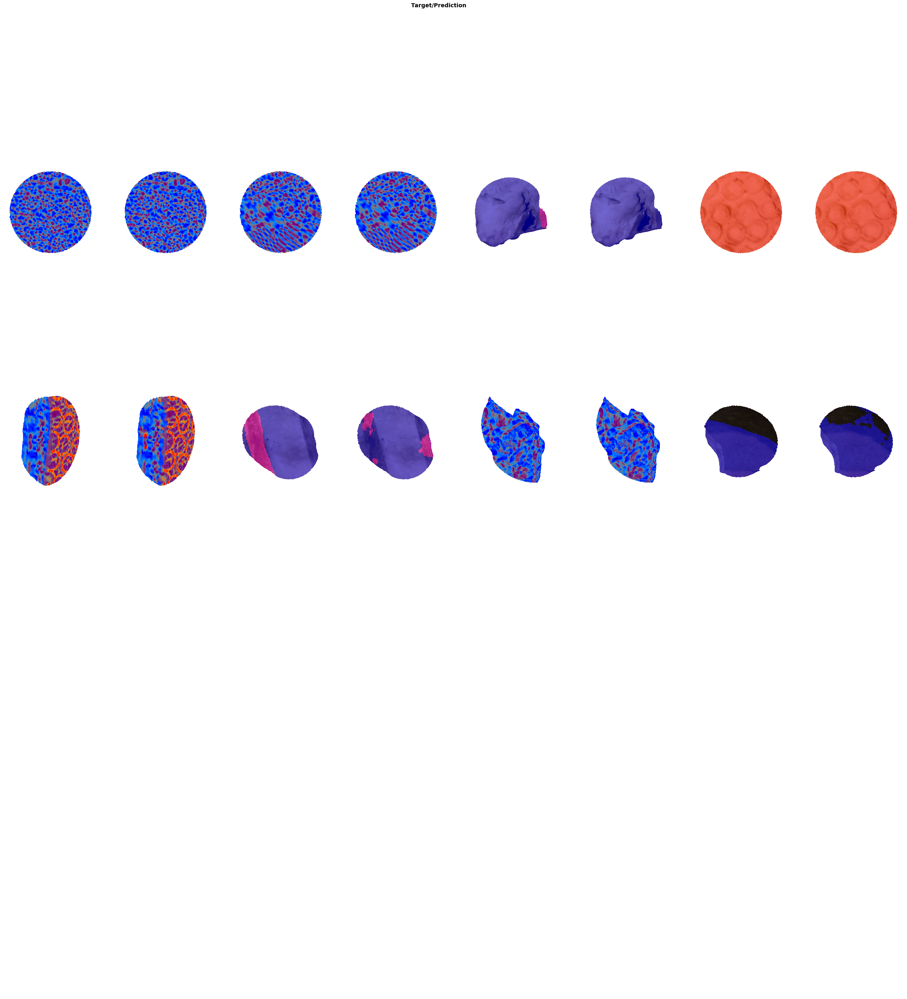

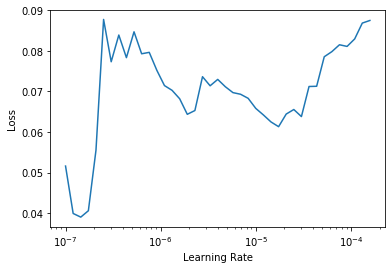

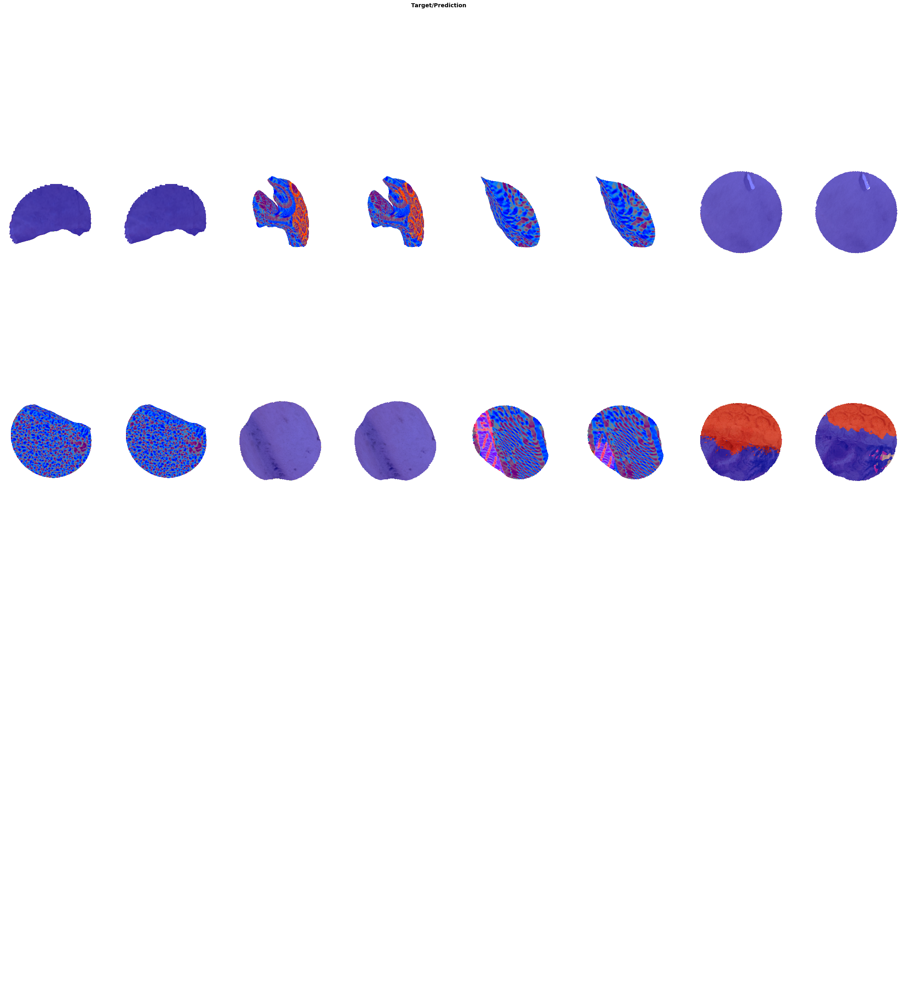

In [73]:
env['train_round']       = 0
env['data-augmentation'] = 'basic-data-aug'
do_training_round(env, learn, epochs=100)

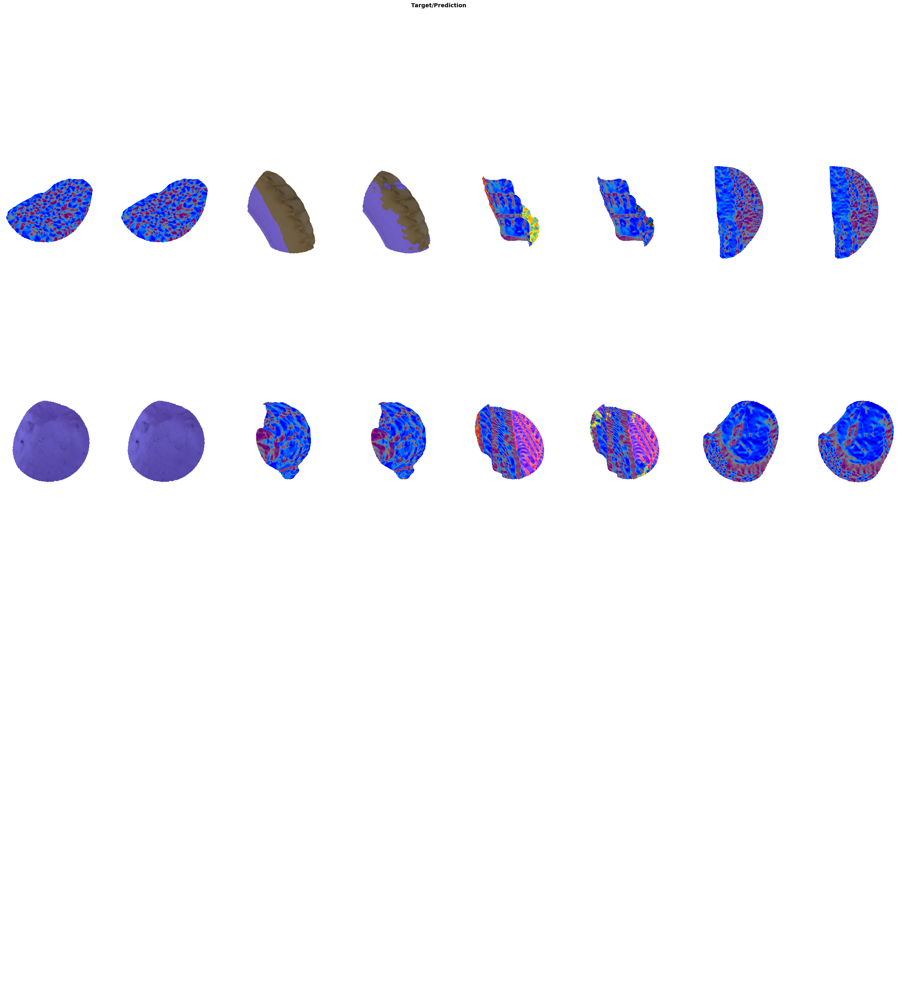

In [75]:
show_results(env, learn)

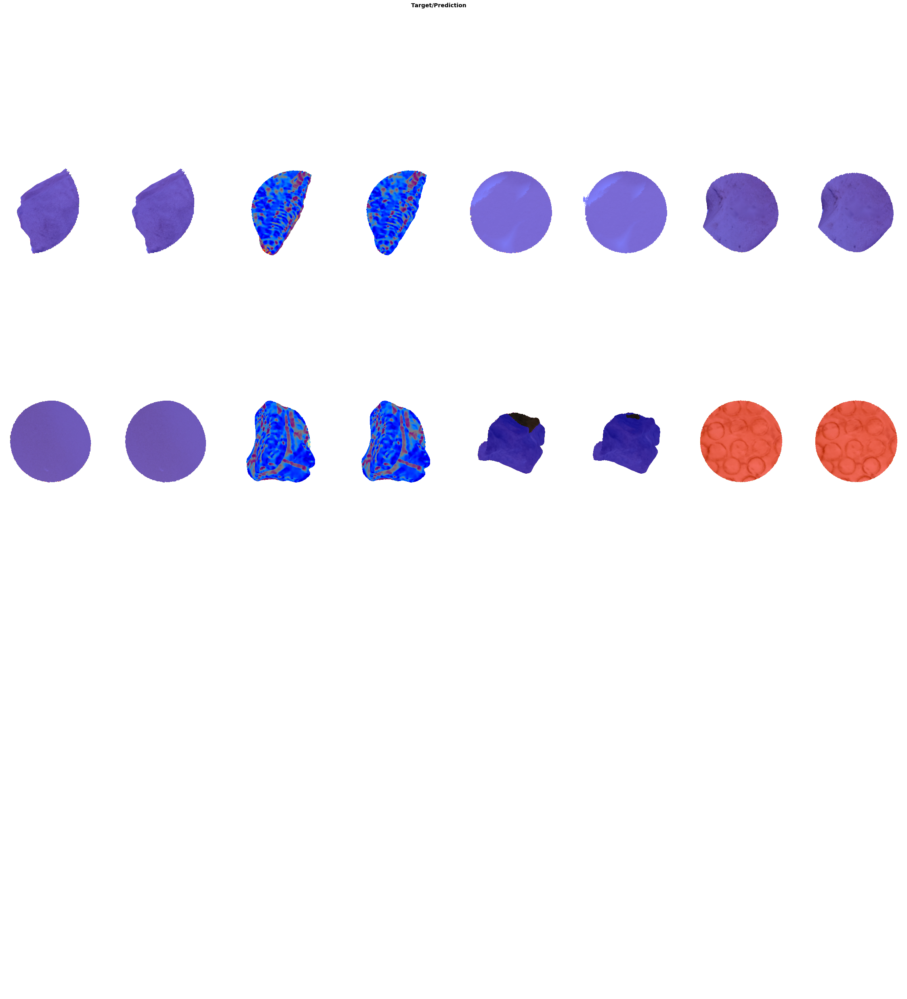

In [76]:
show_results(env, learn)

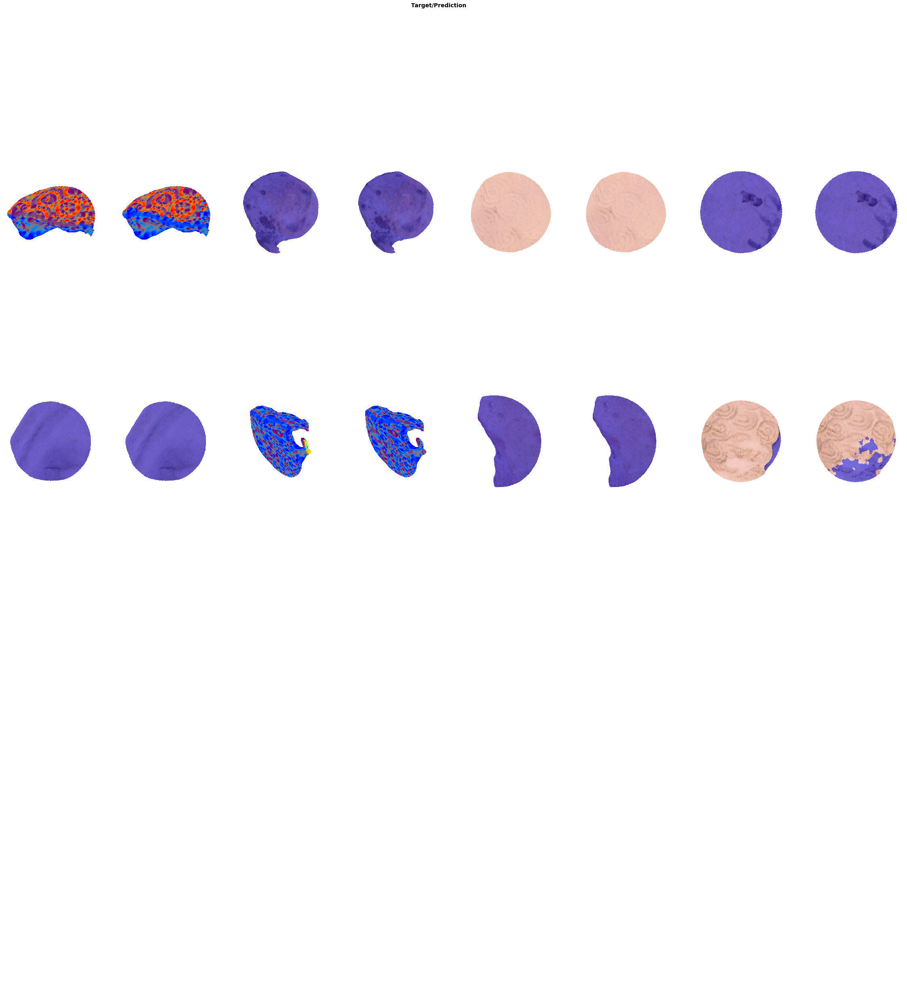

In [77]:
show_results(env, learn)

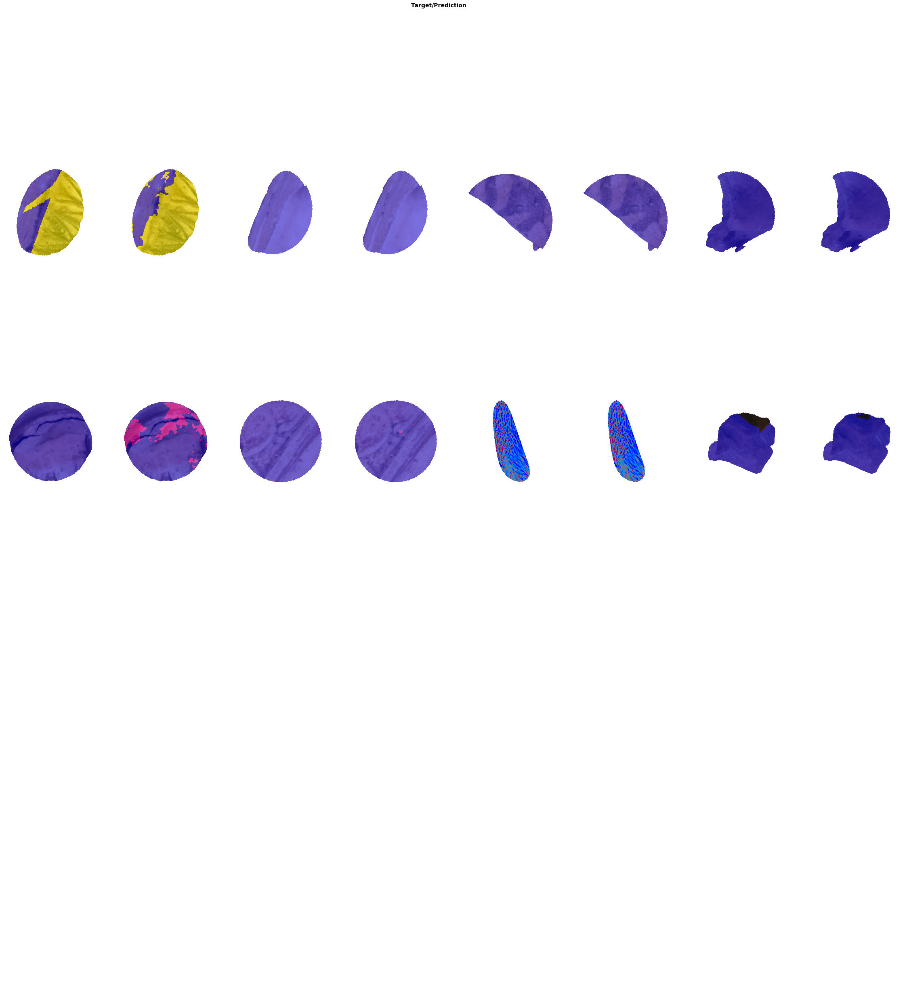

In [78]:
show_results(env, learn)

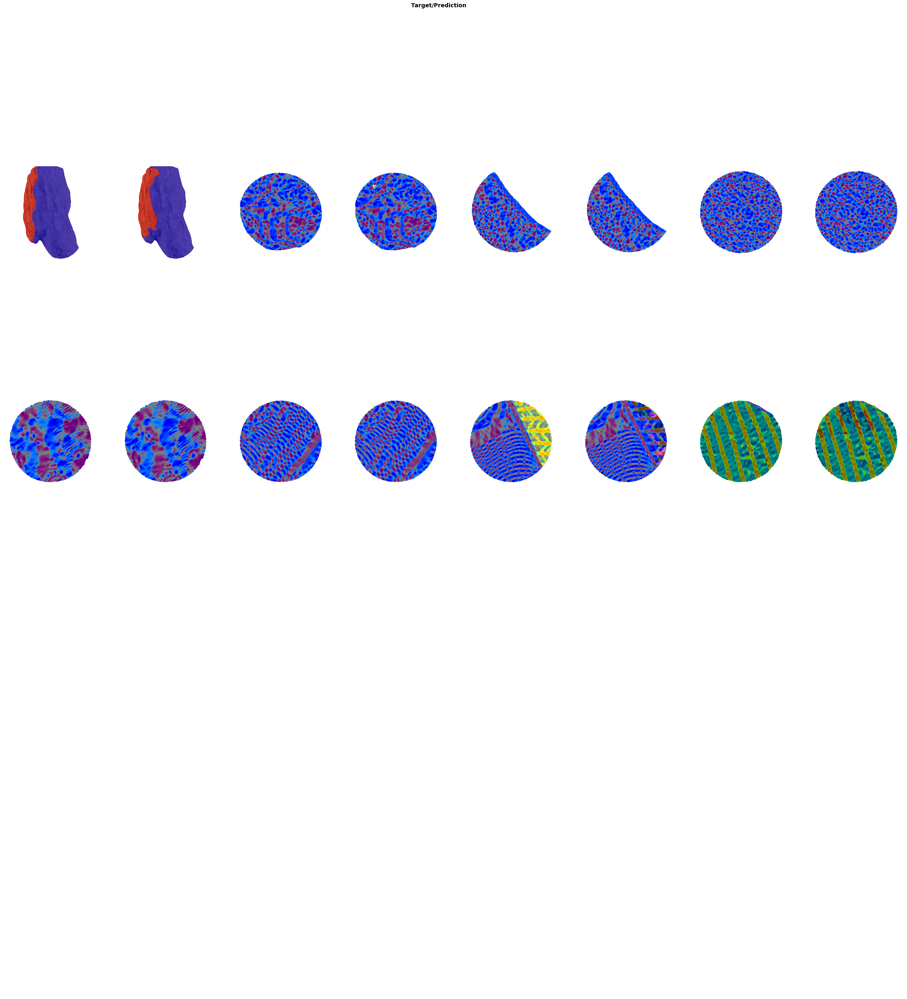

In [79]:
show_results(env, learn)

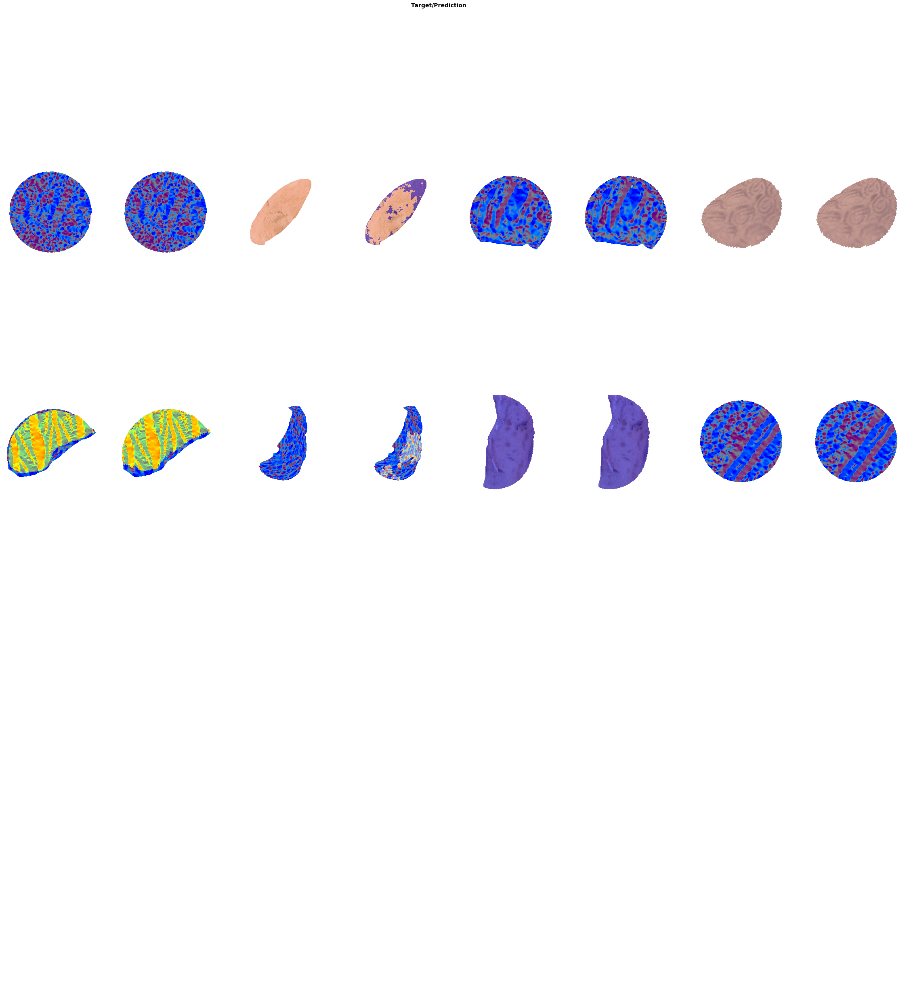

In [80]:
show_results(env, learn)

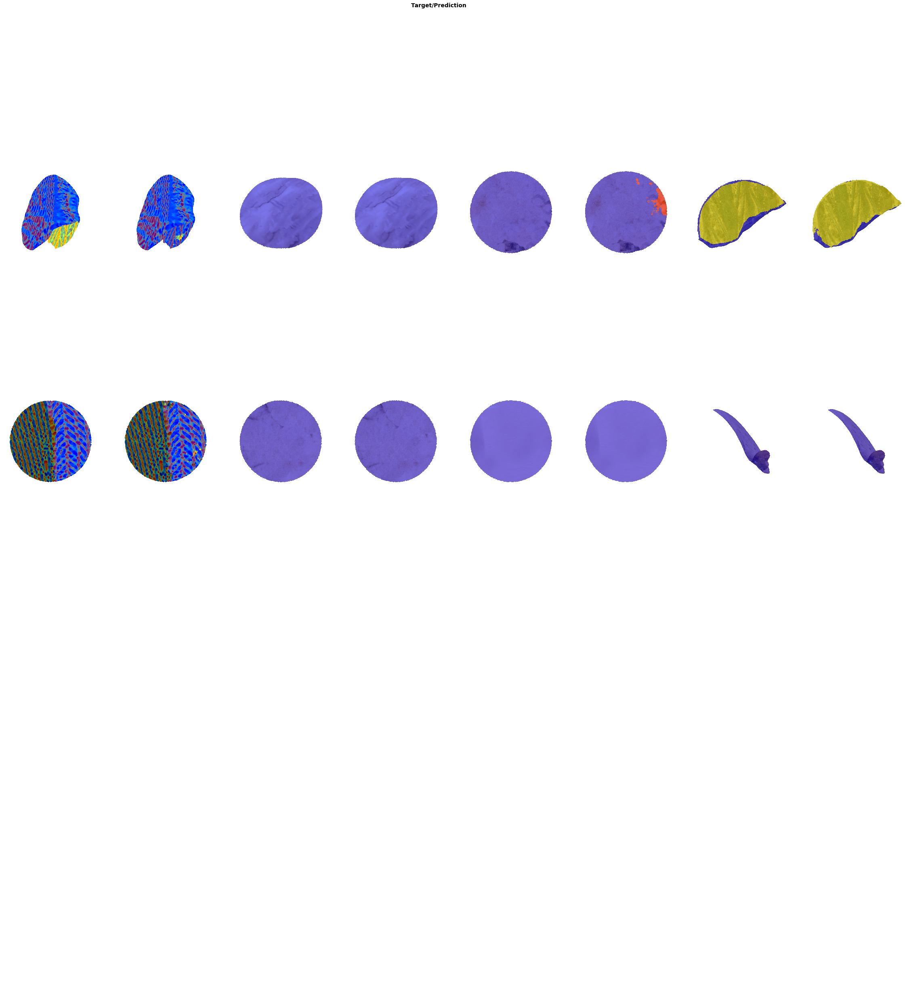

In [81]:
show_results(env, learn)

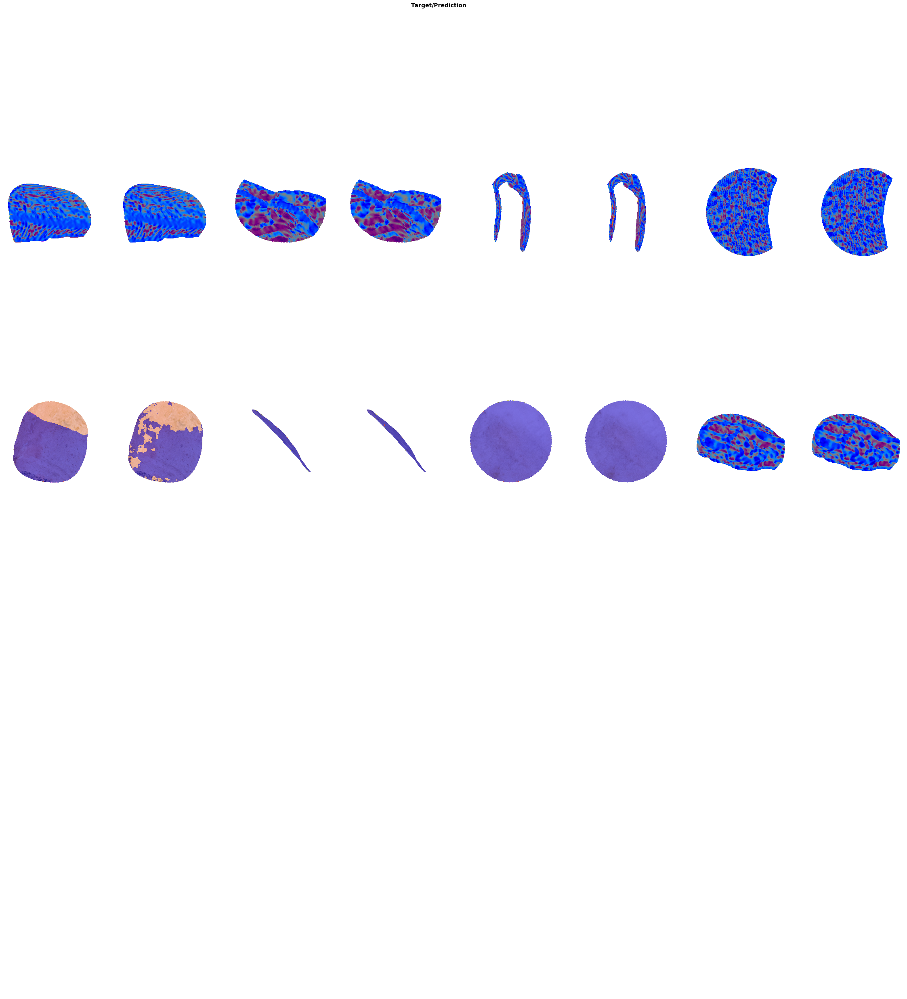

In [82]:
show_results(env, learn)

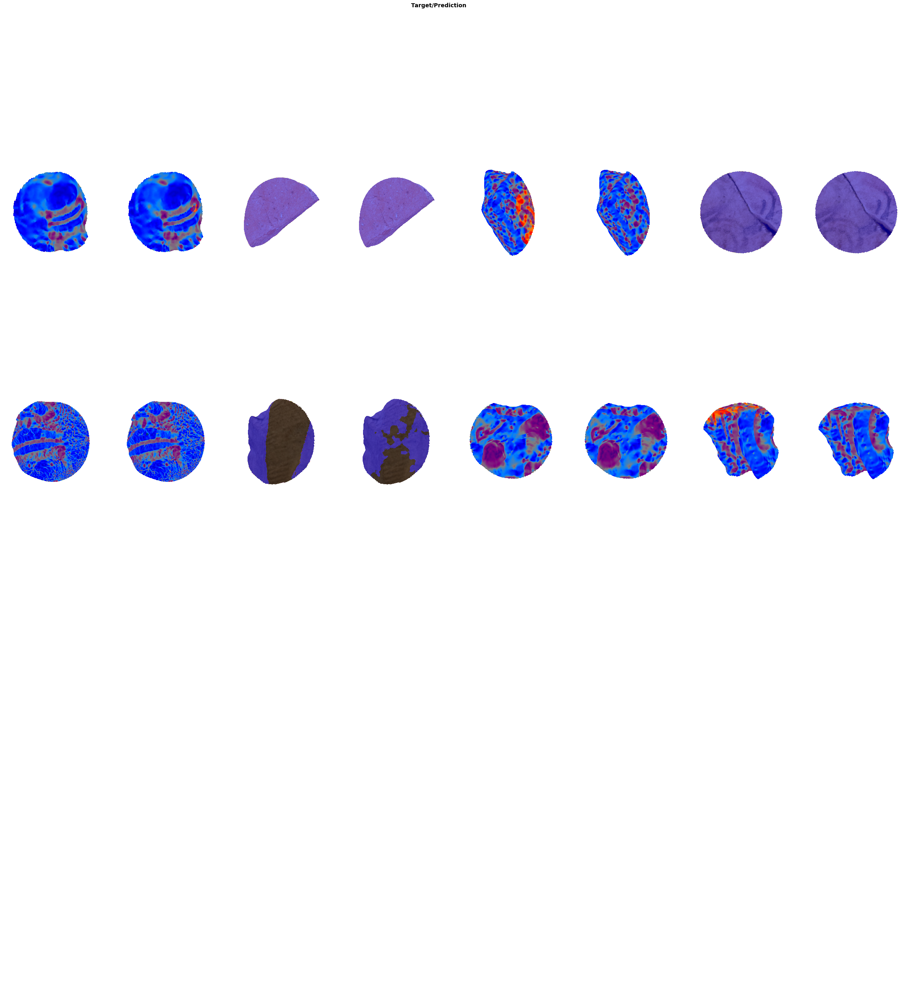

In [83]:
show_results(env, learn)

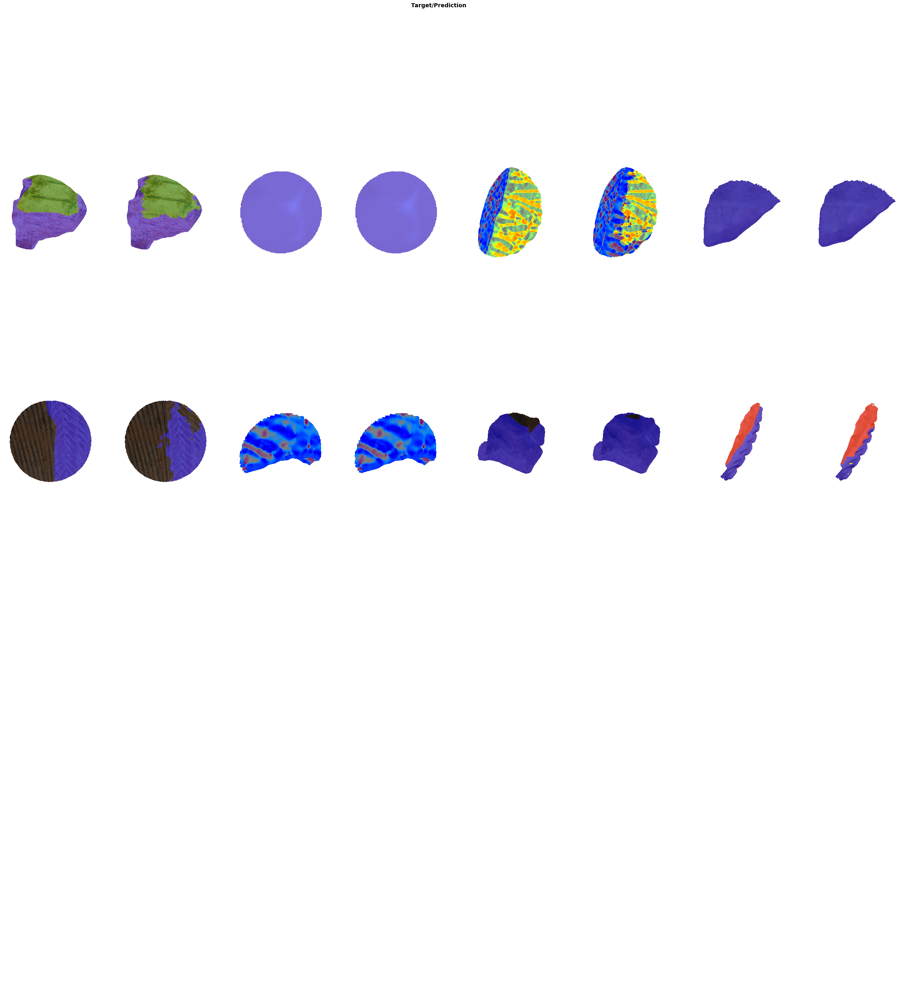

In [84]:
show_results(env, learn)

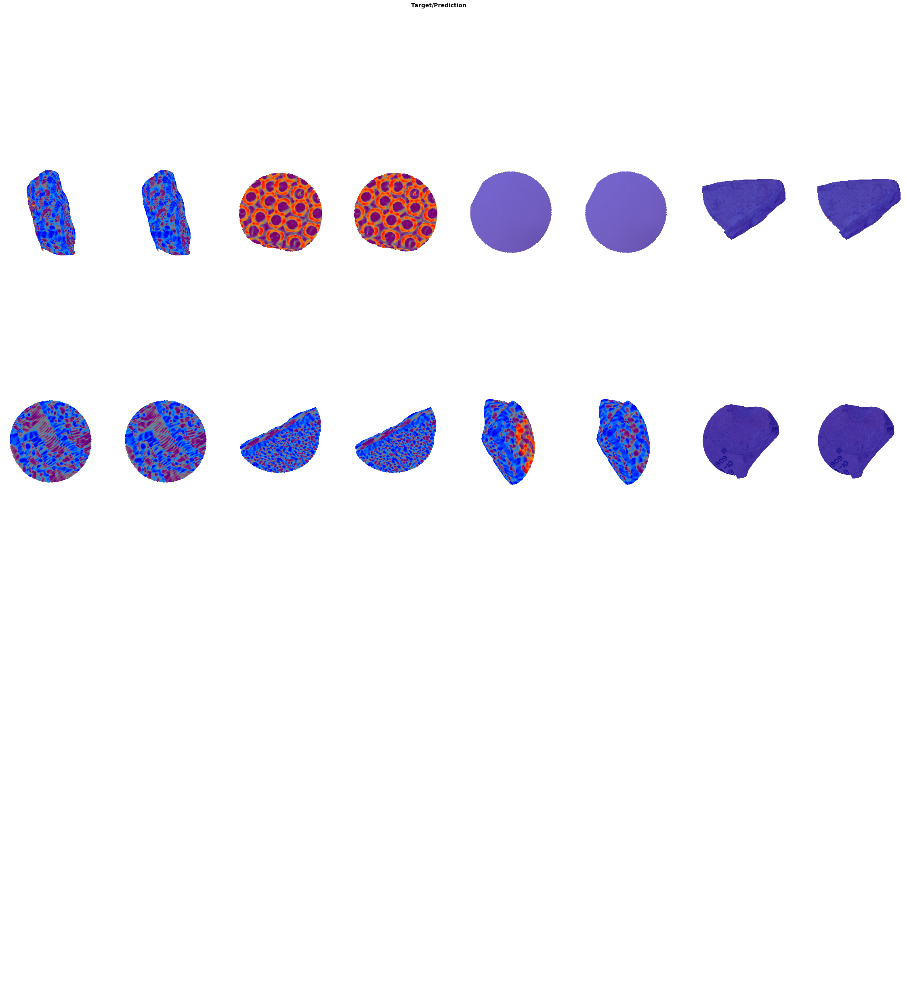

In [85]:
show_results(env, learn)

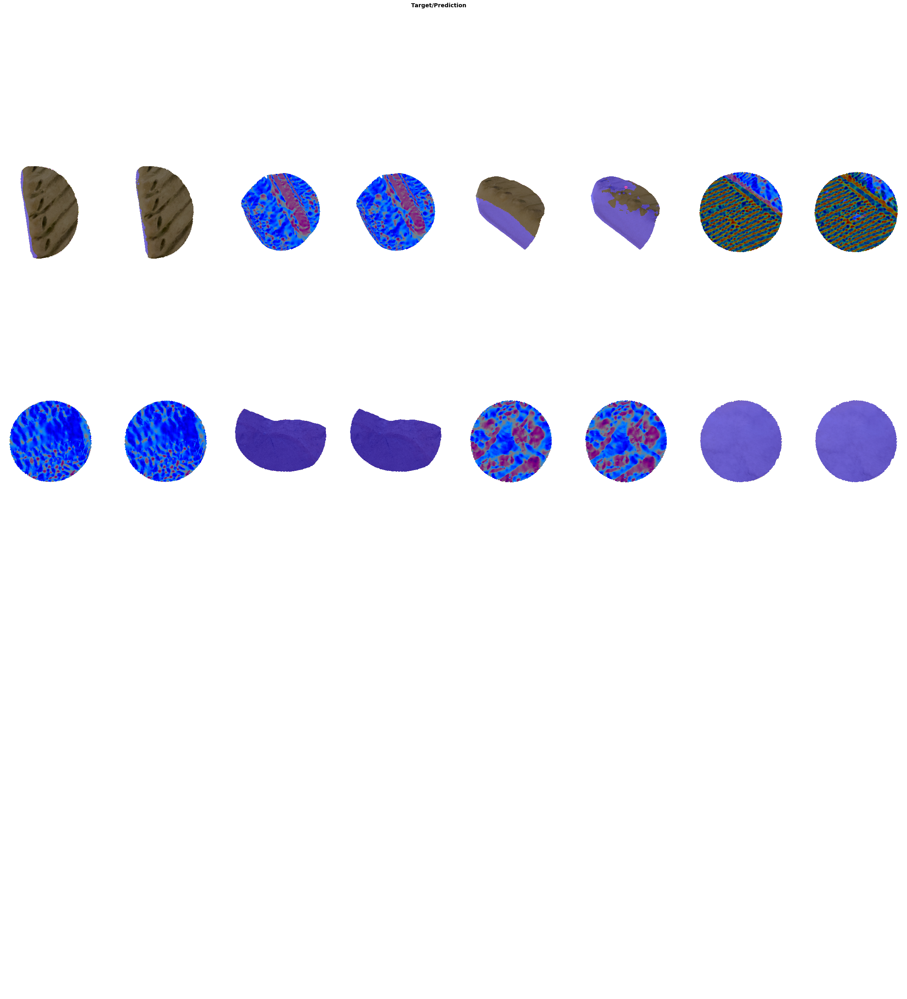

In [86]:
show_results(env, learn)

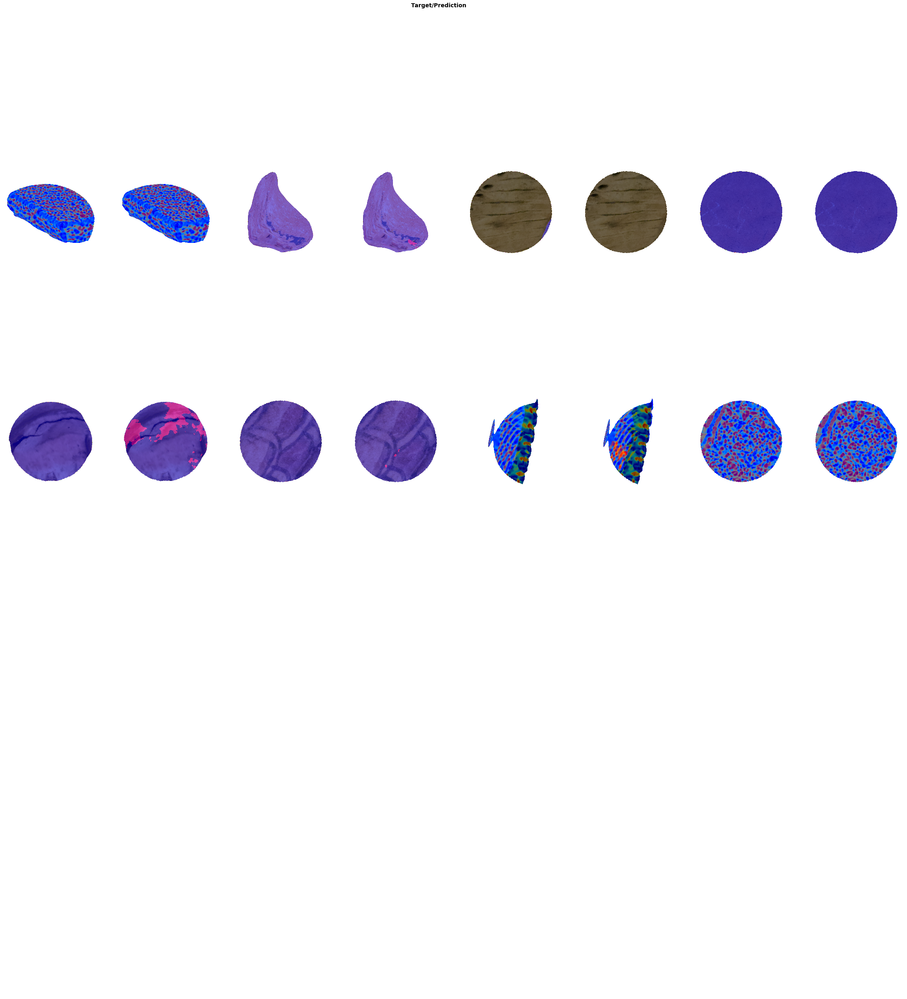

In [88]:
show_results(env, learn)

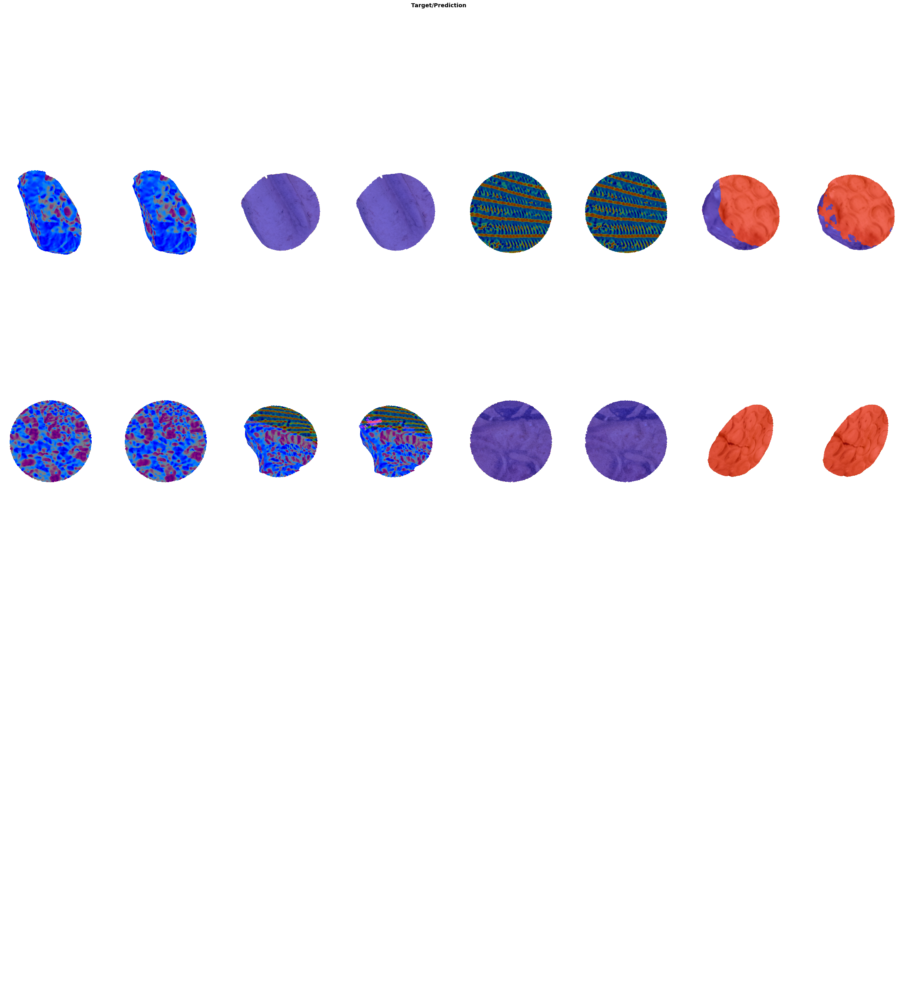

In [89]:
show_results(env, learn)

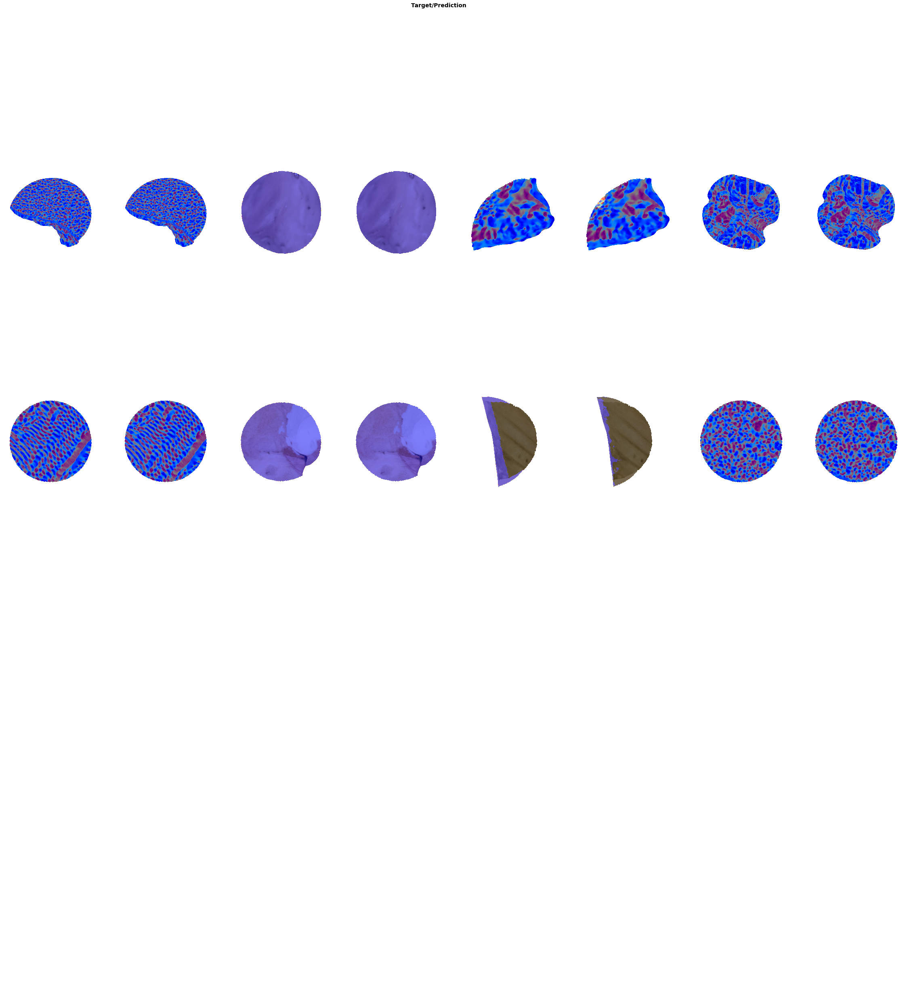

In [90]:
show_results(env, learn)

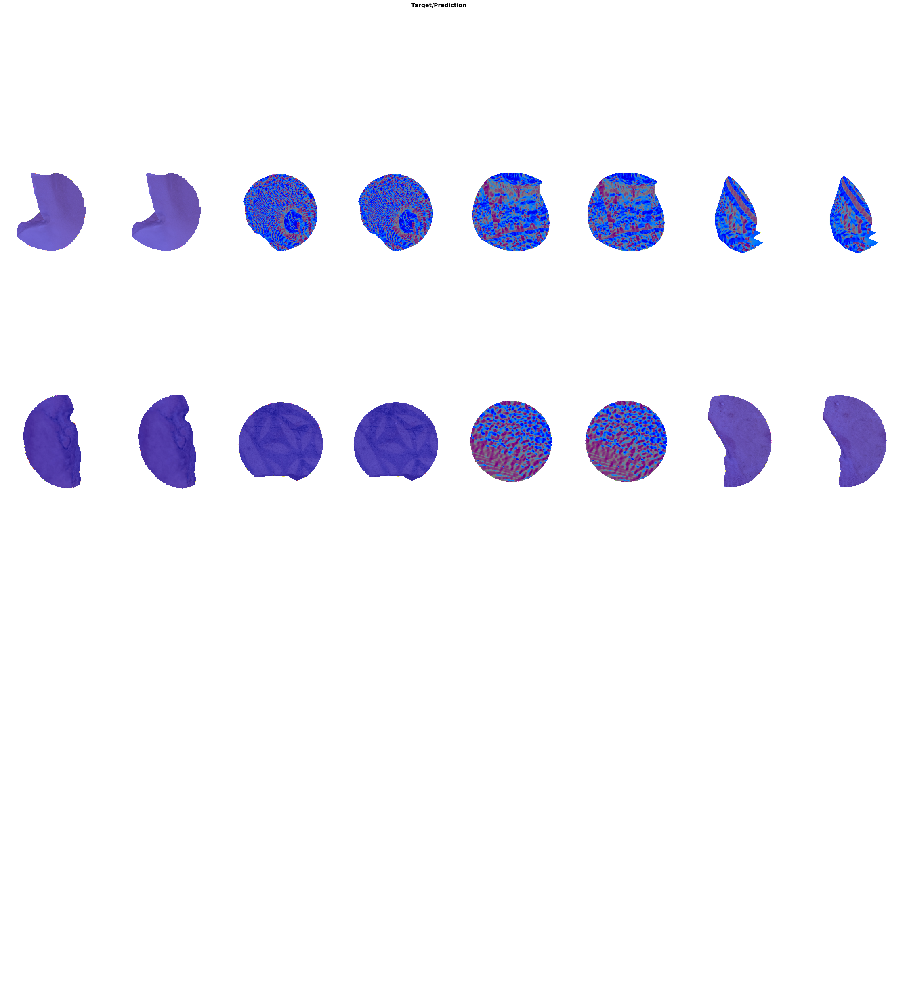

In [91]:
show_results(env, learn)

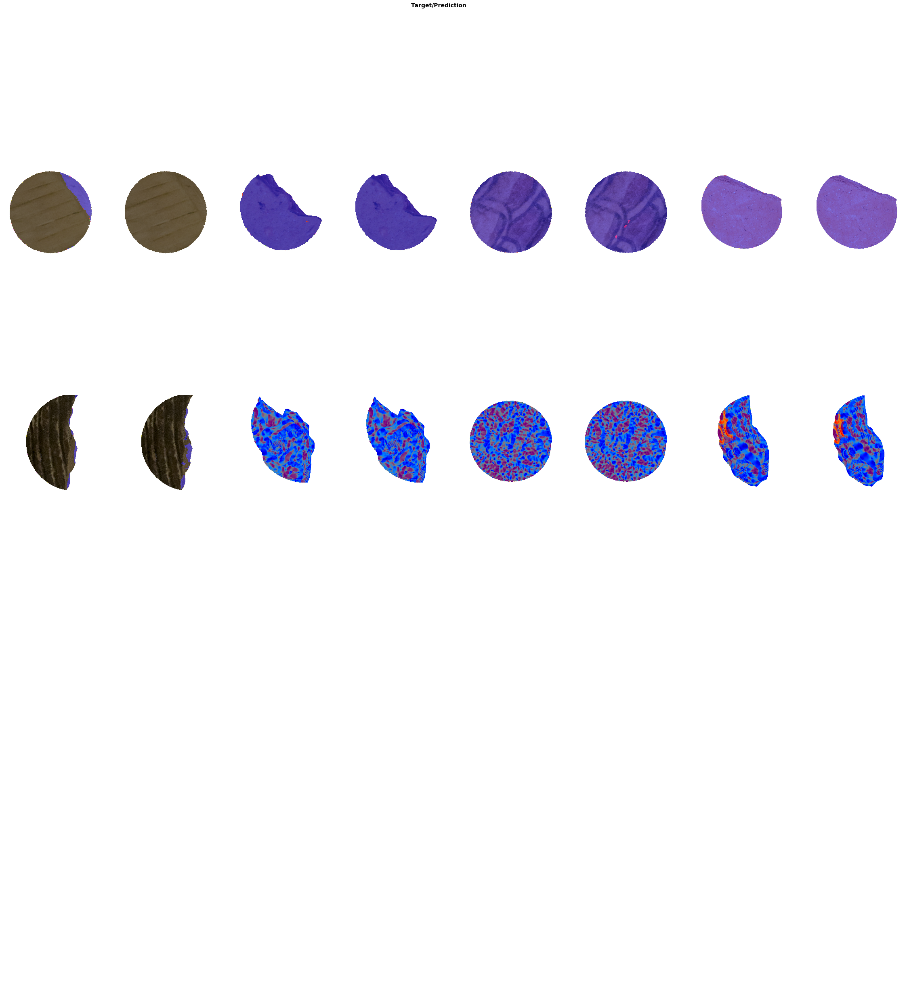

In [93]:
show_results(env, learn)

# Strong Data Aug

Setting-up type transforms pipelines
Found 3642 items
2 datasets of sizes 2580,1062
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/11_24-col.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1585x1502
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/11_24-col.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/masks/11_24-col.png
    applying PILBase.create gives
      PILMask mode=RGB size=1585x1502

Final sample: (PILImage mode=RGB size=1585x1502, PILMask mode=RGB size=1585x1502)


Found 3642 items
2 datasets of sizes 2

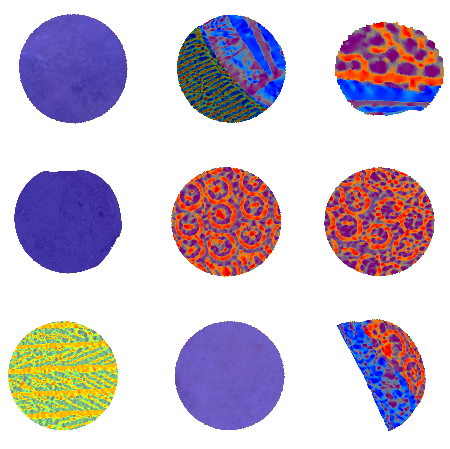

In [117]:
learn = init_learner(env)

## Round 1

-------------------------------------
Running with strong data augmentation
-------------------------------------
Setting-up type transforms pipelines
Found 3642 items
2 datasets of sizes 2580,1062
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/11_24-col.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1585x1502
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/images/11_24-col.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB+SI/training/masks/11_24-col.png
    applying PILBase.create gives
      PILMask mode=RGB size=1585x1502

Final sa

Mon Jul 19 00:42:23 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   38C    P0    36W / 250W |  31277MiB / 32510MiB |      1%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,dice_multi,time
0,0.588104,0.437494,0.011457,0.246375,13:36
1,0.466342,0.404279,0.158907,0.317248,13:23
2,0.417793,0.366226,0.198881,0.349183,13:21
3,0.389274,0.335949,0.269145,0.374903,13:13
4,0.419615,0.342608,0.263333,0.387946,13:14
5,0.393024,0.257605,0.246579,0.409958,13:02
6,0.344628,0.275443,0.298937,0.425069,13:07
7,0.345346,0.258503,0.367033,0.510982,13:13
8,0.334457,0.244469,0.277368,0.447505,13:10
9,0.330501,0.222663,0.396948,0.549614,13:13


Better model found at epoch 0 with valid_loss value: 0.43749386072158813.
Better model found at epoch 0 with valid_loss value: 0.43749386072158813.


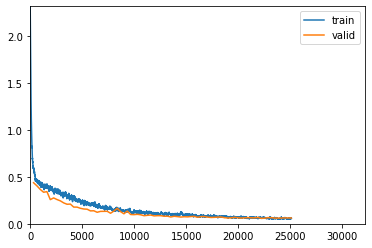

Better model found at epoch 1 with valid_loss value: 0.4042789936065674.
Better model found at epoch 1 with valid_loss value: 0.4042789936065674.
Better model found at epoch 2 with valid_loss value: 0.36622563004493713.
Better model found at epoch 2 with valid_loss value: 0.36622563004493713.
Better model found at epoch 3 with valid_loss value: 0.3359489440917969.
Better model found at epoch 3 with valid_loss value: 0.3359489440917969.
Better model found at epoch 5 with valid_loss value: 0.257604718208313.
Better model found at epoch 5 with valid_loss value: 0.257604718208313.
Better model found at epoch 8 with valid_loss value: 0.244468554854393.
Better model found at epoch 8 with valid_loss value: 0.244468554854393.
Better model found at epoch 9 with valid_loss value: 0.22266310453414917.
Better model found at epoch 9 with valid_loss value: 0.22266310453414917.
Better model found at epoch 10 with valid_loss value: 0.20819497108459473.
Better model found at epoch 10 with valid_loss va

Looking for SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-07-16_16.13.07-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-strong-data-aug-img_size-1585-1585-1a-2021-07-16_17.10.15-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-1e-07-1e-06-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-basic-data-aug-img_size-1585-1585-1a-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/not

0 - valid_loss = 0.05802430585026741
1 - AvgMetric = 0.6387264132499695
2 - DiceMulti = 0.8960506429961341
LR_finding in parallel_ctx context on GPU [0, 1]


Mon Jul 19 19:18:59 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   42C    P0    37W / 250W |  31277MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,dice_multi,time
0,0.061858,0.058746,0.637123,0.895243,14:26
1,0.055753,0.059348,0.633745,0.895132,14:33
2,0.062635,0.063993,0.627852,0.893734,14:31
3,0.052885,0.057901,0.640322,0.896346,14:36
4,0.063622,0.060335,0.639061,0.893979,14:39
5,0.058578,0.071477,0.608866,0.882324,14:58
6,0.055257,0.060398,0.641223,0.893254,14:41
7,0.058071,0.060488,0.639485,0.894891,14:24
8,0.057855,0.058305,0.646112,0.896092,14:25
9,0.059264,0.058849,0.648349,0.896009,14:27


Better model found at epoch 0 with valid_loss value: 0.058745674788951874.
Better model found at epoch 0 with valid_loss value: 0.058745674788951874.


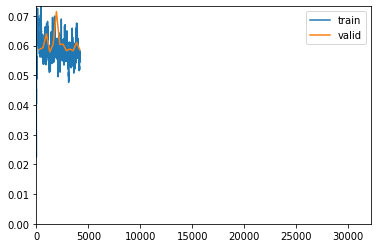

Better model found at epoch 3 with valid_loss value: 0.05790074169635773.
Better model found at epoch 3 with valid_loss value: 0.05790074169635773.
No improvement since epoch 3: early stopping
Mon Jul 19 22:43:34 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   39C    P0    37W / 250W |  31277MiB / 32510MiB |      2%      Default |
|                               |                      

Looking for SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-07-16_16.13.07-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-strong-data-aug-img_size-1585-1585-1a-2021-07-16_17.10.15-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-1e-07-1e-06-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB+SI-deeplabv3+-resnet152-basic-data-aug-img_size-1585-1585-1a-2021-07-16_18.06.06-WD-0.0001-BS-8-LR-0.0001-0.001-best.pth
/home/ranieri/not

0 - valid_loss = 0.05790962278842926
1 - AvgMetric = 0.6402916312217712
2 - DiceMulti = 0.8963313608553807


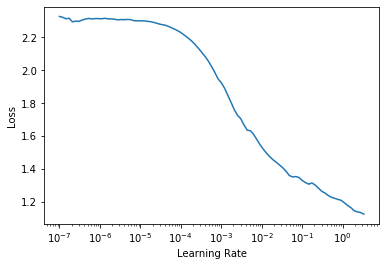

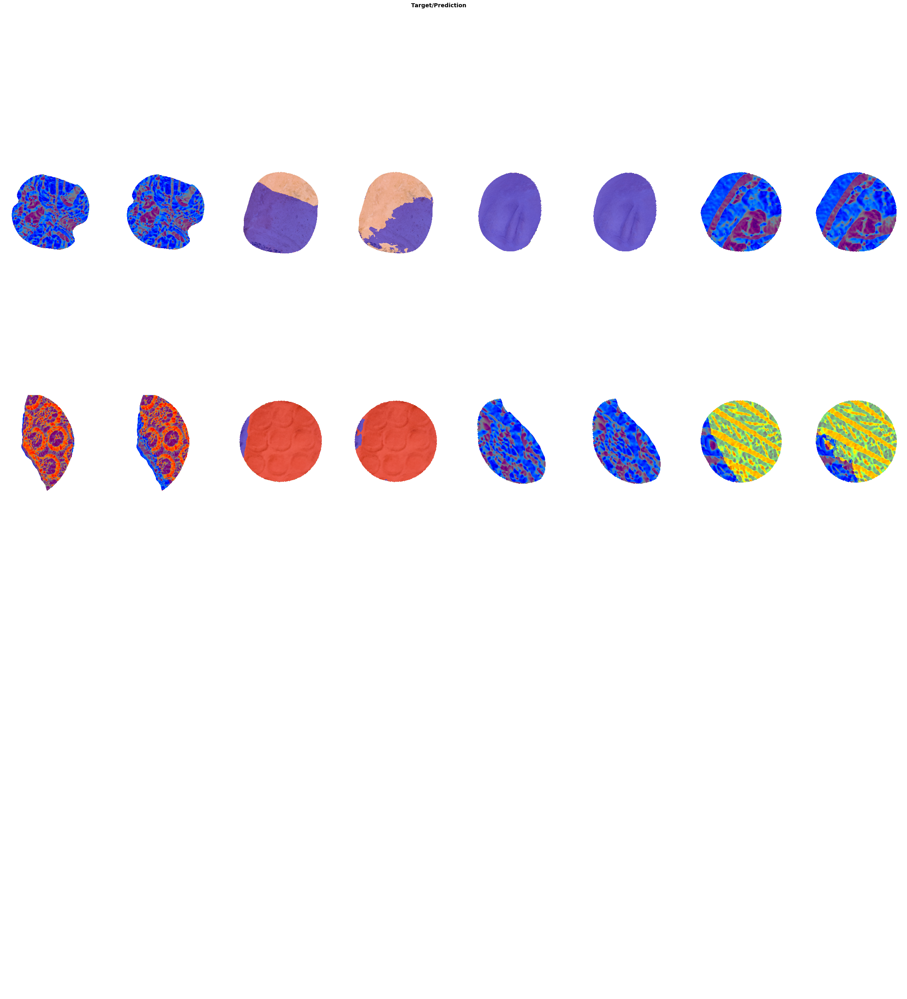

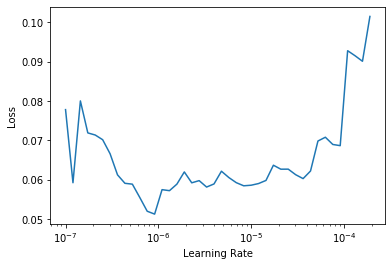

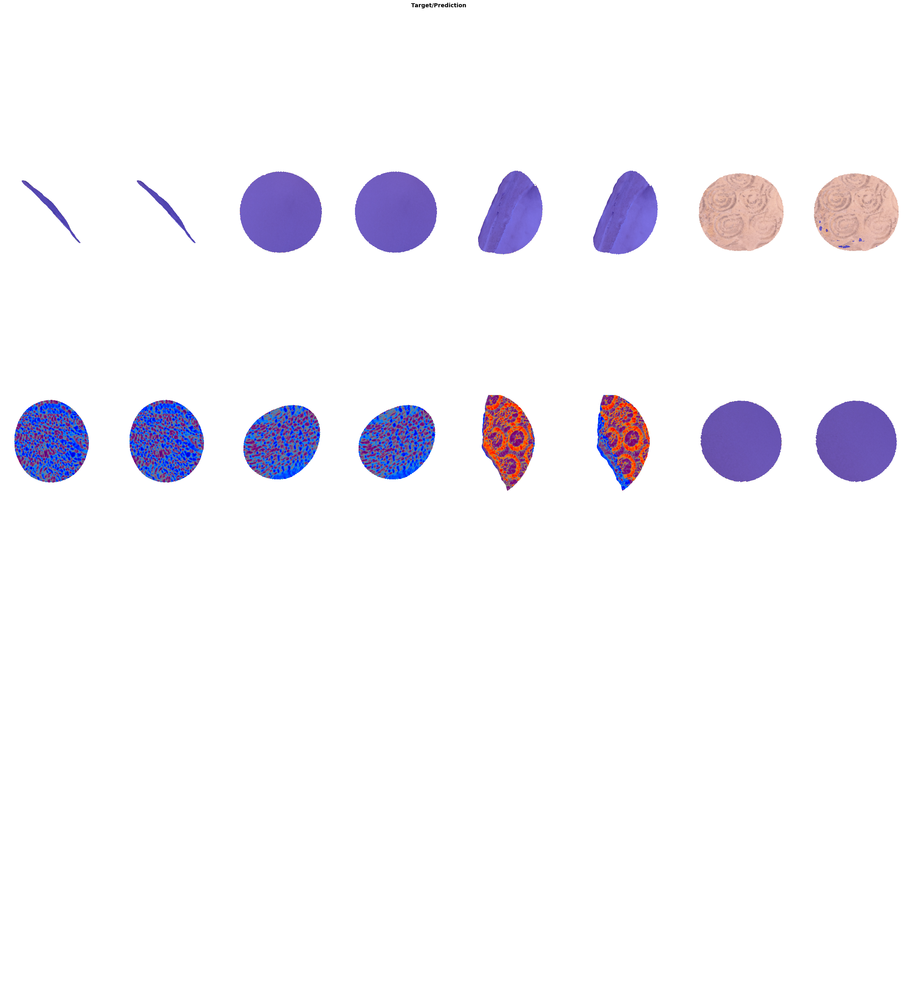

In [118]:
env['train_round']       = 0
env['data-augmentation'] = 'strong-data-aug'
do_training_round(env, learn, epochs=100)

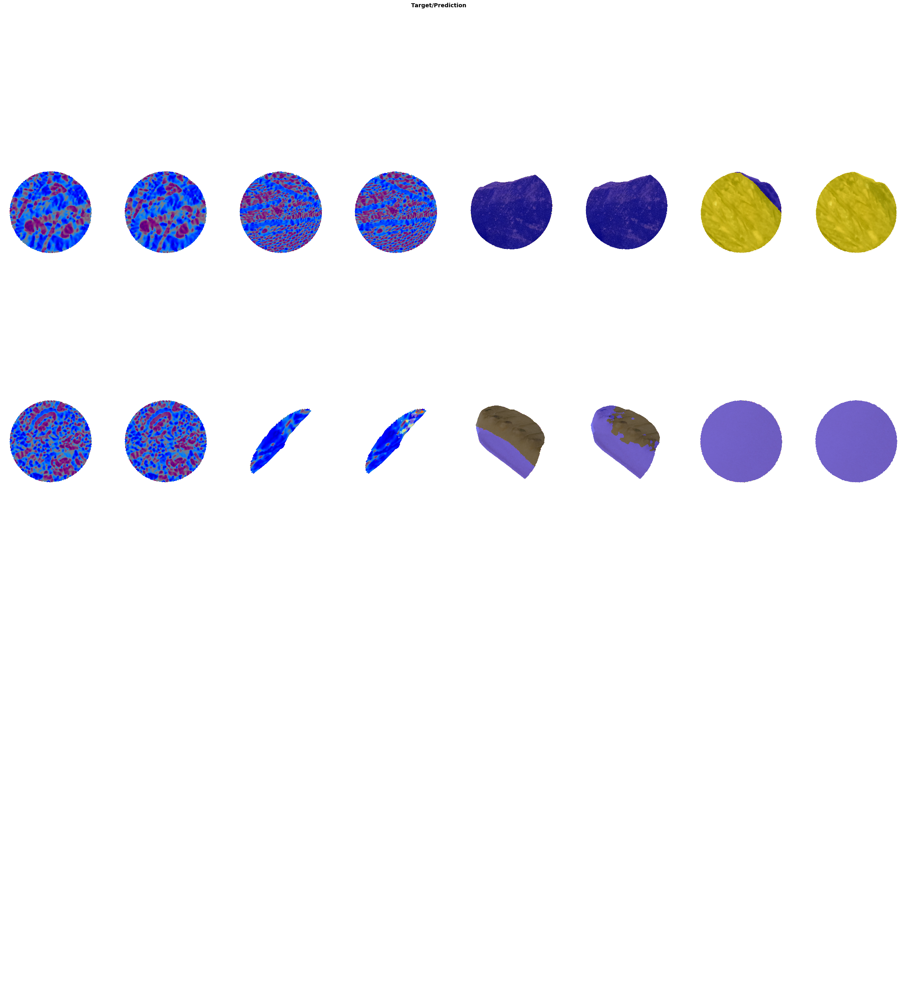

In [119]:
show_results(env, learn)

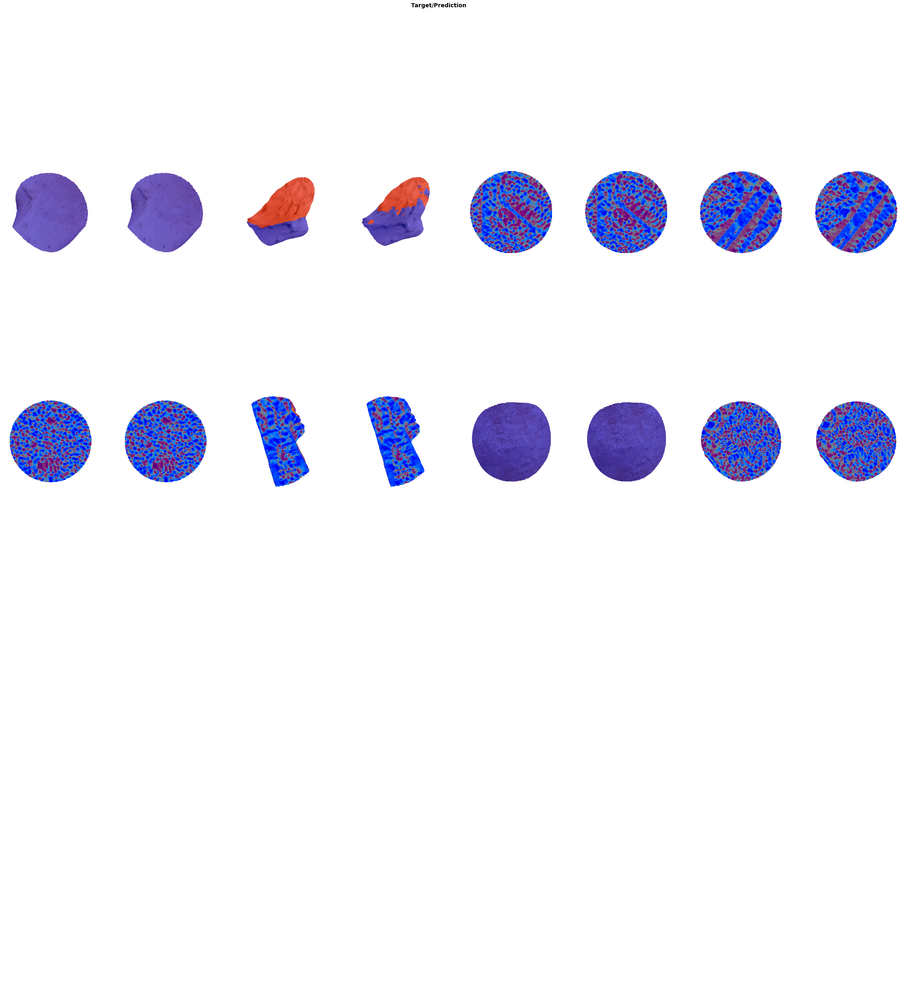

In [120]:
show_results(env, learn)

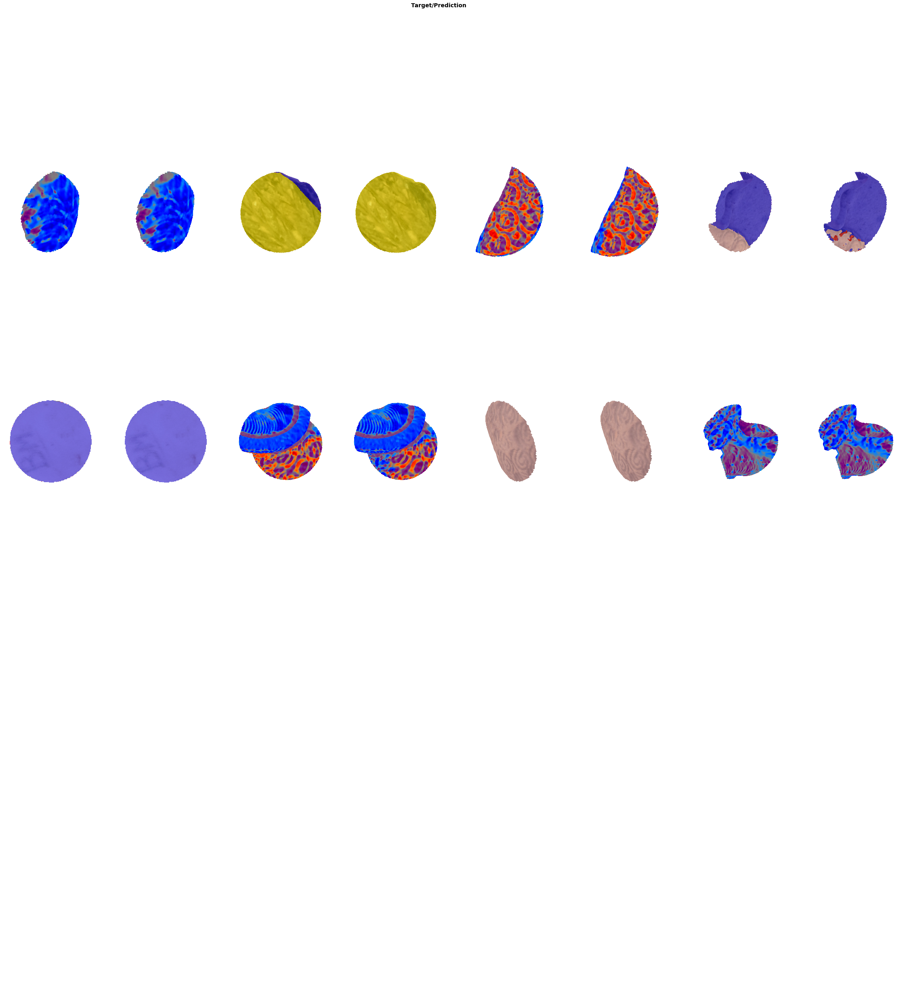

In [121]:
show_results(env, learn)

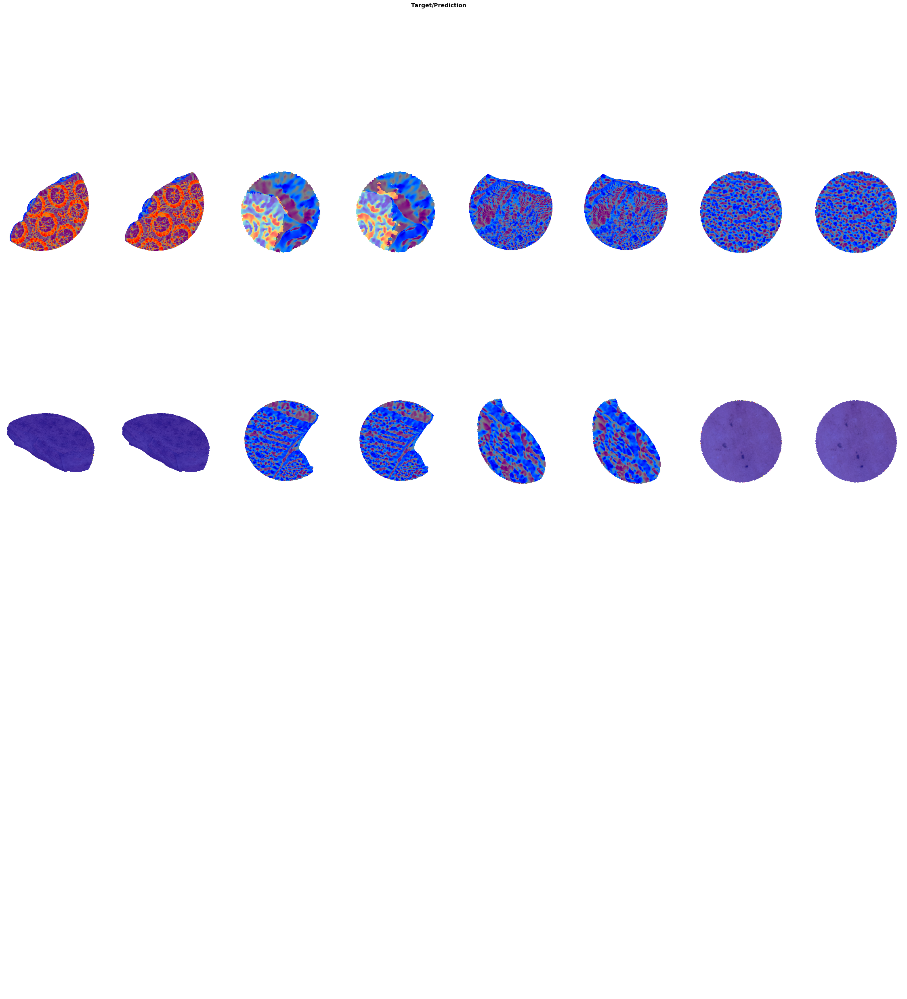

In [122]:
show_results(env, learn)

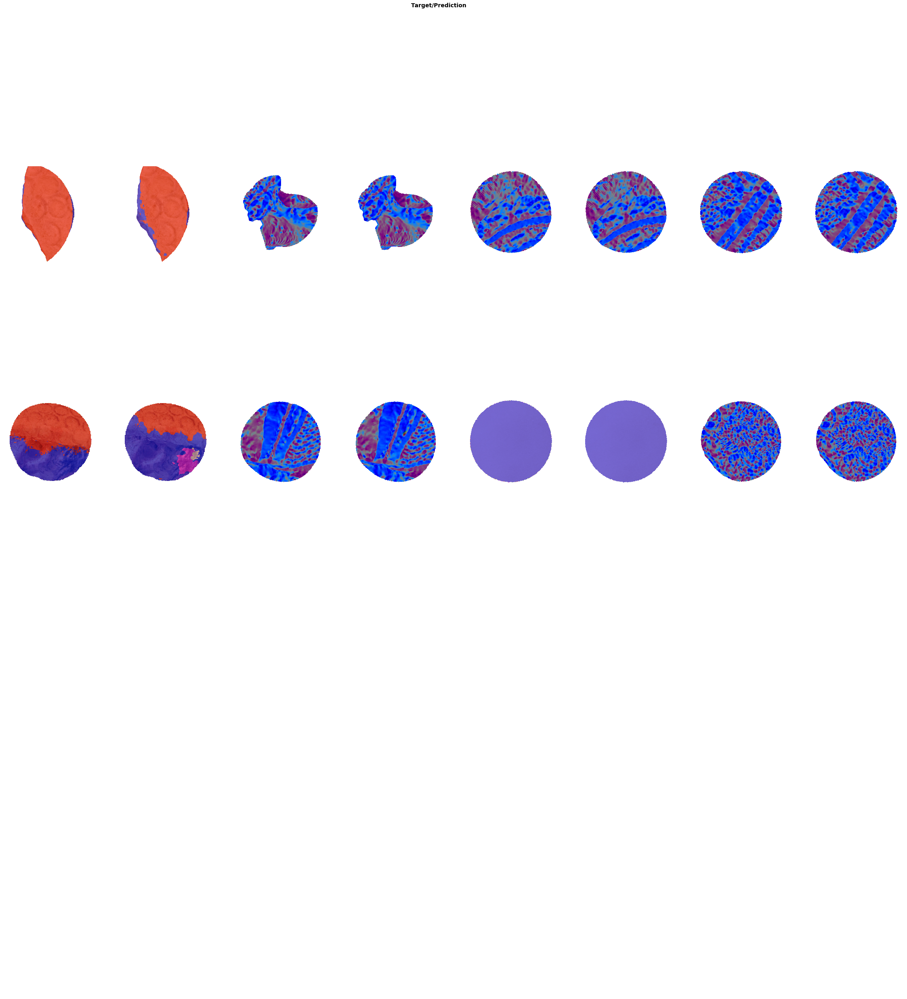

In [123]:
show_results(env, learn)

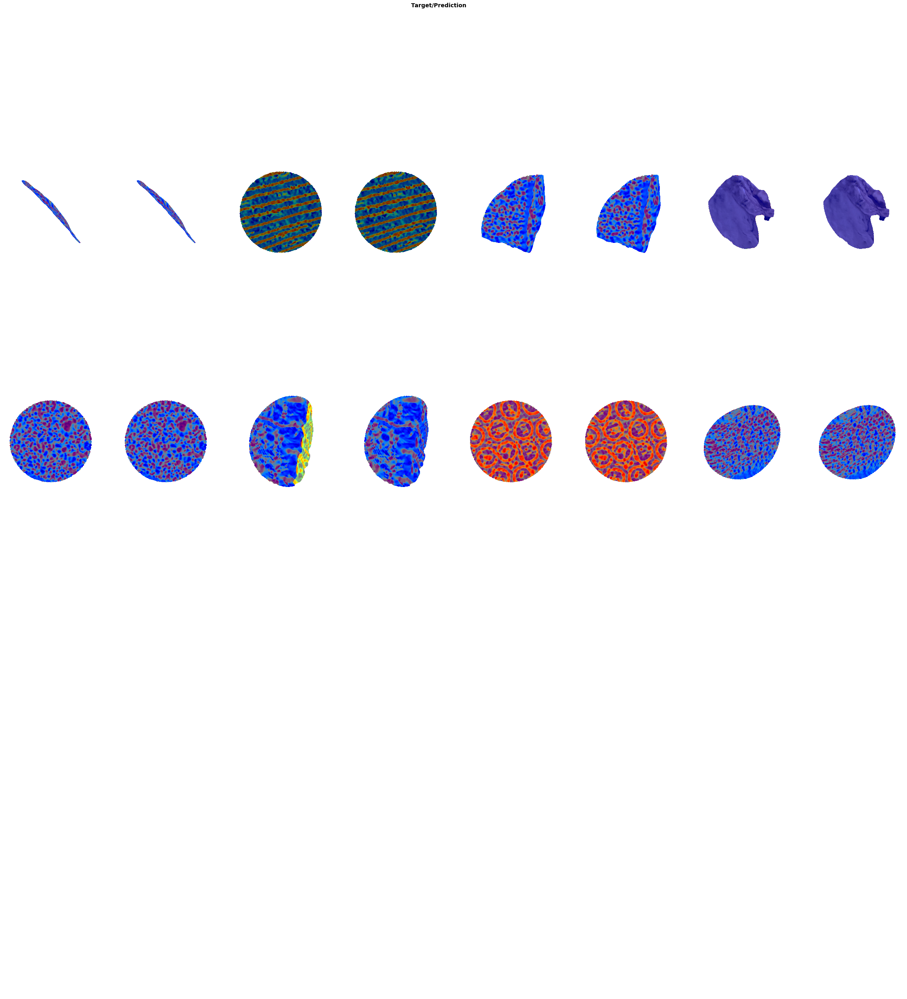

In [124]:
show_results(env, learn)

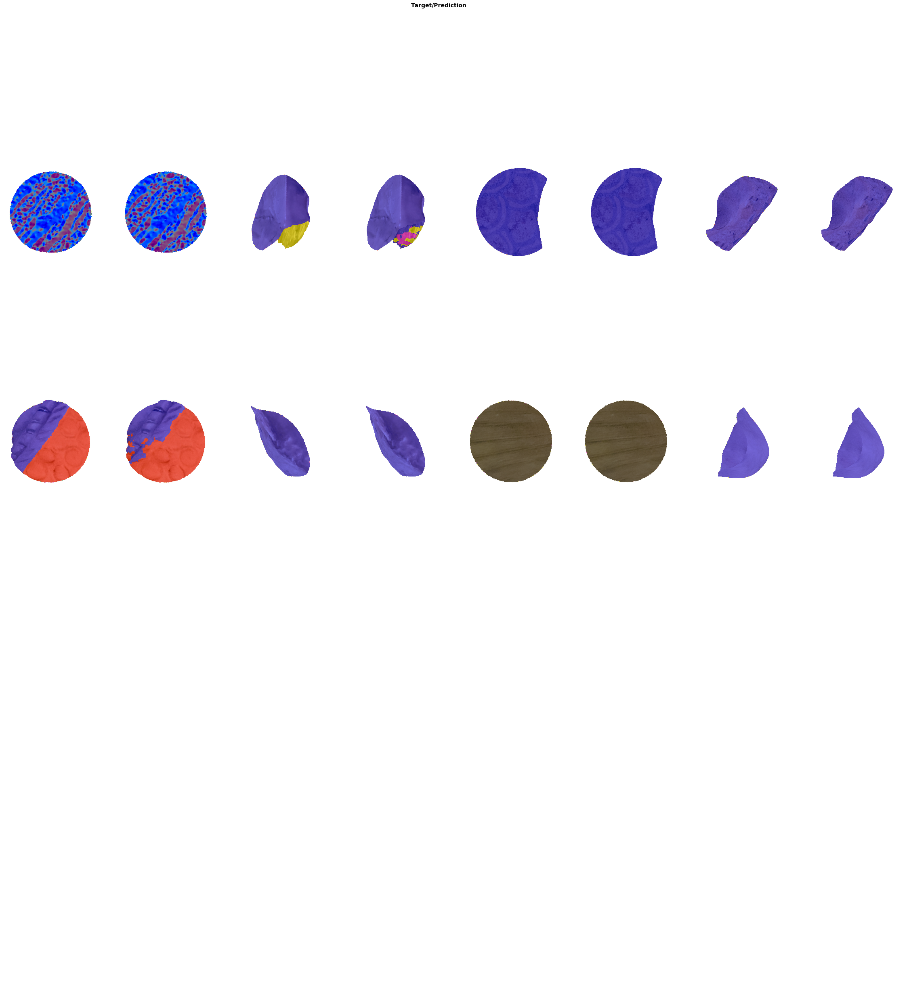

In [125]:
show_results(env, learn)

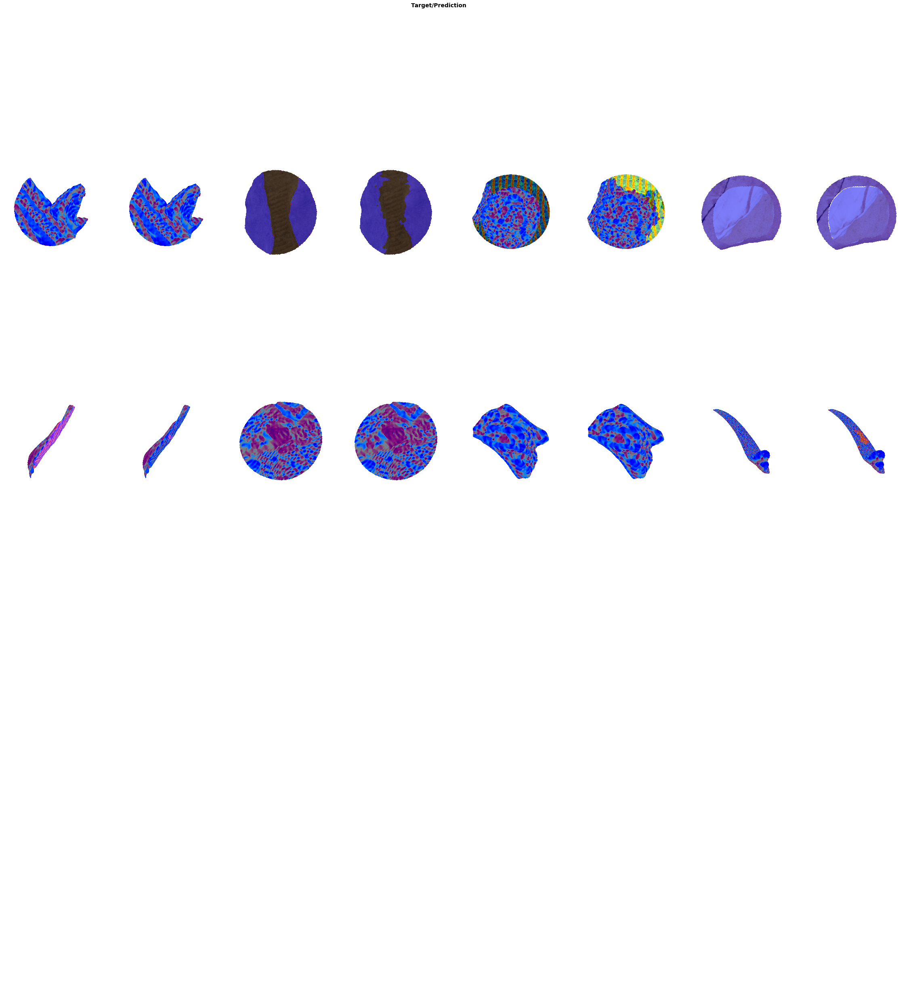

In [126]:
show_results(env, learn)

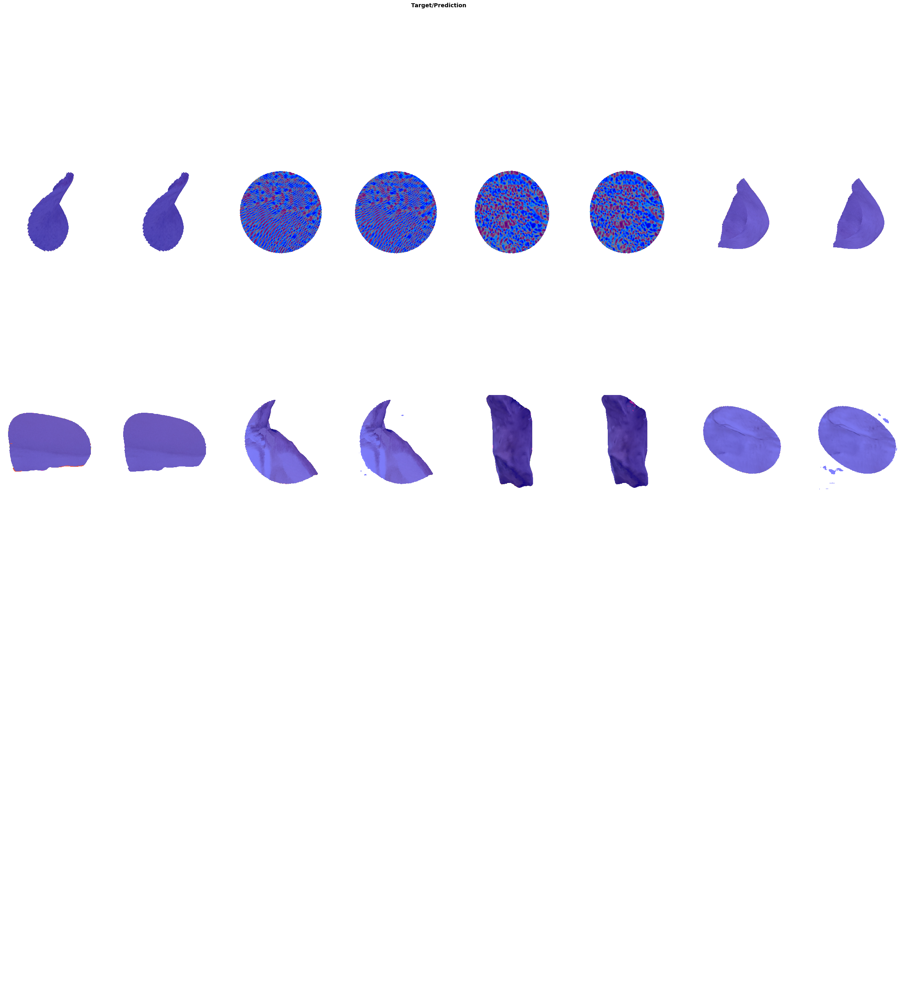

In [127]:
show_results(env, learn)

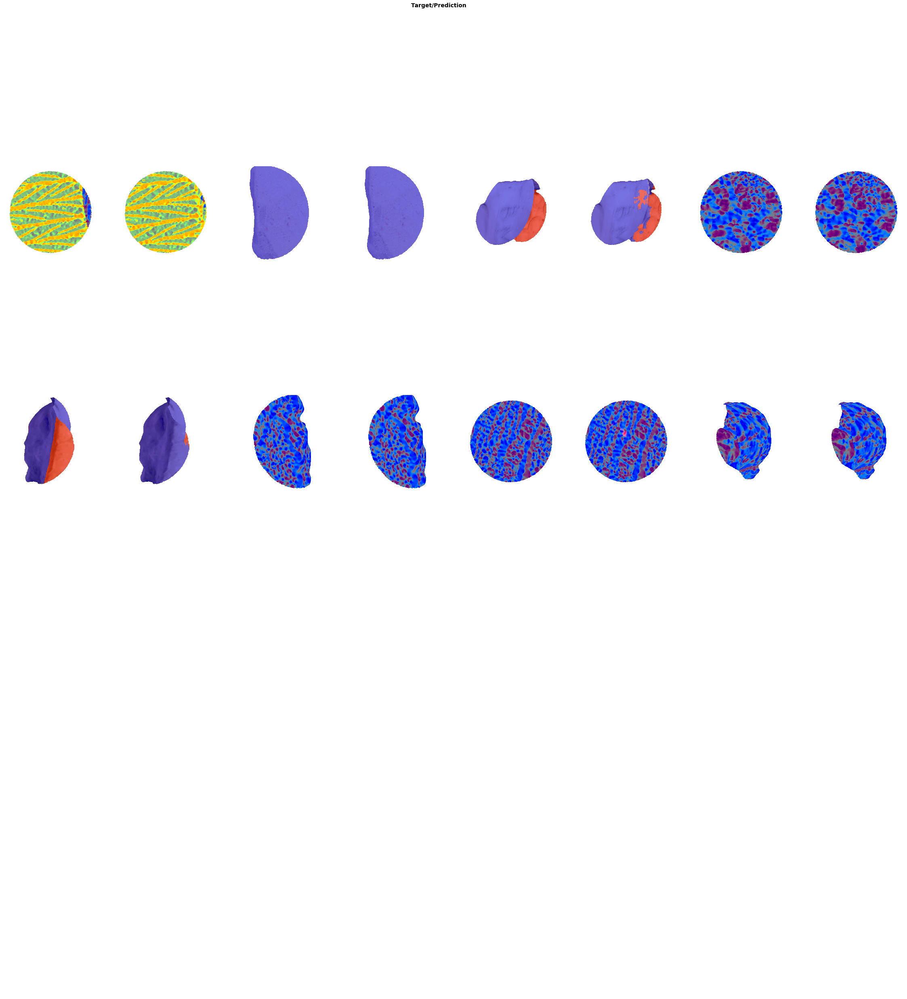

In [128]:
show_results(env, learn)

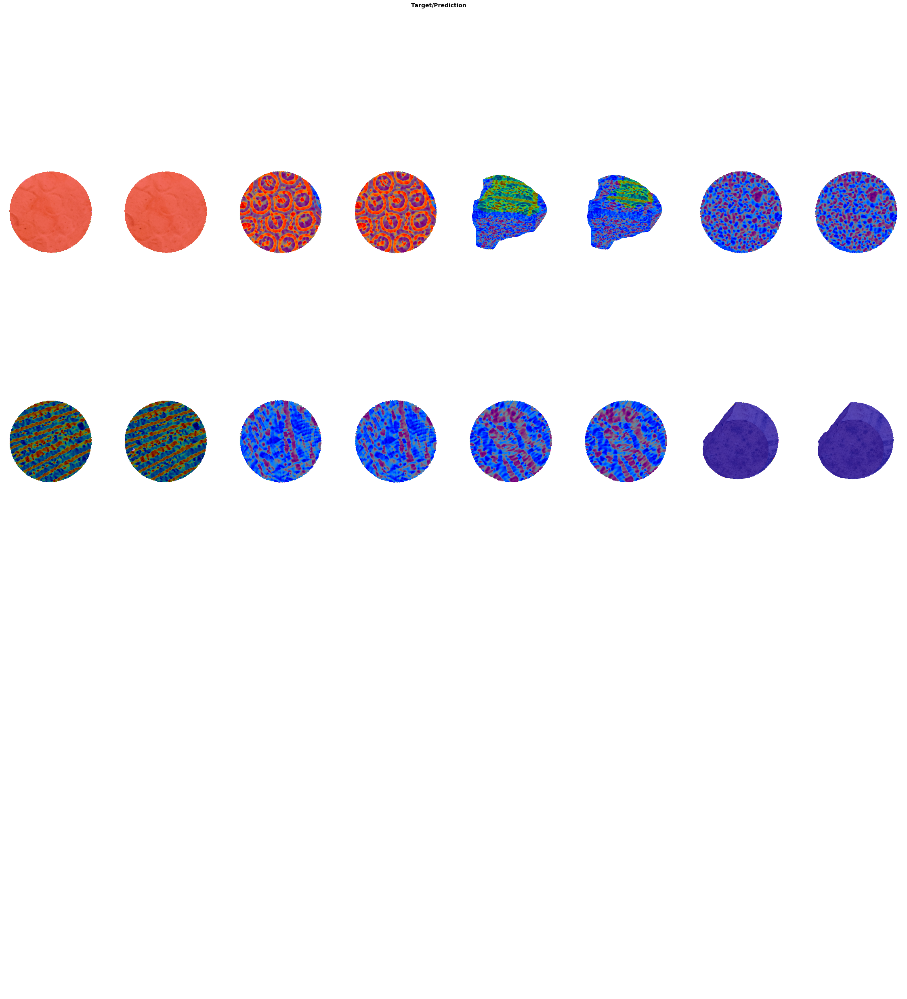

In [129]:
show_results(env, learn)

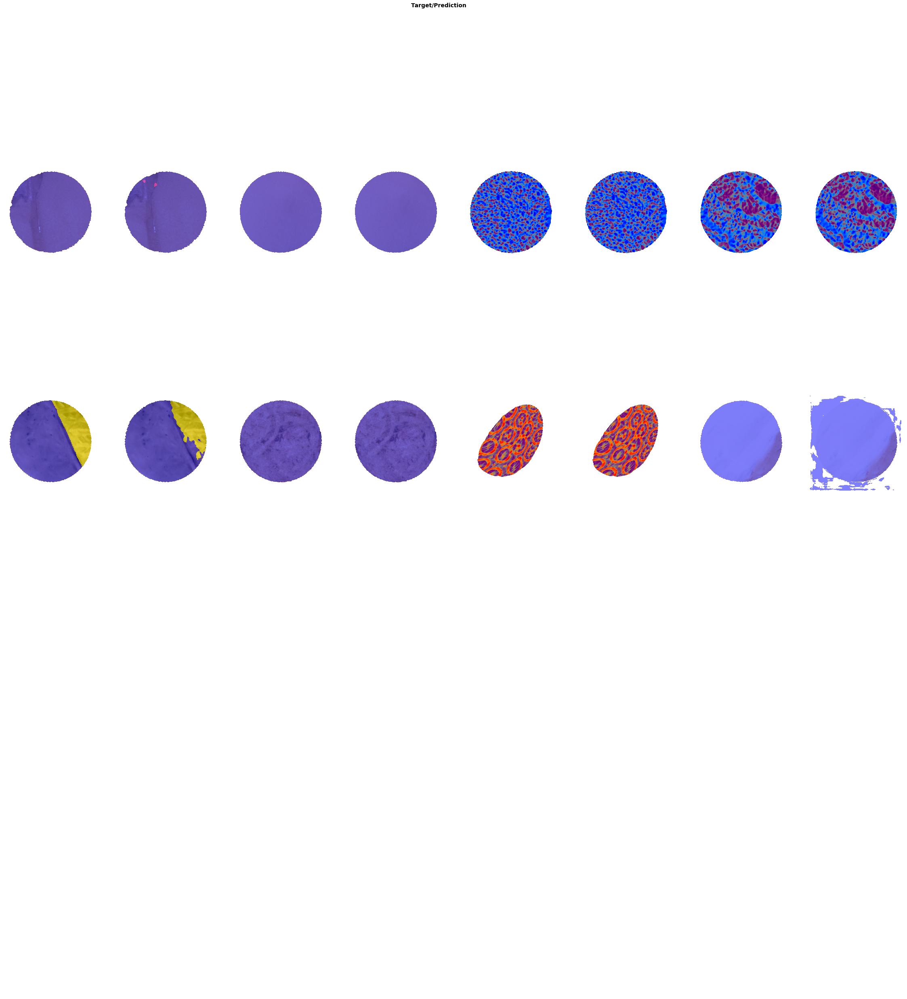

In [130]:
show_results(env, learn)

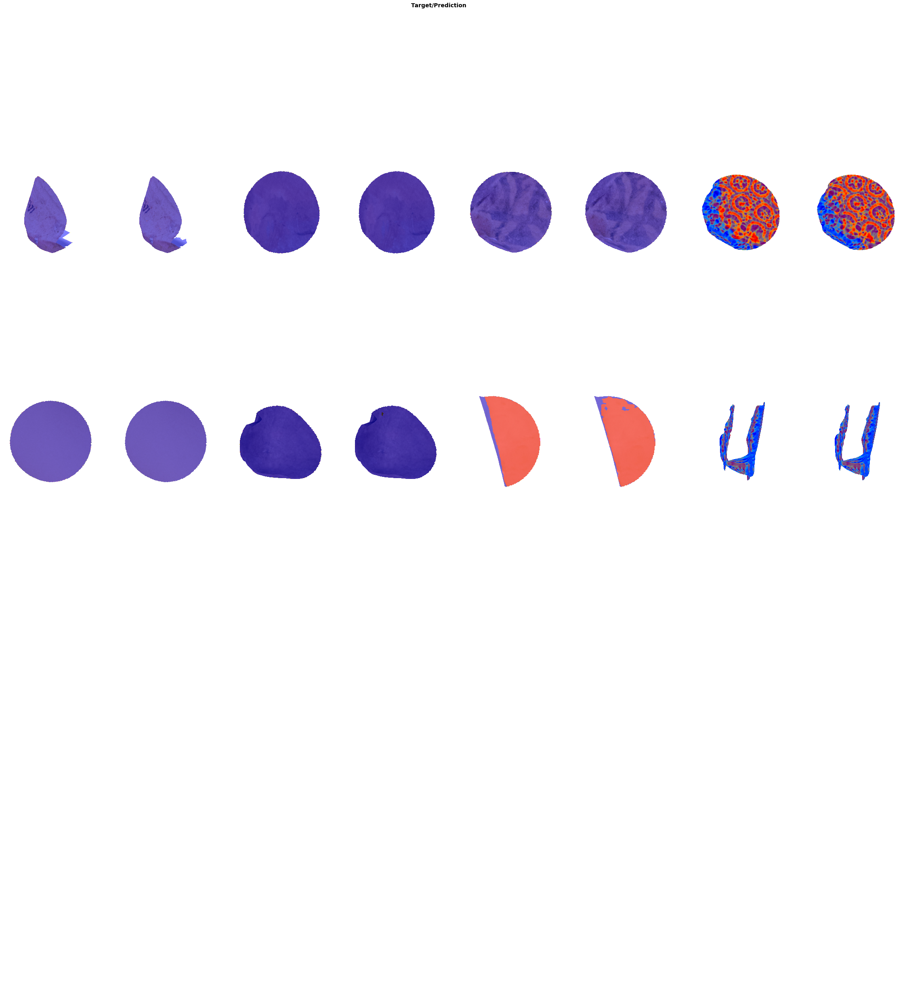

In [131]:
show_results(env, learn)

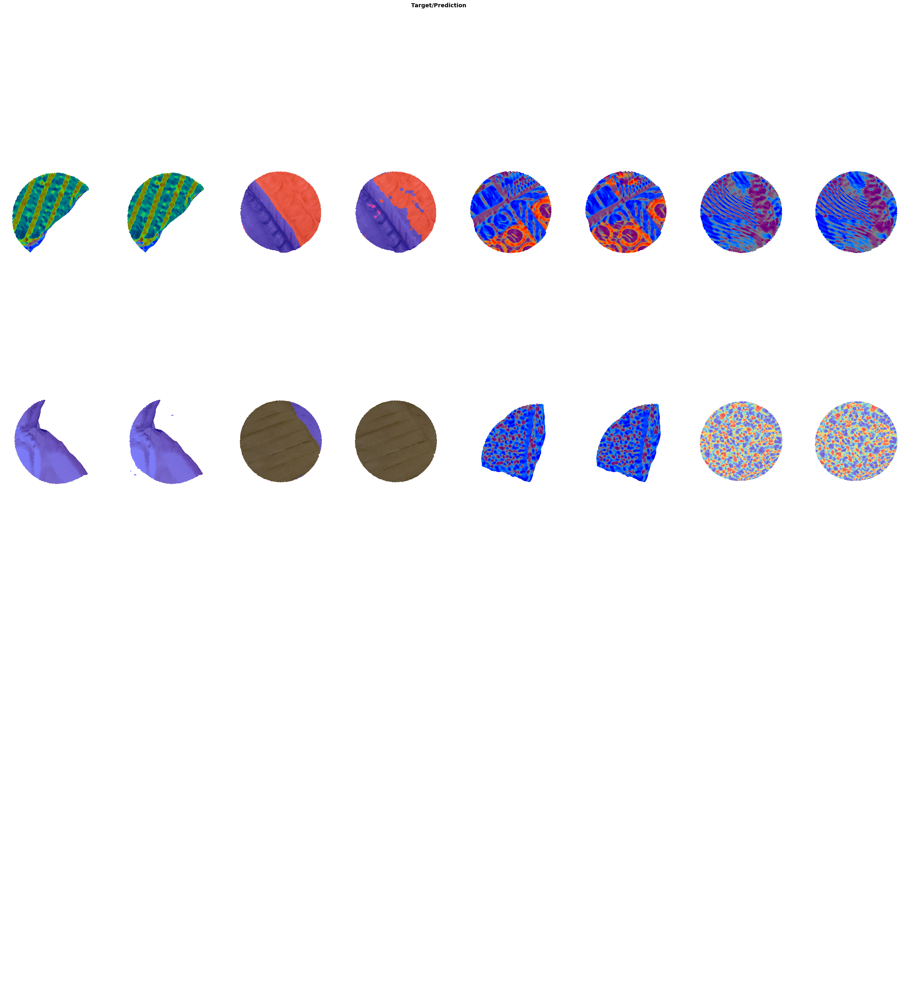

In [132]:
show_results(env, learn)

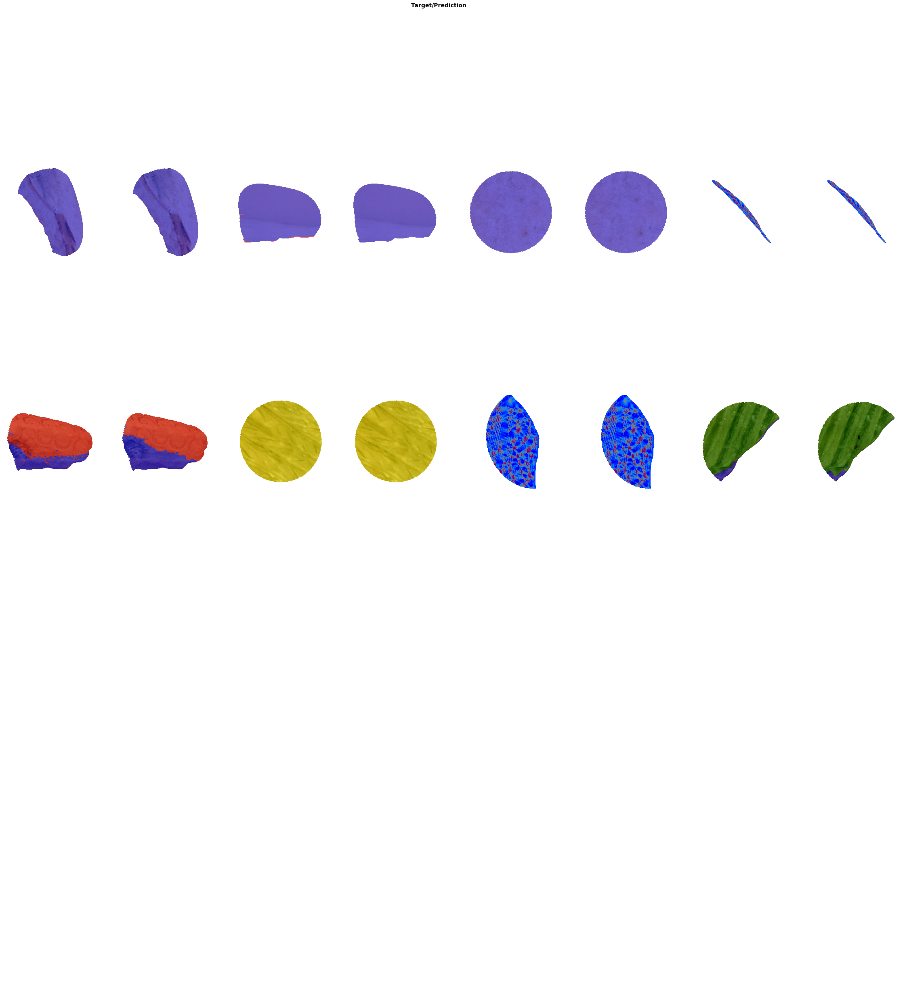

In [133]:
show_results(env, learn)

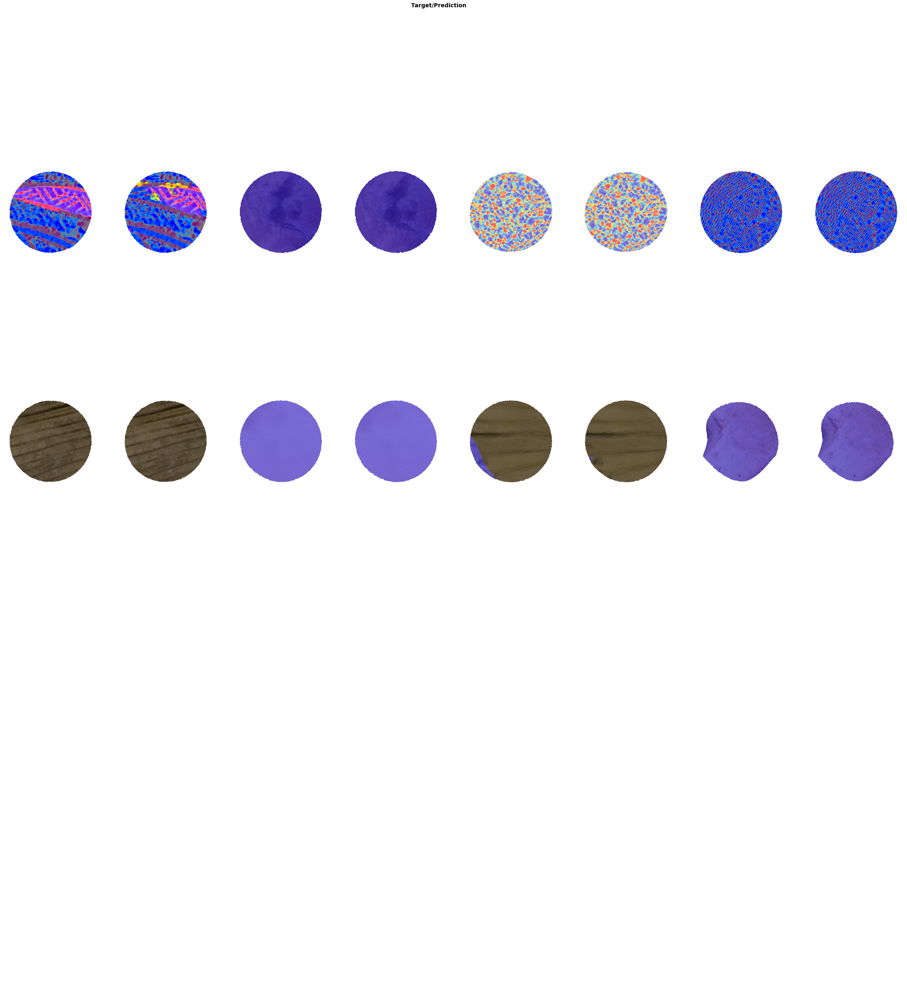

In [134]:
show_results(env, learn)

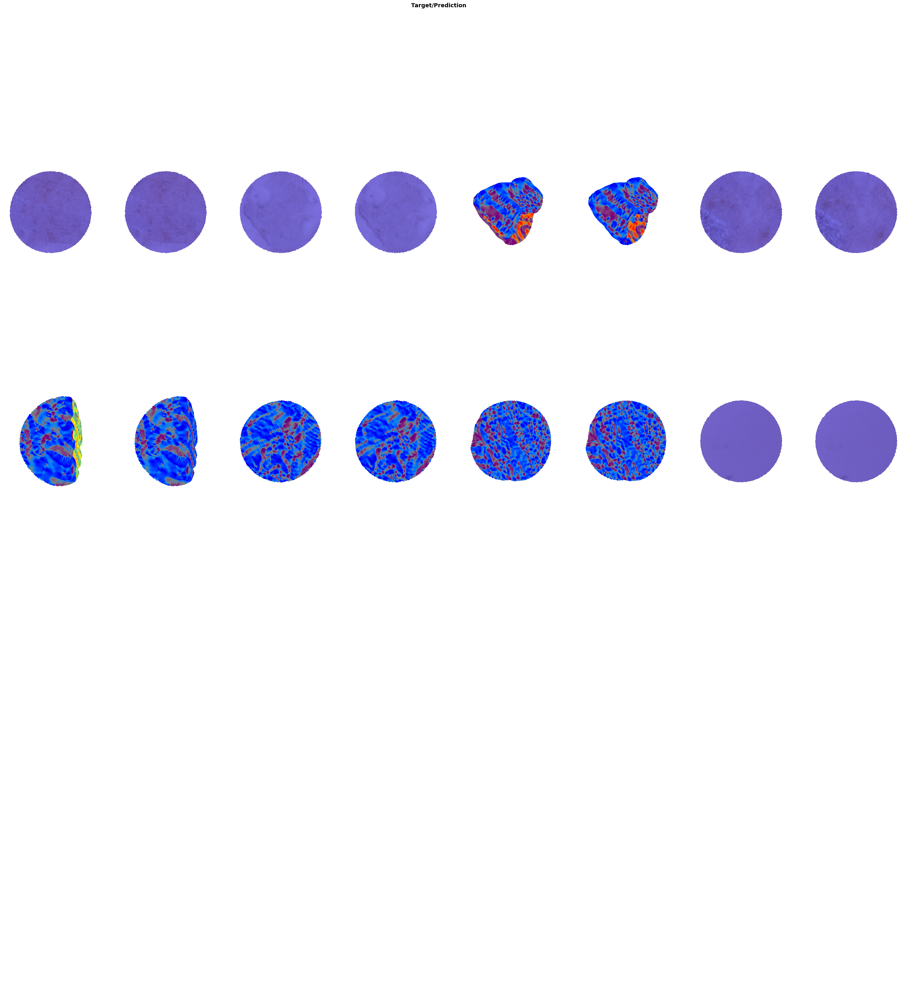

In [135]:
show_results(env, learn)

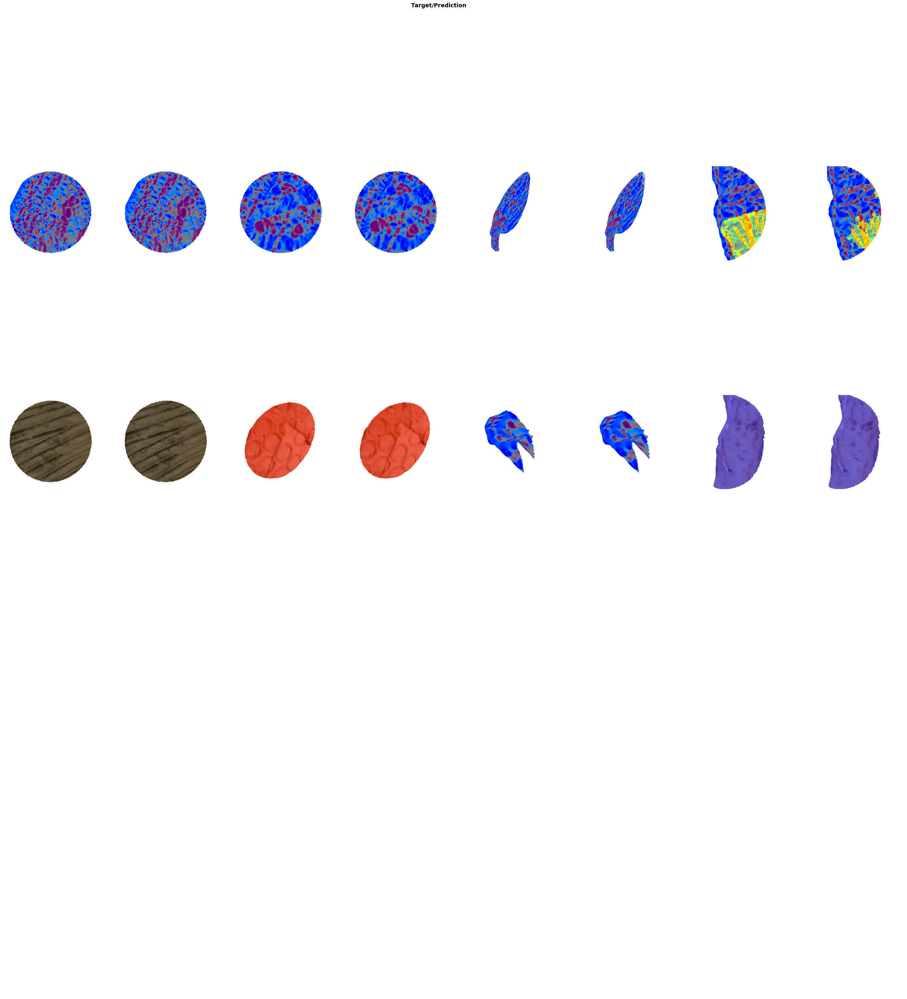

In [136]:
show_results(env, learn)

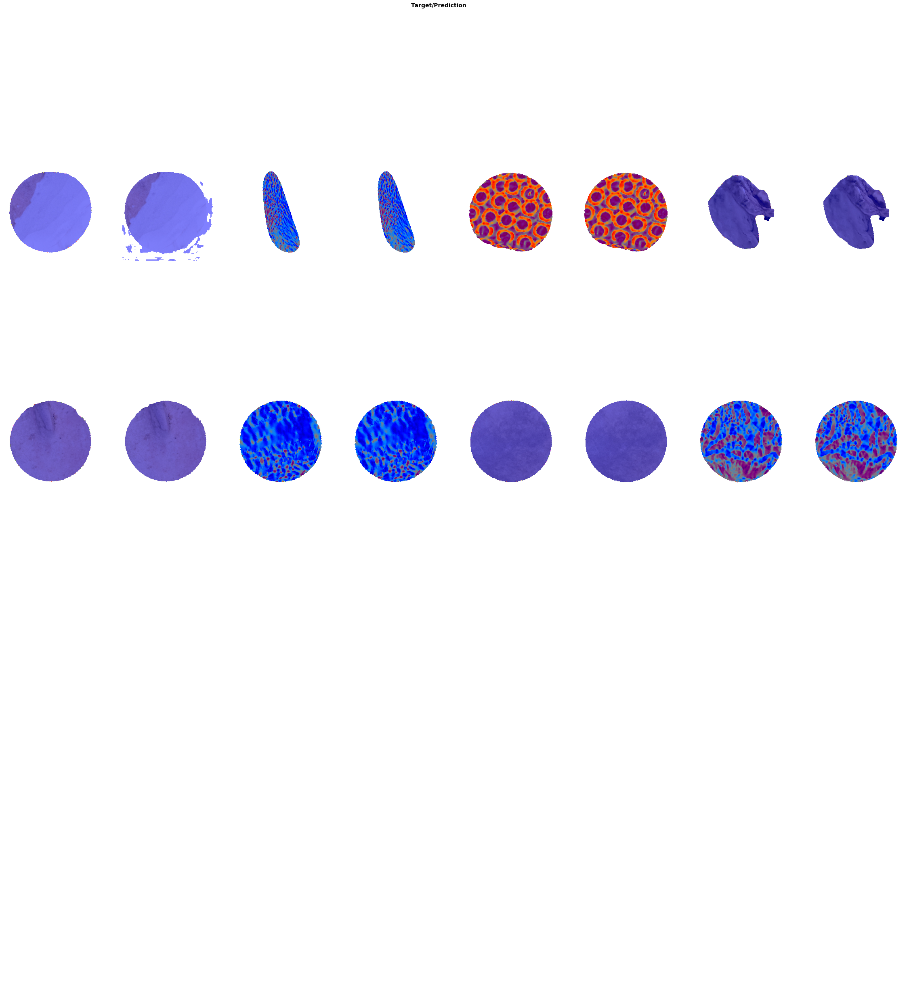

In [137]:
show_results(env, learn)

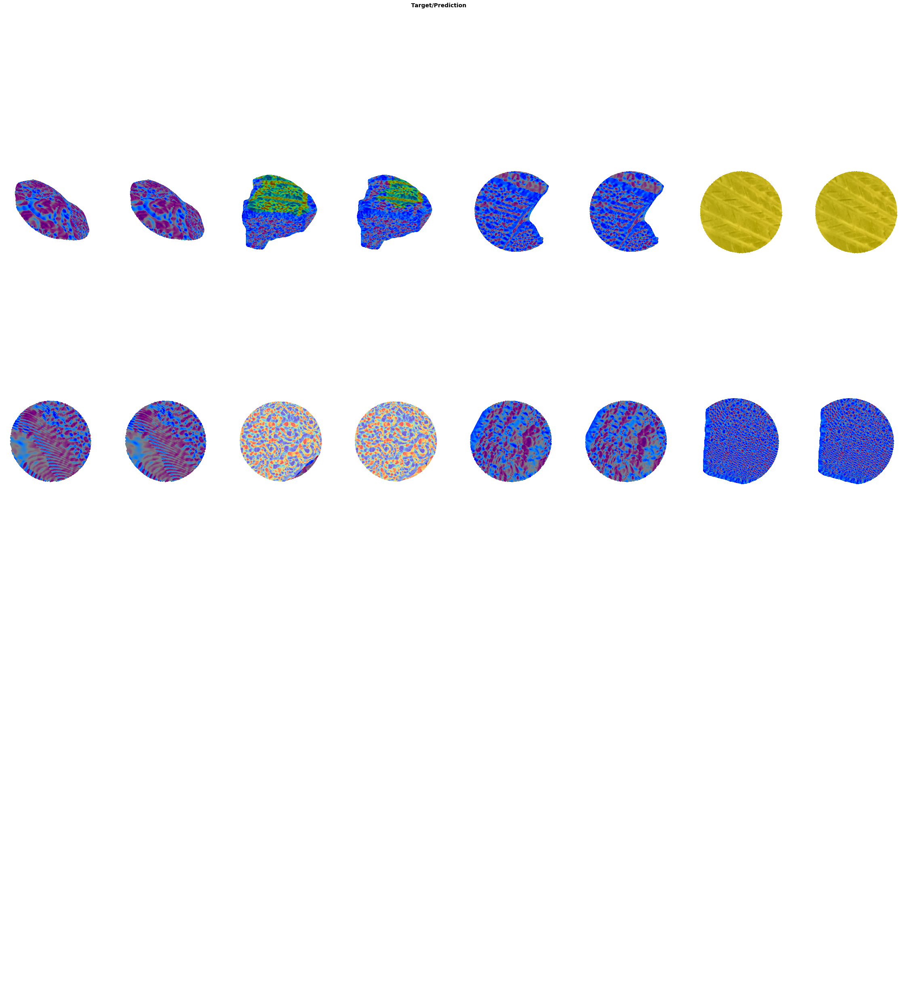

In [138]:
show_results(env, learn)